# OpenClassrooms - Parcours DataScientist

# Projet 6 - Classifiez automatiquement des biens de consommation

  Bienvenue dans le notebook du projet 6 du parcours Data Scientist OpenClassrooms : 'classifiez automatiquement des biens de consommation'.

  Dans ce notebook, nous allons nous intéresser à un jeu de données dans lequel chaque individu correspond à un produit vendu sur le site 'Place de marché'.

  Nous aurons à notre disposition des images et des descriptions textuelles de chaque produit, desquelles nous allons effectuer une extraction de features, de manière à mettre en avant la faisabilité d'un moteur de classification automatique des articles.

# 1- Importation du jeu de données

  Afin de mettre en oeuvre les opérations dans les meilleures conditions, et par soucis de disponibilité des ressources pour certains traitements, nous utiliserons google colab pour l'éxecution totale de ce notebook. Ainsi, nous importerons les données directement depuis le drive google.

In [185]:
#Accés aux fichiers depuis google drive

from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [186]:
#Installation de certaines librairies sous la dernière version disponible pour éviter certains bugs des précédentes versions

!pip install swifter
!pip install diagrams
!pip install --upgrade gensim
!pip install  --upgrade tensorflow
!pip install  tensorflow-text
!pip install tenorflow_hub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement tenorflow_hub (from versions: none)
ERROR: No matching distribution found for tenorflow_hub


In [187]:
#Importation des librairies de visualisation des données
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import diagrams

#Importation des librairies de manipulation des données
import numpy as np
import pandas as pd
import swifter

#Gestion de l'affichage des messages d'avertissement
import warnings
warnings.filterwarnings("ignore")
import os

In [188]:
#Importation du jeu de données

path = 'gdrive/MyDrive/P6/'
data = pd.read_csv(path + 'flipkart_com-ecommerce_sample_1050.csv')
print('Le jeu de données a la forme : {}'.format(data.shape))

Le jeu de données a la forme : (1050, 15)


In [189]:
#Affichage des 5 premières lignes

data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [190]:
#Affichage de 5 lignes au hasard

data.sample(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
45,493d1eb6ad7a48a926092bf994cd0bb0,2016-03-20 14:44:44 +0000,http://www.flipkart.com/akup-i-love-my-mom-cer...,AKUP i-love-my-mom Ceramic Mug,"[""Kitchen & Dining >> Coffee Mugs >> AKUP Coff...",MUGEGZUHX744RFEN,500.0,259.0,493d1eb6ad7a48a926092bf994cd0bb0.jpg,False,Key Features of AKUP i-love-my-mom Ceramic Mug...,No rating available,No rating available,AKUP,"{""product_specification""=>[{""key""=>""Type"", ""va..."
336,6634de7b39a5b0658c74ab098450096d,2015-12-01 06:13:00 +0000,http://www.flipkart.com/d-link-dir-816-wireles...,D-Link DIR-816 Wireless AC750 Dual Band Router,"[""Computers >> Network Components >> Routers >...",RTRE3XW7JS6YJHG5,4200.0,2059.0,6634de7b39a5b0658c74ab098450096d.jpg,True,Buy D-Link DIR-816 Wireless AC750 Dual Band Ro...,4,4,D-Link,"{""product_specification""=>[{""key""=>""Other Secu..."
342,17a73d7c4b02ada2bfeed1115fed08a4,2015-12-01 06:13:00 +0000,http://www.flipkart.com/envy-1000-force-combo-...,Envy-1000 Force Combo Set,"[""Beauty and Personal Care >> Fragrances >> De...",CAGE79CEHJZX52XS,360.0,329.0,17a73d7c4b02ada2bfeed1115fed08a4.jpg,False,Flipkart.com: Buy Envy-1000 Force Combo Set on...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Number of ..."
171,cab75cad4b3a3c593c753a1759df28e2,2015-12-01 12:40:44 +0000,http://www.flipkart.com/prithish-we-re-all-mad...,Prithish We're All Mad Here Ceramic Mug,"[""Kitchen & Dining >> Coffee Mugs >> Prithish ...",MUGE8F5RDEYMH4YH,499.0,175.0,cab75cad4b3a3c593c753a1759df28e2.jpg,False,Buy Prithish We're All Mad Here Ceramic Mug fo...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va..."
493,dfecd0265b899cb36fbb1fddc6f861a4,2016-01-07 05:50:25 +0000,http://www.flipkart.com/lapguard-acer-aspire-4...,Lapguard Acer Aspire 4741G-5464G50Mn Replaceme...,"[""Computers >> Laptop Accessories >> Batteries...",ACCDX8ZTH89YR2ZF,3999.0,1699.0,dfecd0265b899cb36fbb1fddc6f861a4.jpg,False,Buy Lapguard Acer Aspire 4741G-5464G50Mn Repla...,No rating available,No rating available,Lapguard,"{""product_specification""=>[{""key""=>""In The Box..."


In [191]:
#Description du jeu de données

data.describe()

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


In [192]:
#Valeurs dupliquées sur la variable uniq_id

data['uniq_id'].duplicated().sum()

0

Notre jeu de données est composé de 1050 individus décrits de manière uniques par la variable 'uniq_id'.

Au total, nous avons 15 variables, majoritairement qualitatives, à l'éxception des colonnes 'retail_price', et 'discounted_price', toutes deux quantitatives. 

A priori, les colonnes intéressantes pour notre études sont :
- product_category_tree (arbre des catégories auxquelles appartient un produit)
- image : Image au format jpg représentant le produit
- descrition : description textuelle du produit 

Dans un premier temps, nous pouvons effectuer une courte analyse exploratoire du jeu de données afin de mettre en avant certains résultats intéressants.

# 2- Nettoyage du jeu de données

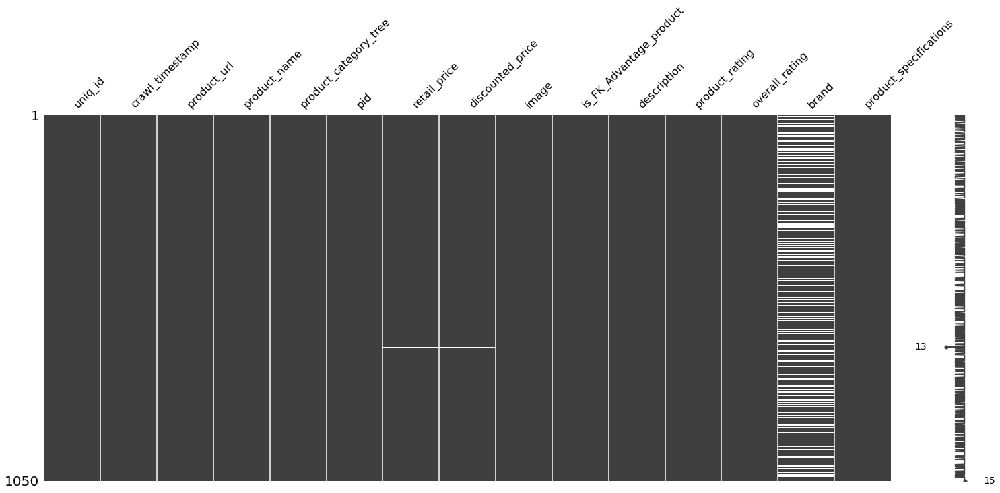

In [193]:
#Matrice des valeurs manquantes

msno.matrix(data.sample(len(data)))

In [194]:
#Affichage de la proportion de valeurs manquantes par variable

data.isna().mean().sort_values()

uniq_id                    0.000000
crawl_timestamp            0.000000
product_url                0.000000
product_name               0.000000
product_category_tree      0.000000
pid                        0.000000
image                      0.000000
is_FK_Advantage_product    0.000000
description                0.000000
product_rating             0.000000
overall_rating             0.000000
retail_price               0.000952
discounted_price           0.000952
product_specifications     0.000952
brand                      0.321905
dtype: float64

Dans 32% des cas, la marque n'est pas disponible (ce n'est pas grave dans l'absolu, nous n'aurons pas besoin de cette variable dans notre étude). 

Notons qu'un individu n'a pas de prix ni de spécification, ce qui encore une fois n'est pas problématique dans notre cas.

Nous pouvons néanmoins nous projeter sur cette unique observation.


In [195]:
#Projection sur les valeurs manquantes de retail_price et discounted_price

data.loc[data['retail_price'].isna()]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [196]:
#Projection sur la valeur manquante de product_specifications

data.loc[data['product_specifications'].isna()]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
957,e488005c7fb68747d3458c7d73760bae,2016-02-24 04:24:17 +0000,http://www.flipkart.com/nutcase-multicolor-col...,Nutcase Multicolor Column Floor Lamp,"[""Home Decor & Festive Needs >> Decorative Lig...",FIOEFUXPJQYZKDXZ,3299.0,1299.0,e488005c7fb68747d3458c7d73760bae.jpg,False,Key Features of Nutcase Multicolor Column Floo...,No rating available,No rating available,Nutcase,NaN


In [197]:
#Affichage de la valeur maximale de crawl_timestamp

data['crawl_timestamp'].max()

'2016-06-26 14:21:24 +0000'

Ces 3 individus ont des dates d'entrée relativement récentes par rapport à la dernière date disponible du jeu de données, nous pouvons supposer que ces informations ne sont pas encore disponibles.

Nous tolérons ces valeurs manquantes. Comme nous le verrons plus tard, nous avons une parfaite représentativité des individus vis-à-vis de la variable 'product_category_tree', en ne tenant compte que de la catégorie parent.

In [198]:
#Affichage des types de colonnes

data.dtypes

uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

# 3- Analyse univariée

## 3.1- Variables quantitatives

Dans cette partie, nous allons nous intéresser à l'analyse univariée des variables quantitatives (discounted and retail prices).

Nous allons également nous intéresser aux dates du jeu de données, de manière à avoir une visualisation des dates d'ajout des produits au catalogue.

Cette partie inclut également la recherche de valeurs aberrantes pour les variables quantitatives.



Text(100000, 500, 'Skewness : 19')

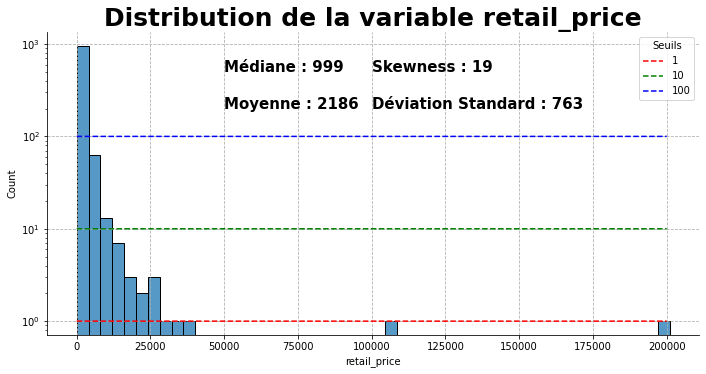

In [199]:
#Distribution de la variable retail_price

sns.displot(data = data, x = 'retail_price', kind = 'hist', bins = 50, aspect = 2, height = 5)
plt.title('Distribution de la variable retail_price', size = 25, weight = 'bold')
plt.yscale('log')
plt.grid(True, ls = '--')
plt.plot(range(200000), np.full((200000,1), 1), color = 'red', label = '1', ls = '--')
plt.plot(range(200000), np.full((200000,1), 10), color = 'green', label = '10', ls = '--')
plt.plot(range(200000), np.full((200000,1), 100), color = 'blue', label = '100', ls = '--')
plt.legend(title = 'Seuils')
plt.text(50000, 200, 'Moyenne : {}'.format(str(np.mean(data['retail_price'].dropna().values))[:4]),
        size = 15, weight = 'bold')
plt.text(50000, 500, 'Médiane : {}'.format(str(np.median(data['retail_price'].dropna().values))[:3]),
        size = 15, weight = 'bold')
plt.text(100000, 200, 'Déviation Standard : {}'.format(str(np.std(data['retail_price'].dropna().values))[:3]),
        size = 15, weight = 'bold')
plt.text(100000, 500, 'Skewness : {}'.format(str((data['retail_price'].dropna().skew()))[:2]),
        size = 15, weight = 'bold')

Nous avons des valeurs particulièrement élevées pour certains individus.

Ainsi, nous allons nous projeter sur les individus ayant un prix particulièrement élevé pour la variable 'retail_price' pour vérifier la vraisemblance de ces valeurs.

In [200]:
data.loc[data['retail_price'] > 25000]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
9,710ed5f2393a4b9e8823aa0029f71f93,2015-12-04 07:25:36 +0000,http://www.flipkart.com/tag-heuer-cau1116-ba08...,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,"[""Watches >> Wrist Watches >> TAG Heuer Wrist ...",WATEA6UGFGKZKDJC,107750.0,107750.0,710ed5f2393a4b9e8823aa0029f71f93.jpg,False,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
11,08452abdadb3db1e686b94a9c52fc7b6,2015-12-04 07:25:36 +0000,http://www.flipkart.com/cartier-w6701005-analo...,"Cartier W6701005 Analog Watch - For Boys, Men","[""Watches >> Wrist Watches >> Cartier Wrist Wa...",WATEAK8SE2RUK7GM,201000.0,201000.0,08452abdadb3db1e686b94a9c52fc7b6.jpg,False,"Cartier W6701005 Analog Watch - For Boys, Men...",No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp..."
318,fd2716d0e5dd7ffc367ca4dd9f97aaa0,2015-12-01 06:13:00 +0000,http://www.flipkart.com/asus-wireless-ac2400-d...,Asus Wireless AC2400 Dual-band Gigabit Router,"[""Computers >> Network Components >> Routers >...",RTREYTY2TMVNXZG4,29990.0,21290.0,fd2716d0e5dd7ffc367ca4dd9f97aaa0.jpg,False,Buy Asus Wireless AC2400 Dual-band Gigabit Rou...,4.3,4.3,Asus,"{""product_specification""=>[{""key""=>""Firewall"",..."
437,b6c339777814451815fe7950fd4c8536,2016-06-16 08:51:06 +0000,http://www.flipkart.com/homeedge-solid-wood-ki...,HomeEdge Solid Wood King Bed,"[""Beauty and Personal Care >> Health Care >> H...",BDDEH93ZEEZY7CHM,25499.0,18799.0,b6c339777814451815fe7950fd4c8536.jpg,False,Key Features of HomeEdge Solid Wood King Bed K...,No rating available,No rating available,HomeEdge,"{""product_specification""=>[{""key""=>""Installati..."
604,85aec4bf3185da7ebcc45003429cbfe2,2016-01-07 04:32:43 +0000,http://www.flipkart.com/hp-15-ac116tx-notebook...,HP 15-ac116TX (Notebook) (Core i3 (5th Gen)/ 4...,"[""Computers >> Laptops >> HP Laptops""]",COMEAZ945RHFFGUS,38890.0,38890.0,85aec4bf3185da7ebcc45003429cbfe2.jpg,True,Buy HP 15-ac116TX (Notebook) (Core i3 (5th Gen...,5,5,HP,"{""product_specification""=>[{""key""=>""Included S..."
605,bcb8e456728013a90ba66ab3b1b783ad,2016-01-07 04:32:43 +0000,http://www.flipkart.com/hp-15-ac121tu-notebook...,HP 15-ac121tu (Notebook) (Core i3 (5th Gen)/ 4...,"[""Computers >> Laptops >> HP Laptops""]",COMEAZ94HWYQTZHZ,35390.0,35390.0,bcb8e456728013a90ba66ab3b1b783ad.jpg,True,Buy HP 15-ac121tu (Notebook) (Core i3 (5th Gen...,4.5,4.5,HP,"{""product_specification""=>[{""key""=>""Included S..."


Les produits avec un retail_price élevé correspondent à des produit de luxe (montres) et des produits high-tech.

Par la suite, nous allons nous intéresser à la distribution de la variable discounted_price, et mettre en avant une nouvelle variable, retail_discount_ratio, en divisant le prix discount par le retail price.

De cette manière, nous pouvons mettre en lumière d'éventuelles valeurs aberrantes sur ne variable en nous servant de l'autre (anticipation de l'analyse bi-variée).

Text(100000, 500, 'Skewness : 21')

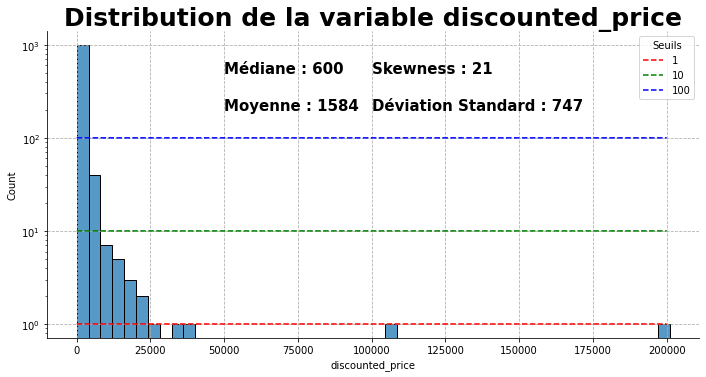

In [201]:
#Distribution de la variable discounted_price

sns.displot(data = data, x = 'discounted_price', kind = 'hist', bins = 50, aspect = 2, height = 5)
plt.title('Distribution de la variable discounted_price', size = 25, weight = 'bold')
plt.yscale('log')
plt.grid(True, ls = '--')
plt.plot(range(200000), np.full((200000,1), 1), color = 'red', label = '1', ls = '--')
plt.plot(range(200000), np.full((200000,1), 10), color = 'green', label = '10', ls = '--')
plt.plot(range(200000), np.full((200000,1), 100), color = 'blue', label = '100', ls = '--')
plt.legend(title = 'Seuils')
plt.text(50000, 200, 'Moyenne : {}'.format(str(np.mean(data['discounted_price'].dropna().values))[:4]),
        size = 15, weight = 'bold')
plt.text(50000, 500, 'Médiane : {}'.format(str(np.median(data['discounted_price'].dropna().values))[:3]),
        size = 15, weight = 'bold')
plt.text(100000, 200, 'Déviation Standard : {}'.format(str(np.std(data['discounted_price'].dropna().values))[:3]),
        size = 15, weight = 'bold')
plt.text(100000, 500, 'Skewness : {}'.format(str((data['discounted_price'].dropna().skew()))[:2]),
        size = 15, weight = 'bold')

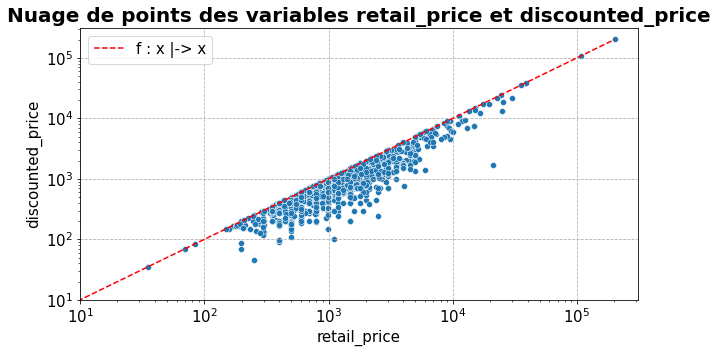

In [202]:
#Nuage de point des variables retail_price et discounted_price

plt.rcParams.update({'font.size' : 15})
plt.figure(figsize = (10,5))
plt.title('Nuage de points des variables retail_price et discounted_price', weight = 'bold', size = 20)
sns.scatterplot(data = data, x = 'retail_price', y = 'discounted_price')
plt.xscale('log')
plt.yscale('log')
plt.xlim(left = 10)
plt.ylim(bottom = 10)
plt.grid(True, ls = '--')
plt.plot(range(200000), range(200000), color = 'red', ls = '--', label = 'f : x |-> x')
plt.legend()

In [203]:
#Création de la variable discounted_retail_ration

data['discounted_retail_ratio'] = data['discounted_price'] / data['retail_price']

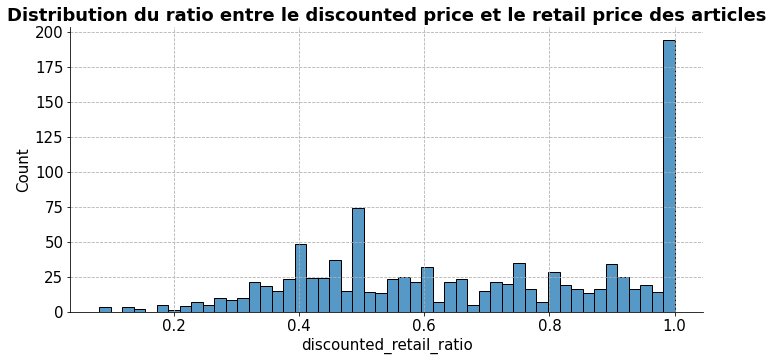

In [204]:
#Distribution de la nouvelle variable

sns.displot(data = data, x = 'discounted_retail_ratio', kind = 'hist', bins = 50, aspect = 2, height = 5)
plt.title('Distribution du ratio entre le discounted price et le retail price des articles', size = 18, weight = 'bold')
plt.grid(True, ls = '--')

On constate que le retail price est systématiquement supérieur ou égal au discounted price, nous n'avons donc pas de valeurs aberrantes à ce niveau.

Nous pouvons nous intéresser aux ratios particulièrement faibles.

In [205]:
data.loc[data['discounted_retail_ratio'] < 0.15]

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,discounted_retail_ratio
220,32cf0691248297655e2c1728b12e2262,2015-12-01 12:40:44 +0000,http://www.flipkart.com/poppins-printed-baby-b...,Poppins Printed Baby Boy's Jumpsuit,"[""Baby Care >> Infant Wear >> Baby Boys' Cloth...",JUMECNJURHHGKSXR,1099.0,100.0,32cf0691248297655e2c1728b12e2262.jpg,False,Poppins Printed Baby Boy's Jumpsuit\r\n ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""value""=>""Jumsuits...",0.090992
277,113783ce1db999778b5a4bd374e61209,2016-04-24 18:34:50 +0000,http://www.flipkart.com/palito-plo-169-analog-...,"palito PLO 169 Analog Watch - For Girls, Women","[""Watches >> Wrist Watches >> palito Wrist Wat...",WATEHZZSSCU4YXYG,1500.0,199.0,113783ce1db999778b5a4bd374e61209.jpg,False,Key Features of palito PLO 169 Analog Watch -...,No rating available,No rating available,palito,"{""product_specification""=>[{""key""=>""Type"", ""va...",0.132667
280,009099b1f6e1e8f893ec29a7023153c4,2016-04-24 18:34:50 +0000,http://www.flipkart.com/palito-plo-166-analog-...,"palito PLO 166 Analog Watch - For Girls, Women","[""Watches >> Wrist Watches >> palito Wrist Wat...",WATEHZPFAPQKUASQ,1500.0,199.0,009099b1f6e1e8f893ec29a7023153c4.jpg,False,Specifications of palito PLO 166 Analog Watch ...,No rating available,No rating available,palito,"{""product_specification""=>[{""key""=>""Type"", ""va...",0.132667
285,64a9d0488652194fd8e879d5e6dc8015,2016-04-24 18:34:50 +0000,http://www.flipkart.com/palito-plo-149-analog-...,"palito PLO 149 Analog Watch - For Girls, Women","[""Watches >> Wrist Watches >> palito Wrist Wat...",WATEHZP3ZA9YT99G,1500.0,199.0,64a9d0488652194fd8e879d5e6dc8015.jpg,False,Specifications of palito PLO 149 Analog Watch ...,No rating available,No rating available,palito,"{""product_specification""=>[{""key""=>""Type"", ""va...",0.132667
606,afc829d45be38102afaa20f4bce2f627,2016-03-12 14:25:06 +0000,http://www.flipkart.com/soulful-threads-red-th...,Soulful Threads Red Thread Aari Embroidered Bl...,"[""Beauty and Personal Care >> Makeup >> Vanity...",VANEGPA7ZKGT2UUH,21125.0,1700.0,afc829d45be38102afaa20f4bce2f627.jpg,False,Key Features of Soulful Threads Red Thread Aar...,No rating available,No rating available,Soulful Threads,"{""product_specification""=>[{""key""=>""Weight"", ""...",0.080473
757,44a6d9f64668b004c3254f3904142064,2015-12-12 11:46:53 +0000,http://www.flipkart.com/svm-navratri-special-7...,SVM Navratri Special 7 Analog Watch - For Gir...,"[""Watches >> Wrist Watches >> SVM Wrist Watches""]",WATEB3ZEPX4XYBHG,2499.0,244.0,44a6d9f64668b004c3254f3904142064.jpg,False,SVM Navratri Special 7 Analog Watch - For Gir...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Chronograp...",0.097639


Sans informations supplémentaires, nous ne pouvons pas mettre en place de corrections sachant qu'il n'est pas impossible d'avoir de très fortes promotions sur certains produits. Nous conservons le jeu de données en l'état pour le moment. 
    
Nous nous intéressons enfin à la distribution de la variable 'crawl_timestamp'.

In [206]:
#Création de la variable date_str en récupérant les dates en supprimant les heures

data['date_str'] = np.nan
data['date_str'] = data['crawl_timestamp'].swifter.apply(lambda x : str(x)[:10])
data['date_str'].sample(5)

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

768    2015-12-12
498    2016-01-07
195    2015-12-01
758    2015-12-12
782    2015-12-12
Name: date_str, dtype: object

Text(0, 0.5, 'Décompte')

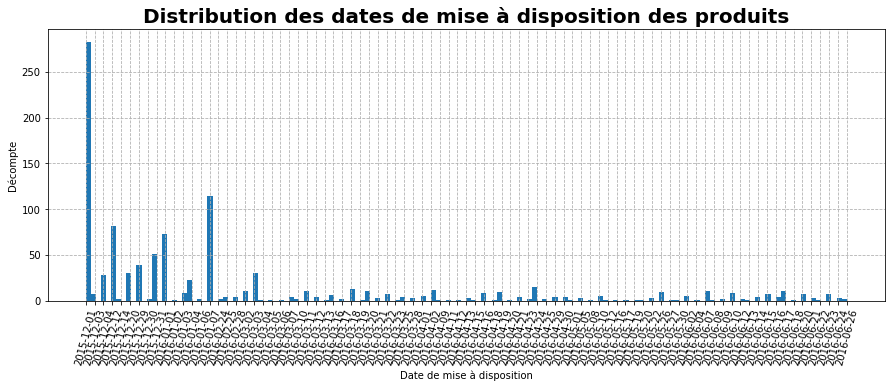

In [207]:
#Distribution de la variable 'crawl_timestamp'

plt.rcParams.update({'font.size' : 10})
plt.figure(figsize = (15,5))
plt.title('Distribution des dates de mise à disposition des produits', size = 20, weight = 'bold')
h = plt.hist(data['date_str'].sort_values(), bins = 150)
s = plt.xticks(rotation = 75)
plt.grid(True, ls = '--')
plt.xlabel('Date de mise à disposition')
plt.ylabel('Décompte')

Notons que la plupart des produits sont mis en place à la première date du jeu de données.

Les produits suivants ont probablement été ajoutés au fur et à mesure de leur disponibilité au catalogue de l'entreprise.

Passons à présent à l'analyse univariée des variables qualitatives.

## 3.2- Variables qualitatives

In [208]:
#Rappel des premières lignes du jeu de données

data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,discounted_retail_ratio,date_str
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",0.473407,2016-04-30
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",0.748333,2016-04-30
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",NaN,2016-04-30
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",0.481289,2016-06-20
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",0.268565,2016-06-20


Pour cette analyse rapide des variables qualitatives, nous allons commancer par nous intéresser aux distributions des variables suivantes :

*   is_FK_Advantage_product
*   product_rating
*   overall_rating
*   brand
    
Par la suite, nous pourrons passer à la variable la plus intéressante dans notre cas, product_category_tree.

In [209]:
#Répartition des valeurs prises par la variable is_FK_Advantage_product

data['is_FK_Advantage_product'].value_counts()

False    993
True      57
Name: is_FK_Advantage_product, dtype: int64

Text(0.5, 1.0, 'Répartition de la variable\n is_FK_Advantage_product')

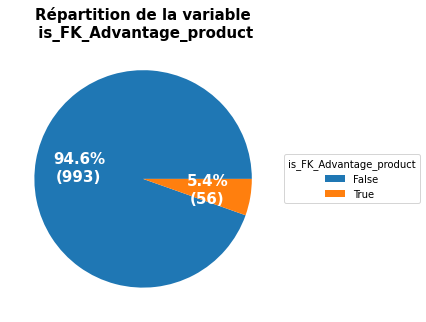

In [210]:
#Affichage du pieplot

fig, ax = plt.subplots(figsize=(5, 5), subplot_kw=dict(aspect="equal"))

def func(pct, allvals):
    absolute = int(pct/100.*np.sum(allvals))
    return "{:.1f}%\n({:d})".format(pct, absolute)

wedges, texts, autotexts = ax.pie(data['is_FK_Advantage_product'].value_counts(), 
                                  autopct=lambda pct: func(pct, data['is_FK_Advantage_product'].value_counts()),
                                  textprops=dict(color="w", weight = 'bold', size = 15))

ax.legend(wedges, data['is_FK_Advantage_product'].value_counts().index,
          title="is_FK_Advantage_product",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))

plt.title('Répartition de la variable\n is_FK_Advantage_product', size = 15, weight = 'bold')

In [211]:
#Affichage de 5 produit FK_Advantage

data.loc[data['is_FK_Advantage_product'] == True].sample(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,discounted_retail_ratio,date_str
341,fce2bd96b35d531a4784bc57e19aca4f,2015-12-01 06:13:00 +0000,http://www.flipkart.com/belkin-share-modem-n-r...,Belkin Share Modem (N) Router,"[""Computers >> Network Components >> Routers >...",RTRDFFYGM2TEWVCC,6249.0,6249.0,fce2bd96b35d531a4784bc57e19aca4f.jpg,True,Buy Belkin Share Modem (N) Router only for Rs....,3.7,3.7,Belkin,"{""product_specification""=>[{""key""=>""Firewall"",...",1.00000,2015-12-01
546,797bb7813ec0bbc99e8b6f1b32c32e52,2016-01-07 05:50:25 +0000,http://www.flipkart.com/maxima-19431cmgy-gold-...,Maxima 19431CMGY Gold Analog Watch - For Men,"[""Watches >> Wrist Watches >> Maxima Wrist Wat...",WATE4S5RZZY6ZCSA,795.0,795.0,797bb7813ec0bbc99e8b6f1b32c32e52.jpg,True,Maxima 19431CMGY Gold Analog Watch - For Men ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Diameter"",...",1.00000,2016-01-07
114,bc784846bd59a16832454416ac708003,2016-01-03 09:39:44 +0000,http://www.flipkart.com/lollipop-lane-tiddly-w...,Lollipop Lane Tiddly Wink Safari Bath Set,"[""Baby Care >> Baby Grooming >> Baby Grooming ...",BBCDPFZM6V585ZZE,2950.0,2950.0,bc784846bd59a16832454416ac708003.jpg,True,Flipkart.com is offering Lollipop Lane Tiddly ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Age Group""...",1.00000,2016-01-03
571,d0e09eaa7fcc9e7de3349959800d2141,2016-01-07 05:50:25 +0000,http://www.flipkart.com/hmt-olss-01-analog-wat...,HMT OLSS 01 Analog Watch - For Women,"[""Watches >> Wrist Watches >> HMT Wrist Watches""]",WATDVGGHWZBHXYBS,550.0,550.0,d0e09eaa7fcc9e7de3349959800d2141.jpg,True,HMT OLSS 01 Analog Watch - For Women - Buy HM...,4,4,NaN,"{""product_specification""=>[{""key""=>""Mechanism""...",1.00000,2016-01-07
310,64b463dc0b75ae40a848498c657041e6,2015-12-01 06:13:00 +0000,http://www.flipkart.com/linksys-smart-wi-fi-ro...,Linksys Smart Wi-Fi Router,"[""Computers >> Network Components >> Routers >...",RTRDZTF9DBT4CW8U,14999.0,13500.0,64b463dc0b75ae40a848498c657041e6.jpg,True,Buy Linksys Smart Wi-Fi Router only for Rs. 0....,No rating available,No rating available,Linksys,"{""product_specification""=>[{""key""=>""Encryption...",0.90006,2015-12-01


In [212]:
#Répartition des valeurs prises par la variable product_rating

data['product_rating'].value_counts()

No rating available    889
5                       43
4                       21
3                       12
1                       10
4.5                     10
4.3                      9
3.7                      8
3.5                      8
2                        6
4.1                      4
4.2                      4
3.8                      3
4.4                      3
4.7                      3
2.3                      3
3.6                      3
4.8                      2
2.5                      1
3.2                      1
2.2                      1
4.9                      1
3.3                      1
3.9                      1
3.1                      1
2.7                      1
1.5                      1
Name: product_rating, dtype: int64

In [213]:
#Répartition des valeurs prises par la variable overall_rating

data['overall_rating'].value_counts()

No rating available    889
5                       43
4                       21
3                       12
1                       10
4.5                     10
4.3                      9
3.7                      8
3.5                      8
2                        6
4.1                      4
4.2                      4
3.8                      3
4.4                      3
4.7                      3
2.3                      3
3.6                      3
4.8                      2
2.5                      1
3.2                      1
2.2                      1
4.9                      1
3.3                      1
3.9                      1
3.1                      1
2.7                      1
1.5                      1
Name: overall_rating, dtype: int64

Dans la plupart des cas, les notes ne sont pas disponibles pour les produits, ce qui rend ces deux variables inexploitables. 

Elles ne sont pas utiles pour notre étude, nous pouvons les supprimer.

In [214]:
#Répartition des valeurs prises par la variable overall_rating

data['brand'].value_counts()

PRINT SHAPES          11
Lapguard              11
Lal Haveli            10
Raymond                8
Aroma Comfort          8
                      ..
Rute                   1
NAMS                   1
JewelKraft Designs     1
Budding Bees           1
Zero                   1
Name: brand, Length: 490, dtype: int64

Nous avons plus de 490 marques uniques disponibles pour 1050 individus dans le jeu de données.

Cette variable n'est pas utile pour notre étude.

Pour la suite, nous allons nous concentrer sur une variable critique de notre étude : product_category_tree.

In [215]:
#Affichage de 5 valeurs prises au hasard

data['product_category_tree'].sample(5)

633    ["Baby Care >> Infant Wear >> Baby Girls' Clot...
473    ["Beauty and Personal Care >> Bath and Spa >> ...
273    ["Kitchen & Dining >> Cookware >> Pots & Pans ...
952    ["Home Furnishing >> Bed Linen >> Blankets, Qu...
399    ["Computers >> Network Components >> Routers >...
Name: product_category_tree, dtype: object

In [216]:
#Fonction d'affichage d'observations aléatoires

def random_categ_display(num):
    while num > 0:
        n = np.random.randint(len(data))
        tmp = data.loc[data.index == n]
        name = tmp['product_name'].values[0]
        categ = tmp['product_category_tree'].values[0]
        print('Produit : {}'.format(name))
        print('Arbres des catégories : {}'.format(categ))
        print('\n')
        num = num - 1

In [217]:
#Affichage de quelques valeurs

random_categ_display(5)

Produit : KLIQVIK SIX PORT USB HUB FOR I PHONE 4 MOBILES TR-256 USB USB Hub
Arbres des catégories : ["Computers >> Laptop Accessories >> USB Gadgets >> KLIQVIK USB Gadgets"]


Produit : MKB Baby Girl's Empire Waist Dress
Arbres des catégories : ["Baby Care >> Infant Wear >> Baby Girls' Clothes >> Dresses & Skirts >> Dresses >> MKB Dresses >> MKB Baby Girl's Empire Waist Dress"]


Produit : Ruchikainternational ruc0013 Showpiece  -  13 cm
Arbres des catégories : ["Home Decor & Festive Needs >> Showpieces >> Ethnic >> Ruchikainternational Ethnic"]


Produit : Allin Exporters Fennel Oil (Co2 Extract)
Arbres des catégories : ["Beauty and Personal Care >> Bath and Spa >> Body and Essential Oils >> Allin Exporters Body and Essential Oils >> Allin Exporters Fennel Oil (Co2 Extract) (30 ml)"]


Produit : Mxofere Combo Papaya Mixfruit Almond Honey Orange Rose Soap Kit
Arbres des catégories : ["Beauty and Personal Care >> Combos and Kits >> Mxofere Combos and Kits"]




  On se rend compte que les produits appartiennent à des catégories, au sein desquelles ils sont regroupés en sous-catégories, de manière à former une arborescence. 
    
  Ces arbres sont plus ou moins profonds en fonction du produit, et notre première difficulté sera de définir à quelle catégorie (à quel niveau dans l'arbre) attribuer les produits.
    
  Pour cela, nous travaillerons avec un data frame projeté sur la variable 'product_category_tree', au sein duquel nous allons définir de nouvelles variables correspondant aux sous-catégories.
    
  Dans un premier temps, nous décomposons chaque chaîne de caractères de la variable 'product_category_tree' en utilisant la méthode split sur la chaîne de caractères '>>', de manière à récupérer une liste dont la longueur sera le nombre de sous-catégories d'un individu.

In [218]:
#Définition du dataframe de travail

categ_df = pd.DataFrame(data['product_category_tree'])
categ_df.sample(2)

,product_category_tree
111,"[""Home Decor & Festive Needs >> Decorative Lig..."
9,"[""Watches >> Wrist Watches >> TAG Heuer Wrist ..."


In [219]:
#Création de la variable 'categ_list'

categ_df['categ_list'] = categ_df['product_category_tree'].swifter.apply(lambda x : x.split('>>'))
categ_df.sample(3)

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

,product_category_tree,categ_list
132,"[""Kitchen & Dining >> Coffee Mugs >> Prithish ...","[[""Kitchen & Dining , Coffee Mugs , Prithish..."
648,"[""Baby Care >> Infant Wear >> Baby Boys' Cloth...","[[""Baby Care , Infant Wear , Baby Boys' Clot..."
925,"[""Home Decor & Festive Needs >> Decorative Lig...","[[""Home Decor & Festive Needs , Decorative Li..."


In [220]:
#Création de la variable 'nb_categs' indiquant le nombre de sous-catégories

categ_df['nb_categs'] = categ_df['categ_list'].swifter.apply(lambda x : len(x))
categ_df.sample(3)

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

,product_category_tree,categ_list,nb_categs
923,"[""Home Decor & Festive Needs >> Decorative Lig...","[[""Home Decor & Festive Needs , Decorative Li...",4
87,"[""Computers >> Software >> Language Learning >...","[[""Computers , Software , Language Learning ...",6
127,"[""Beauty and Personal Care >> Body and Skin Ca...","[[""Beauty and Personal Care , Body and Skin C...",5


Text(2.1, -0.05, 'Min : 2')

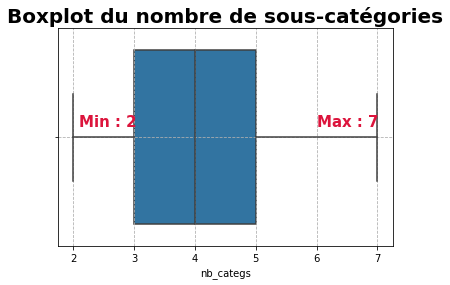

In [221]:
#Affichage du boxplot du nombre de sous-catégories

plt.title('Boxplot du nombre de sous-catégories', size = 20, weight = 'bold')
sns.boxplot(data = categ_df, x = 'nb_categs')
plt.grid(True, ls = '--')
plt.text(6, -0.05, 'Max : {}'.format(categ_df['nb_categs'].max()), size = 15, weight = 'bold', color = 'crimson')
plt.text(2.1, -0.05, 'Min : {}'.format(categ_df['nb_categs'].min()), size = 15, weight = 'bold', color = 'crimson')

Par la suite, nous allons créer 7 colonnes supplémentaires, de manière à stocker les sous-catégories en fonction de leur rang dans l'arbre. 

De cette manière, si on individu possède un arbre de sous-catégories contenant moins de 7 sous-catégories, les variables de rang supérieur au nombre de sous-catégories de l'arbre prendront la valeur np.nan.

In [222]:
#On stock le nombre maximal de sous-catégories dans une variable
maxlen = categ_df['nb_categs'].max()

#On crée 7 listes vides que l'on nomme dynamiquement de R1 à R7
for i in range(1, maxlen + 1):
    tmp = 'R' + str(i)
    locals()[tmp] = []

#On parcours les individus en splittant les arbres sur la chaine de caractère ">>" (addapté pour le premier et dernier individu)
#On ajoute la sous-catégorie correspondante à la i-ème liste Ri
#Si le rang est supérieur à la longueur de la liste, on ajoute np.nan
for i in categ_df.index:
    for j in range(1, maxlen + 1):
        sup = categ_df.loc[categ_df.index == i, 'nb_categs'].values[0]
        if j <= sup:
            tmp = categ_df.loc[categ_df.index == i, 'product_category_tree'].values[0].split(' >> ')[j-1]
            tmp = tmp.split('"]')[0]
            if j ==1:
                tmp = tmp.split('["')[1]
            locals()['R'+str(j)].append(tmp)
        else:
            locals()['R'+str(j)].append(np.nan)

#On intégre les listes au jeu de données
for i in range(1, maxlen + 1):
    categ_df['R'+str(i)] = locals()['R'+str(i)]

In [223]:
#Affichage de 3 individus au hasard

categ_df.sample(3)

,product_category_tree,categ_list,nb_categs,R1,R2,R3,R4,R5,R6,R7
766,"[""Kitchen & Dining >> Containers & Bottles >> ...","[[""Kitchen & Dining , Containers & Bottles , ...",5,Kitchen & Dining,Containers & Bottles,Bottles & Sippers,Water bottle,Nutcase Water bottle,NaN,NaN
446,"[""Computers >> Laptop Accessories >> Laptop Ad...","[[""Computers , Laptop Accessories , Laptop A...",5,Computers,Laptop Accessories,Laptop Adapters,Hako Laptop Adapters,Hako 85W Magsafe Laptop Charger For APPLE MacB...,NaN,NaN
339,"[""Computers >> Network Components >> Routers >...","[[""Computers , Network Components , Routers ...",4,Computers,Network Components,Routers,Edimax Routers,NaN,NaN,NaN


Nous pouvons nous intéresser à la répartition des valeurs prises par les différents rangs.

Dans un premier temps, nous nous concentrons sur le rang 1.

In [224]:
#Affichage de la répartition des valeurs de la variable R1

categ_df['R1'].value_counts()

Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: R1, dtype: int64

Text(0.5, 1.0, 'Répartition des valeurs prises\n par les catégories principales')

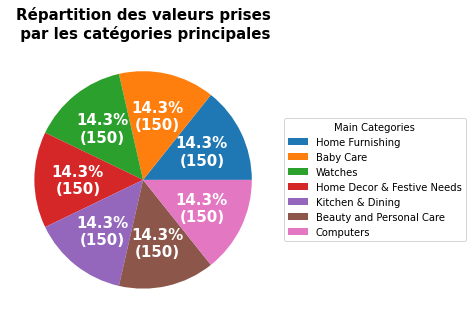

In [225]:
#Affichage du pieplot

fig, ax = plt.subplots(figsize=(5, 5), subplot_kw=dict(aspect="equal"))

def func(pct, allvals):
    absolute = int(pct/100.*np.sum(allvals))
    return "{:.1f}%\n({:d})".format(pct, absolute)

wedges, texts, autotexts = ax.pie(categ_df['R1'].value_counts(), 
                                  autopct=lambda pct: func(pct, categ_df['R1'].value_counts()),
                                  textprops=dict(color="w", weight = 'bold', size = 15))

ax.legend(wedges, categ_df['R1'].value_counts().index,
          title="Main Categories",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))

plt.title('Répartition des valeurs prises\n par les catégories principales', size = 15, weight = 'bold')

  Nous avons donc 7 catégories de produits principales, pour lesquels nous avons une parfaite représentativité au sein du jeu de données.
    
  Comme nous allons le voir par la suite, ce n'est pas le cas des sous-catégories, pour lesquels nous avons d'ailleurs de valeur manquante au delà du rang 2.

In [226]:
#Affichage de la répartition des valeurs de la variable R2

categ_df['R2'].value_counts()

Wrist Watches                      149
Laptop Accessories                  87
Infant Wear                         84
Coffee Mugs                         74
Showpieces                          71
                                  ... 
Consumables & Disposables            1
TRUE Home Decor & Festive Needs      1
JMD Home Furnishing                  1
Kripa's Home Furnishing              1
Beauty Accessories                   1
Name: R2, Length: 62, dtype: int64

Comme nous pouvons le voir, les catégories de rang 2 sont beaucoup moins bien représentées.

In [227]:
#Importation de librairies supplémentaires de visualisation

from diagrams import Diagram, Edge, Node
from diagrams.gcp.database import SQL
from diagrams.gcp.storage import GCS
from diagrams.onprem.database import MongoDB
from diagrams import Cluster

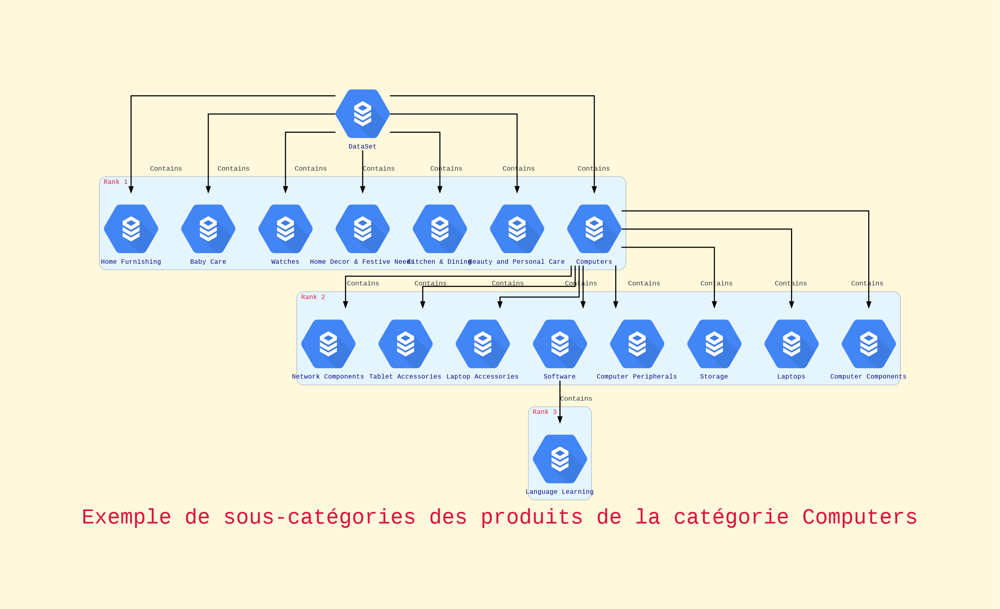

In [228]:
#Arborescance de sous-catégories - Exemple

graph_attr = {
    "fontsize": "40",
    "bgcolor": "cornsilk", 'lwidth' : '10', 'fontcolor' : 'crimson', 'fontweight' : 'bold'
}

node_attr = {
    "fontsize": "12",
    "fontcolor": "navy", 'fontweight' : 'bold',
}

with Diagram('Exemple de sous-catégories des produits de la catégorie Computers', graph_attr = graph_attr, node_attr = node_attr, direction = 'TB') as diag:
    
    data_set = SQL('DataSet', style = 'bold')
    
    with Cluster('Rank 1'):
        for i in categ_df['R1'].unique():
            locals()[i] = SQL(i, style = 'bold')
            data_set >> Edge(label = 'Contains', color = 'black', style = 'bold') >> locals()[i]
    
    with Cluster('Rank 2'):
        tmp = categ_df.loc[categ_df['R1'] == 'Computers', 'R2'].unique()
        for j in tmp:
            locals()[j] = SQL(j, style = 'bold')
            Computers >> Edge(label = 'Contains', color = 'black', style = 'bold') >> locals()[j]
    
    with Cluster('Rank 3'):
        tmp2 = categ_df.loc[categ_df['R2'] == 'Software', 'R3'].unique()
        for k in tmp2:
            Language = SQL(k, style = 'bold')
            Software >> Edge(label = 'Contains', color = 'black', style = 'bold') >> Language
    
    with Cluster('Rank 4'):
        tmp3 = categ_df.loc[categ_df['R3'] == 'Software', 'R4'].unique()
        for k in tmp3:
            Physical = SQL(k, style = 'bold')
            Language >> Edge(label = 'Contains', color = 'black', style = 'bold') >> Physical
    
diag

  Ainsi, nous conservons les 7 catégories de rang 1 pour décrire nos individus par type de produit. Nous pouvons ainsi intégrer la variable R1 à notre jeu de données initial, et passer à l'analyse exploratoire bivariée.

In [229]:
#Ajout de R1 au jeu de données data

data['categs'] = categ_df['R1']

# 4- Analyse bivariée

## 4.1- Variables quantitatives

Nous avons deux variables quantitatives dans notre jeu de données initiales (une troisième avec le ratio discounted price sur retail price).

Nous pouvons rapidement afficher leur matrice de corrélations.

In [230]:
#Matrice des corrélations

Corr = data[['retail_price', 'discounted_price']].corr()
Corr

,retail_price,discounted_price
retail_price,1.000000,0.990065
discounted_price,0.990065,1.000000


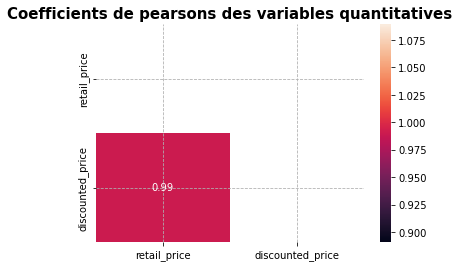

In [231]:
#Affichage de la heatmap

mask = np.triu(np.ones(Corr.shape))
sns.heatmap(data = Corr, annot = Corr, mask = mask)
plt.title('Coefficients de pearsons des variables quantitatives', size = 15, weight = 'bold')
plt.grid(True, ls = '--')

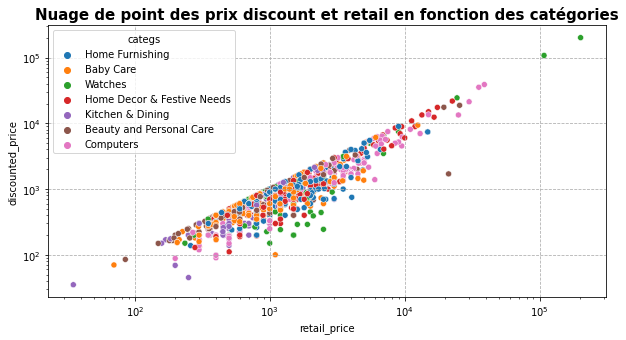

In [232]:
#Affichage du nuage de point en fonction des catégories

plt.figure(figsize = (10,5))
plt.title('Nuage de point des prix discount et retail en fonction des catégories', size = 15, weight = 'bold')
sns.scatterplot(data = data, x = 'retail_price', y = 'discounted_price', hue = 'categs')
plt.xscale('log')
plt.yscale('log')
plt.grid(True, ls = '--')

## 4.2- Variables quantitatives-qualitatives

Text(0.5, 1.0, 'Distribution de la variable retail_price en fonction des catégories')

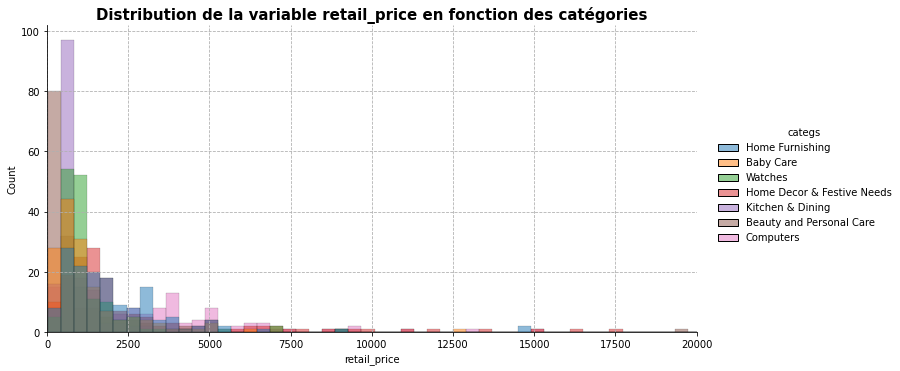

In [233]:
#Distribution du retail price en fonction des catégories

sns.displot(data = data, x = 'retail_price', hue = 'categs', aspect = 2, height = 5, bins = 500)
plt.xlim(left = 0, right = 20000)
plt.grid(True, ls = '--')
plt.title('Distribution de la variable retail_price en fonction des catégories', size = 15, weight = 'bold')

Text(0.5, 1.0, 'Distribution de la variable discounted_price en fonction des catégories')

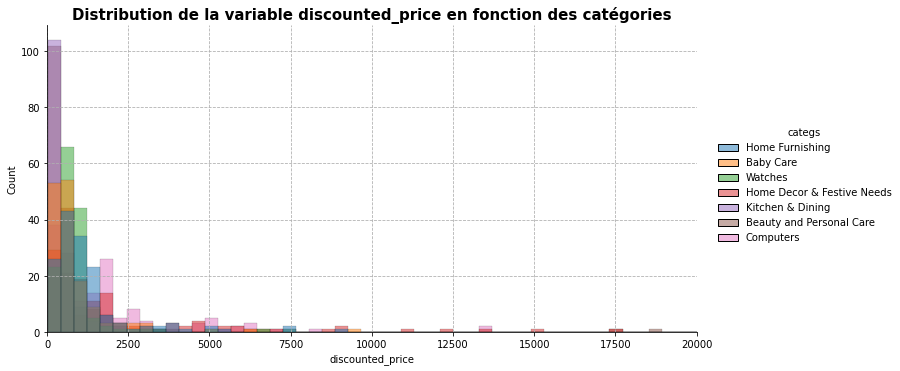

In [234]:
#Distribution du discounted price en fonction des catégories

sns.displot(data = data, x = 'discounted_price', hue = 'categs', aspect = 2, height = 5, bins = 500)
plt.xlim(left = 0, right = 20000)
plt.grid(True, ls = '--')
plt.title('Distribution de la variable discounted_price en fonction des catégories', size = 15, weight = 'bold')

# 5- Features Extraction des images

A ce stade, nous avons effectué une première analyse de notre jeu de données. 

Le but de notre étude étant d'évaluer la faisabilité d'un moteur de recherche des produits par catégories à partir de la description et de l'image du produit.

Dans un premier temps, nous nous intéressons aux descriptions des produits pour lesquels nous allons étudier plusieurs approches.
Nous avons un corpus de descriptions de 1050 individus sans valeur manquante. 

Dans un permier temps, nous pouvons observer quelques individus pris au hasard, et définir le corpus brut de toutes les descriptions.

In [235]:
#Définition de la fonction d'observation des individus

def display_desc(num):
    while num > 0:
        n = np.random.randint(len(data))
        tmp = data.loc[data.index == n]
        name = tmp['product_name'].values[0]
        categ = tmp['categs'].values[0]
        desc = tmp['description'].values[0]
        print('\033[1m' + 'Nom du produit' + '\033[0m' + ': {}'.format(name))
        print('\033[1m' + 'Catégorie' + '\033[0m' + ': {}'.format(categ))
        print('\033[1m' + 'Description' +  '\033[0m' + ': {}\n'.format(desc))
        num = num - 1

In [236]:
#Affichage de 5 descriptions au hasard

display_desc(5)

Nom du produit: Home Originals Abstract, Checkered Double Blanket Multicolor
Catégorie: Home Furnishing
Description: Buy Home Originals Abstract, Checkered Double Blanket Multicolor at Rs. 1299 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery!

Nom du produit: loomkart Blue Polyester Runner
Catégorie: Home Furnishing
Description: Specifications of loomkart Blue Polyester Runner (55 cm  X 147 cm) General Brand loomkart Shape Rectangle Type Runner Design Code 001 Material Polyester Pattern Abstract Style Code AVIRUG85001 Color Blue Dimensions Length 57 inch / 147 cm Width 21 inch / 55 cm In the Box Number of Contents in Sales Package Pack of 1

Nom du produit: Tapawire Portable USB Flexible Stick Dimmable Touch Switch 10 Super Bright LED Reading Lamp B00 USB Led Light
Catégorie: Computers
Description: Buy Tapawire Portable USB Flexible Stick Dimmable Touch Switch 10 Super Bright LED Reading Lamp B00 USB Led Light for Rs.449 online. Tapawire Portable USB Flexible St

In [237]:
#Définition du jeu de données de travail

final_df = data[['categs', 'description', 'image']]
final_df.head()

,categs,description,image
0,Home Furnishing,Key Features of Elegance Polyester Multicolor ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg
1,Baby Care,Specifications of Sathiyas Cotton Bath Towel (...,7b72c92c2f6c40268628ec5f14c6d590.jpg
2,Baby Care,Key Features of Eurospa Cotton Terry Face Towe...,64d5d4a258243731dc7bbb1eef49ad74.jpg
3,Home Furnishing,Key Features of SANTOSH ROYAL FASHION Cotton P...,d4684dcdc759dd9cdf41504698d737d8.jpg
4,Home Furnishing,Key Features of Jaipur Print Cotton Floral Kin...,6325b6870c54cd47be6ebfbffa620ec7.jpg


In [238]:
#Définition du corpus de texte et affichage des 500 premiers caractères

raw_corpus = " ".join(final_df['description'])
raw_corpus[:500]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a brig'

Nous pouvons entamer la partie nettoyage de texte, dans laquelle nous allons définir des fonctions de nettoyage de texte adaptées à notre problème.

En effet, nous notons que les descriptions contiennent des chaînes de caractères particuliers pour lesquelles nous avons des doutes sur la pertinence dans notre cas, comme des dimensions en cm, des tirets, ...

Nous allons donc essayer différentes fonctions de nettoyages et en évaluer la pertinence.

## 5.1- Nettoyage du texte

Nous proposons dans un premier temps plusieurs essais de tokenizations sur notre corpus de textes. 

Dans cette partie, nous allons essayer plusieurs approches, et les comparer de manière à définir la meilleure fonction de pré-traitement pour les différents cas d'application.

In [239]:
#Importation des librairies de traitement de texte

# Tokenizer
import nltk
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize import wordpunct_tokenize
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')

#Stop words anglais
from nltk.corpus import stopwords

#Visualisation des wordclouds pour comparer les corpus de texte
from wordcloud import WordCloud

#Stemmer and lemmatizers
from nltk.stem.porter import *
from nltk.stem import SnowballStemmer
from nltk.stem import wordnet

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [240]:
#Fonction affichant les informations sur les tokens

def display_tokens_info(tokens):
    print(f'nb_tokens {len(tokens)}, nb tokens uniques {len(set(tokens))}')
    print(tokens[:30])

In [241]:
#Fonction de comparaison des tokenizers

def tokens_compare():
    n = np.random.randint(len(final_df))
    tmp = final_df.loc[final_df.index == n]
    sentence = tmp['description'].values[0]
    sent = sent_tokenize(sentence)
    word = word_tokenize(sentence)
    word_punct = wordpunct_tokenize(sentence)
    reg = RegexpTokenizer(r'\w+')
    regular = reg.tokenize(sentence)
    
    print('\033[1m' + 'Description' + '\033[0m' + ': {}'.format(sentence))
    print('\033[1m' + 'taille :' + '\033[0m' + '{}'.format(len(sentence)))
    print('\n')
    print('\033[1m' + 'sent_tokenize' + '\033[0m' + ': {}'.format(sent))
    print('\033[1m' + 'taille :' + '\033[0m' + '{}'.format(len(sent)))
    print('\n')
    print('\033[1m' + 'word_tokenize' + '\033[0m' + ': {}'.format(word))
    print('\033[1m' + 'taille :' + '\033[0m' + '{}'.format(len(word)))
    print('\n')
    print('\033[1m' + 'wordpunct_tokenize' + '\033[0m' + ': {}'.format(word_punct))
    print('\033[1m' + 'taille :' + '\033[0m' + '{}'.format(len(word_punct)))
    print('\n')
    print('\033[1m' + 'RegexpTokenizer' + '\033[0m' + ': {}'.format(regular))
    print('\033[1m' + 'taille :' + '\033[0m' + '{}'.format(len(regular)))

In [242]:
#Essai de la fonction tokens_compare

tokens_compare()

Description: Specifications of Zingalalaa LP-50 50 lm LED Corded Portable Projector (Multicolor) Performance Features Aspect Ratio 16:09 Color Support 2 Milion Throw Ratio 1.45 3D Support No General Brand Zingalalaa Resolution Native - 480 x 320 Pixel Pixel, Maximum - 1092 x 1080 Pixel Pixel Keystone Correction Automatic Model Number LP-50 Brightness 50 lm Signal Type Pal Projection Distance .5-3.5 m Technology Used BrilliantColor Supported File Format jpeg, BMP, PNG, WMA, MP3, MP4, MPEG1, MPEG2, MPEG4, RMVB, H264, MOV, FLV, DivX, AVI Projection Screen Size .25-2.5 m Color Multicolor Warranty Covered in Warranty Warranty of the product is limited to manufacturing defects only. Warranty Summary 3 Months Replacement Warranty Warranty Service Type Repair / Replacement Not Covered in Warranty Warranty does not cover any external damage Dimensions Weight 550 g Height 8.8 cm Width 11 cm Depth 4 cm Connectivity Features Wireless Network Connectivity No Audio Input/Output 3.5 mm Jack Macintosh

In [243]:
#définition de la liste des topwords anglais courants

stop_w = list(set(stopwords.words('english')))

#Fonction de nettoyage sans stemmer ni lemmer
def cleaning_tokens(doc):
    #tokenisation
    tokenizer = RegexpTokenizer(r'\w+')
    tokens = tokenizer.tokenize(doc)
    
    #suppression des stopwords
    no_stop_words = [w for w in tokens if w not in stop_w]
    
    #minuscule et suppréssion des caractères numériques
    lower_w = [w.lower() for w in no_stop_words if w.isalpha()]
    
    #conservation des tokens de plus de 2 caractères
    final = [w for w in lower_w if len(w) > 2]
    
    return final

In [244]:
#fonction de comparaison entre le texte de base et les tokens

def texte_vs_tokens():
    #Séléction d'un individu au hasard
    n = np.random.randint(len(final_df))
    tmp = final_df.loc[final_df.index == n]
    doc = tmp['description'].values[0]
    
    #Application de la fonction de nettoyage
    tokens = cleaning_tokens(doc)

    #Comparaison entre les tokens et la description initiale
    print('\033[1m' + 'Description' + '\033[0m' + ': {}'.format(doc))
    print('\n')
    print('\033[1m' + 'tokens' + '\033[0m' + ': {}'.format(tokens))

In [245]:
#Affichage des tokens de notre fonction

texte_vs_tokens()

Description: Key Features of PRINT SHAPES mary and max cartoon Laptop Skin with Mouse pad Combo Set Glue Free Removal 15.6 inches Laptop skin Easy to Apply & Scratch Resistant Lamination,PRINT SHAPES mary and max cartoon Laptop Skin with Mouse pad Combo Set (Multicolor) Price: Rs. 329 Print Shapes Laptop skin made on High Quality vinyl sheet is compatible with laptops screen sizes ranging from 14.1 inches to 15.6 inches. Trimning of the skin would be required as per your laptop size. The skins are easy to install & remove without leaving any gum or residue,Specifications of PRINT SHAPES mary and max cartoon Laptop Skin with Mouse pad Combo Set (Multicolor) General Brand PRINT SHAPES Model Name mary and max cartoon Laptop Skin with Mouse pad Suitable_for All types of Laptop Color Multicolor Warranty Warranty Summary No Warranty In the Box Number of Contents in Sales Package Pack of 2


tokens: ['key', 'features', 'print', 'shapes', 'mary', 'max', 'cartoon', 'laptop', 'skin', 'mouse', 'p

In [246]:
#tokenisation de l'ensemble du corpus de textes

full_tokens = pd.Series(cleaning_tokens(raw_corpus))
full_tokens.head()

0           key
1      features
2      elegance
3     polyester
4    multicolor
dtype: object

In [247]:
#Affichage des informations des tokens - nottament le nombre de tokens uniques

display_tokens_info(full_tokens)

nb_tokens 56048, nb tokens uniques 4857
0            key
1       features
2       elegance
3      polyester
4     multicolor
5       abstract
6         eyelet
7           door
8        curtain
9         floral
10       curtain
11      elegance
12     polyester
13    multicolor
14      abstract
15        eyelet
16          door
17       curtain
18        height
19          pack
20         price
21          this
22       curtain
23      enhances
24          look
25     interiors
26          this
27       curtain
28          made
29          high
dtype: object


In [248]:
#Décompte des occurences des différents tokens

tokens_counts = full_tokens.value_counts()
tokens_counts

only         718
products     631
free         618
for          611
buy          581
            ... 
hut            1
radhika        1
cartridge      1
worries        1
barrage        1
Length: 4857, dtype: int64

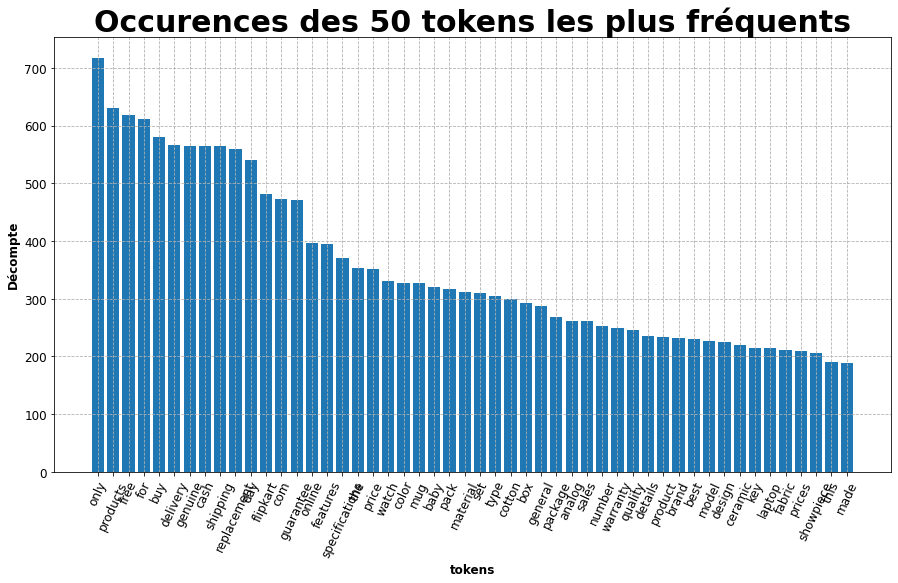

In [249]:
#Affichage des tokens les plus fréquents du jeu de données

plt.figure(figsize = (15,8))
plt.rcParams.update({'font.size' : 12})
plt.title('Occurences des 50 tokens les plus fréquents', size = 30, weight = 'bold')
plt.bar(tokens_counts.index[:50], tokens_counts.values[:50])
x = plt.xticks(rotation = 65)
plt.xlabel('tokens', weight = 'bold')
plt.ylabel('Décompte', weight = 'bold')
plt.grid(True, ls = '--')

Text(3000, 500, 'Seuil : 50')

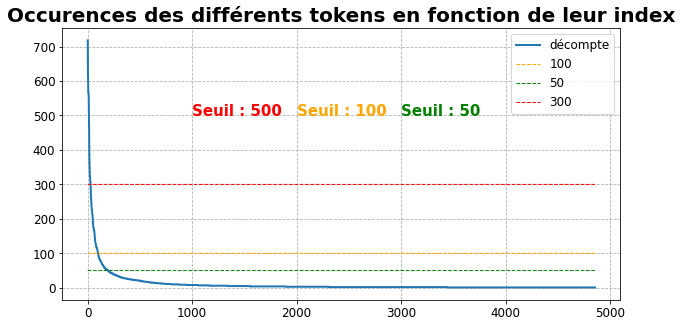

In [250]:
#Courbe des occurences des tokens du corpus brut

plt.figure(figsize = (10,5))
plt.title('Occurences des différents tokens en fonction de leur index', size = 20, weight = 'bold')
plt.plot(range(len(tokens_counts)), tokens_counts.values, lw = 2, label = 'décompte')
plt.plot(range(len(tokens_counts)), np.full((len(tokens_counts),1),100), lw = 1, label = '100', ls = '--', color = 'orange')
plt.plot(range(len(tokens_counts)), np.full((len(tokens_counts),1),50), lw = 1, label = '50', ls = '--', color = 'green')
plt.plot(range(len(tokens_counts)), np.full((len(tokens_counts),1),300), lw = 1, label = '300', ls = '--', color = 'red')
plt.grid(True, ls = '--')
plt.legend()
plt.text(1000, 500, 'Seuil : 500', color = 'red', size = 15, weight = 'bold')
plt.text(2000, 500, 'Seuil : 100', color = 'orange', size = 15, weight = 'bold')
plt.text(3000, 500, 'Seuil : 50', color = 'green', size = 15, weight = 'bold')

Nous pouvons faire quelques observations : 

*   L'immense majorité des tokens n'apparaissent que peu souvent et n'apportent aucun élément pertinent à notre étude car ne permettent pas de mettre en avant le liens entre l'occurence de ce token et l'appartenance à une catégorie de produits.

*   Certains tokens apparaissent très souvent, et ne permettent pas d'apporter d'informations pertinentes vis-à-vis de l'appartenance d'un texte à une catégorie en particulier
    
Pour le démontrer, nous pouvons mettre en place des wordclouds sur les corpus des différentes catégories.

In [251]:
#Mise en place d'une table de correspondance entre corpus et catégories

categ_unique = final_df['categs'].unique()
numbers = range(1, len(categ_unique) + 1)
binds = pd.DataFrame({'categ' : categ_unique, 'number' : numbers})
binds

,categ,number
0,Home Furnishing,1
1,Baby Care,2
2,Watches,3
3,Home Decor & Festive Needs,4
4,Kitchen & Dining,5
5,Beauty and Personal Care,6
6,Computers,7


In [252]:
#Définition des 7 corpus de descriptions, et ajout dans une liste de corpus

corpus_list = []

for i in binds['categ']:
    num = binds.loc[binds['categ'] == i, 'number'].values[0]
    tmp = 'corpus_' + str(num)
    locals()[tmp] = " ".join(final_df.loc[final_df['categs'] == i, 'description'])
    corpus_list.append(locals()[tmp])

corpus_list[1][:200]

'Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Features Machine Washable Yes Material Cotton Design Self Design General Brand Sathiyas Type Bath Towel GSM 50'

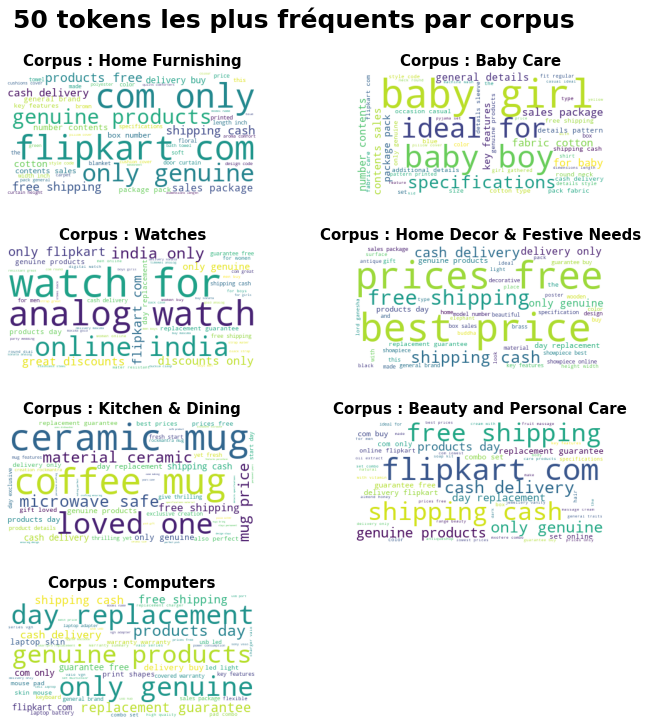

In [253]:
#Affichage des wordclouds des mots les plus fréquents des différents corpus

fig, axes = plt.subplots(4,2, figsize = (10,10))
fig.tight_layout(pad=2.0)
plt.delaxes(axes[-1, -1])
fig.suptitle('50 tokens les plus fréquents par corpus', size = 25, weight = 'bold', y = 1.05)
for i, ax in zip(binds['number'], axes.ravel()):
    tmp = cleaning_tokens(locals()['corpus_'+str(i)])
    wordcloud = WordCloud(background_color = 'white',
                     stopwords = [],
                     max_words = 50).generate(' '.join(tmp))
    ax.imshow(wordcloud)
    ax.axis('off')
    ax.set_title('Corpus : {}'.format(binds.loc[binds['number'] == i, 'categ'].values[0]), 
                 size = 15, weight = 'bold')

  On note que l'on a de nomreux tokens très intéressants vis-à-vis de notre problèmatique. On peut noter les tokens coffee ou encore micro_wave pour le corpus Kitchen & Dining, ou encore les tokens watch et analog pour le corpus Watches.

  Neanmoins, nous avons des tokens qui reviennent systématiquement au sein de nos corpus, tel que flipkart, shipping ou encore delivery, guarantee, ...

  Ainsi, nous pouvons enrichir notre fonction de nettoyage pour intégrer la supréssion des tokens récurrents entre les différentes catégories dans le cadre du bag of words, mais également la suppression des tokens qui aparaissent trop peu souvent.

In [254]:
#Définition de la seconde fonction de nettoyage supprimant les tokens rares et sur+représentés

def tokens_cleaning_2(doc, raw_corpus, mini, maxi):
    #récupération des tokens initaux
    tokens = cleaning_tokens(doc)
    
    #Récupération des tokens les plus représentés dans le corpus global et les moins représentés
    full_tokens = cleaning_tokens(raw_corpus)
    tmp = pd.Series(full_tokens).value_counts()
    over_rep = tmp.loc[tmp > maxi].index
    under_rep = tmp.loc[tmp < mini].index
    tmp2 = [w for w in tokens if w not in over_rep]
    final = [w for w in tmp2 if w not in under_rep]
    
    return final

In [255]:
#fonction de comparaison entre le texte de base et les tokens des deux fonctions

def texte_vs_tokens(mini, maxi):
    n = np.random.randint(len(final_df))
    tmp = final_df.loc[final_df.index == n]
    doc = tmp['description'].values[0]
    tokens = cleaning_tokens(doc)
    tokens2 = tokens_cleaning_2(doc, raw_corpus, mini, maxi)
    print('\033[1m' + 'Description' + '\033[0m' + ': {}'.format(doc))
    print('\n')
    print('\033[1m' + 'tokens' + '\033[0m' + ': {}'.format(tokens))
    print('\n')
    print('\033[1m' + 'tokens deuxième fonction' + '\033[0m' + ': {}'.format(tokens2))

In [256]:
#Comparaison des fonctions de nettoyage pour entre 3 et 200 occurences par tokens

texte_vs_tokens(20, 200)

Description: Key Features of Nutcase Multicolor Column Floor Lamp Designer Lamp Bulb Included Cool & Quirky Design Sturdy Structure,Nutcase Multicolor Column Floor Lamp (31 cm) Price: Rs. 1,299 Nutcase brings you for the first time in India - Designer Floor Lamps . Light up your home or office with this colorful lamp . Comes in over 100+ designs.


tokens: ['key', 'features', 'nutcase', 'multicolor', 'column', 'floor', 'lamp', 'designer', 'lamp', 'bulb', 'included', 'cool', 'quirky', 'design', 'sturdy', 'structure', 'nutcase', 'multicolor', 'column', 'floor', 'lamp', 'price', 'nutcase', 'brings', 'first', 'time', 'india', 'designer', 'floor', 'lamps', 'light', 'home', 'office', 'colorful', 'lamp', 'comes', 'designs']


tokens deuxième fonction: ['nutcase', 'multicolor', 'lamp', 'designer', 'lamp', 'bulb', 'included', 'nutcase', 'multicolor', 'lamp', 'nutcase', 'brings', 'time', 'india', 'designer', 'light', 'home', 'office', 'lamp', 'comes', 'designs']


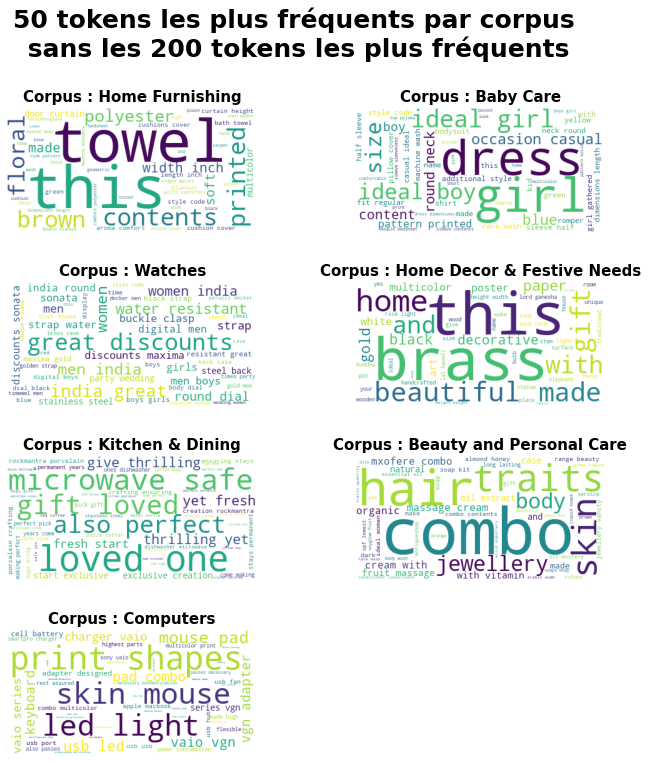

In [257]:
#Affichage des wordclouds des mots les plus fréquents des différents corpus avec la deuxième fonction de cleaning

fig, axes = plt.subplots(4,2, figsize = (10,10))
fig.tight_layout(pad=2.0)
fig.suptitle('50 tokens les plus fréquents par corpus\n sans les 200 tokens les plus fréquents', size = 25, weight = 'bold', y = 1.1)
plt.delaxes(axes[-1, -1])
for i, ax in zip(binds['number'], axes.ravel()):
    tmp = tokens_cleaning_2(locals()['corpus_'+str(i)], raw_corpus, 3, 200)
    wordcloud = WordCloud(background_color = 'white',
                     stopwords = [],
                     max_words = 50).generate(' '.join(tmp))
    ax.imshow(wordcloud)
    ax.axis('off')
    ax.set_title('Corpus : {}'.format(binds.loc[binds['number'] == i, 'categ'].values[0]), 
                 size = 15, weight = 'bold')

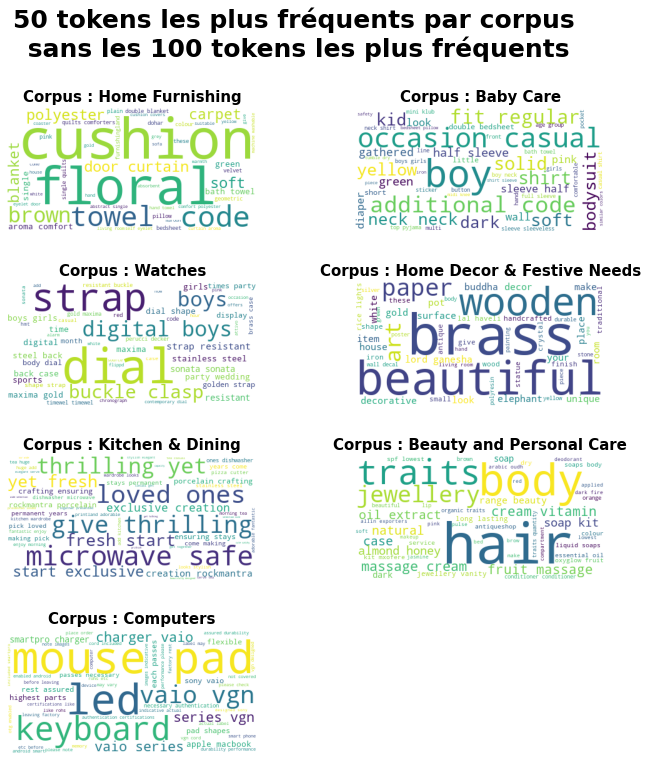

In [258]:
#Affichage des wordclouds des mots les plus fréquents des différents corpus avec la deuxième fonction de cleaning

fig, axes = plt.subplots(4,2, figsize = (10,10))
fig.tight_layout(pad=2.0)
fig.suptitle('50 tokens les plus fréquents par corpus\n sans les 100 tokens les plus fréquents', size = 25, weight = 'bold', y = 1.1)
plt.delaxes(axes[-1, -1])
for i, ax in zip(binds['number'], axes.ravel()):
    tmp = tokens_cleaning_2(locals()['corpus_'+str(i)], raw_corpus, 3, 100)
    wordcloud = WordCloud(background_color = 'white',
                     stopwords = [],
                     max_words = 50).generate(' '.join(tmp))
    ax.imshow(wordcloud)
    ax.axis('off')
    ax.set_title('Corpus : {}'.format(binds.loc[binds['number'] == i, 'categ'].values[0]), 
                 size = 15, weight = 'bold')

In [259]:
#Informations sur les tokens uniques pour la seconde fonction de cleaning

display_tokens_info(tokens_cleaning_2(raw_corpus, raw_corpus, 3, 200))

nb_tokens 34940, nb tokens uniques 2262
['elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'this', 'curtain', 'enhances', 'look', 'interiors', 'this', 'curtain', 'made', 'high', 'polyester', 'eyelet', 'style', 'metal']


In [260]:
#Décompte du nombre de tokens uniques en fonction du nombre maximal d'occurences considéré

span = np.linspace(1,1000,100).astype(int)
nb_unique_tokens = []
for i in span:
    tmp = tokens_cleaning_2(raw_corpus, raw_corpus, 3, i)
    nb_unique_tokens.append(len(set(tmp)))

Text(0, 0.5, 'Décompte')

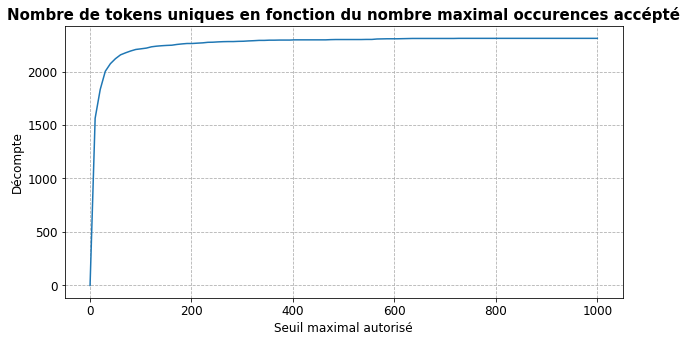

In [261]:
#Affichage de la courbe

plt.figure(figsize = (10,5))
plt.title('Nombre de tokens uniques en fonction du nombre maximal occurences accépté', size = 15, weight = 'bold')
plt.plot(span, nb_unique_tokens)
plt.grid(True, ls = '--')
plt.xlabel('Seuil maximal autorisé')
plt.ylabel('Décompte')

De la même manière, nous pouvons avoir la même démarche en conservant 150 occurences maximales pour le nombre d'occurences du token, mais en s'appuyant cette fois-ci sur le nombre d'occurences minimales.

In [262]:
#Décompte du nombre de tokens uniques en fonction du nombre minimal d'occurences considéré

span2 = np.linspace(1,1000,100).astype(int)
nb_unique_tokens2 = []
for i in span2:
    tmp = tokens_cleaning_2(raw_corpus, raw_corpus, i, 200)
    nb_unique_tokens2.append(len(set(tmp)))

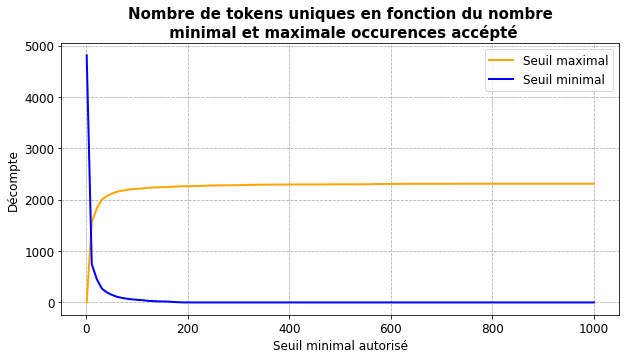

In [263]:
#Affichage de la courbe

plt.figure(figsize = (10,5))
plt.title('Nombre de tokens uniques en fonction du nombre\n minimal et maximale occurences accépté', size = 15, weight = 'bold')
plt.plot(span, nb_unique_tokens, color = 'orange', lw = 2, label = 'Seuil maximal')
plt.plot(span2, nb_unique_tokens2, color = 'blue', lw = 2, label = 'Seuil minimal')
plt.grid(True, ls = '--')
plt.xlabel('Seuil minimal autorisé')
plt.ylabel('Décompte')
plt.legend()

Enfin, nous pouvons considérer l'utilisation d'un lemmatizer ou d'un stemmer pour réduire encore le nombre de tokens uniques à considérer.

Dans cette partie, nous allons essayer un lemmatizer et deux stemmers pour en comparer les résutats.

In [264]:
#Différents stemmer et lemmer à essayer
from nltk.stem import WordNetLemmatizer

snowball = SnowballStemmer('english')
porter = PorterStemmer()
wordnet = WordNetLemmatizer()

In [265]:
#Tokenization du raw_corpus et définition de nos stemmers et lemmers

full_tokens = tokens_cleaning_2(raw_corpus, raw_corpus, 20,150)
snow = [snowball.stem(w) for w in full_tokens]
port = [porter.stem(w) for w in full_tokens]
net = [wordnet.lemmatize(w) for w in full_tokens]

Nous affichons ensuite les informations des tokens passés dans les différents stemmers et lemmatizers, ce qui nous permet de sélectionner un stemmer, et en l'occurance, nous allons privilégier le snowball stemmer.

In [266]:
#Tokens infos du Snowball Stemmer
display_tokens_info(snow)

nb_tokens 19896, nb tokens uniques 412
['polyest', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'polyest', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'curtain', 'look', 'curtain', 'high', 'polyest', 'eyelet', 'style', 'metal', 'make', 'room', 'curtain', 'anti', 'eleg', 'give', 'design', 'sure', 'these']


In [267]:
#Tokens infos du PorterStemmer
display_tokens_info(port)

nb_tokens 19896, nb tokens uniques 412
['polyest', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'polyest', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'curtain', 'look', 'curtain', 'high', 'polyest', 'eyelet', 'style', 'metal', 'make', 'room', 'curtain', 'anti', 'eleg', 'give', 'design', 'sure', 'these']


In [268]:
#Tokens infos du WordNtLemmatizer
display_tokens_info(net)

nb_tokens 19896, nb tokens uniques 433
['polyester', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'polyester', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'curtain', 'look', 'curtain', 'high', 'polyester', 'eyelet', 'style', 'metal', 'make', 'room', 'curtain', 'anti', 'elegant', 'give', 'design', 'sure', 'these']


Dans notre cas, et pour les méthodes Countvectorizers et TF-IDF, nous utiliserons un stemmer car cela réduit légèrement le nombre de tokens uniques.

Nous reviendrons plus tard sur les cas des approches Word2Vec, Bert et USE pour lesquels nous utiliserons un Lemmatizer, de manière à faire correspondre les tokens ayant des sens similaires, ce qui est une approche plus adaptée à ces démarches.

In [269]:
#Définition de la fonction de nettoyage finale

stop_w = list(set(stopwords.words('english')))

def mid_cleaning(doc):
    #tokenisation
    tokenizer = RegexpTokenizer(r'\w+')
    tokens = tokenizer.tokenize(doc)
    
    #lower and keep alpha only
    lower_w = [w.lower() for w in tokens if w.isalpha()]
    
    #suppression des stopwords
    no_stop_words = [w for w in lower_w if w not in stop_w]
    
    #conservation des tokens de plus de 2 caractères
    size_filtered = [w for w in no_stop_words if len(w) > 2]
    
    #stemmed
    stemmer = SnowballStemmer('english')
    stemmed = [stemmer.stem(w) for w in size_filtered]
    
    #final
    final = ' '.join(stemmed)
    
    return final

def final_cleaning(doc, raw_corpus, mini, maxi):
    #Récupération des tokens les plus représentés dans le corpus global et les moins représentés
    full_tokens = mid_cleaning(raw_corpus)
    full_tokens = full_tokens.split(' ')
    stemmed = mid_cleaning(doc)
    stemmed = stemmed.split(' ')
    tmp = pd.Series(full_tokens).value_counts()
    over_rep = tmp.loc[tmp > maxi].index
    under_rep = tmp.loc[tmp < mini].index
    tmp2 = [w for w in stemmed if w not in over_rep]
    final = [w for w in tmp2 if w not in under_rep]
    final = ' '.join(final)
    return final

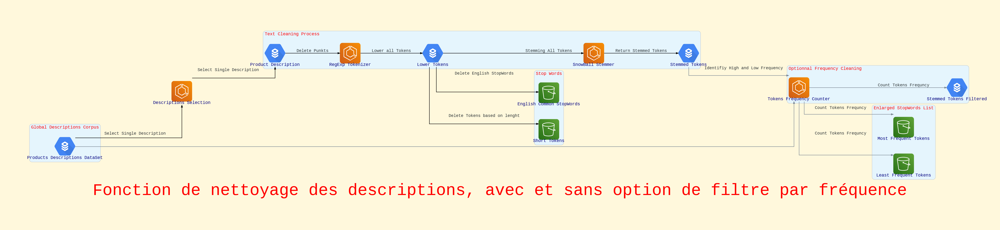

In [270]:
#Diagramme explicatif des fonticons de nettoyage pour Bag-of-Words

from diagrams.aws.storage import S3
from diagrams.aws.compute import ECS
graph_attr = {
    "fontsize": "80",
    "bgcolor": "cornsilk", 'lwidth' : '20', 'fontcolor' : 'red', 'fontweight' : 'bold'
}

node_attr = {
    "fontsize": "22",
    "fontcolor": "navy", 'fontweight' : 'bold',
}

clust_attr = {
    'fontsize' : '22', 'fontcolor' : 'red', 'fontweight' : 'bold'
}


with Diagram('Fonction de nettoyage des descriptions, avec et sans option de filtre par fréquence', graph_attr = graph_attr, node_attr = node_attr, direction = 'LR') as diag:

    Desc_Selector = ECS('Descriptions Selection', style = 'bold')
    with Cluster('Global Descriptions Corpus', graph_attr = clust_attr):
        Raw_Corpus = SQL('Products Descriptions DataSet', Style = 'bold')
        Raw_Corpus >> Edge(label = 'Select Single Description', color = 'black', style = 'bold', fontsize = '20') >> Desc_Selector

    with Cluster('Text Cleaning Process', graph_attr = clust_attr):
        Init_desc = SQL('Product Description', style = 'bold')
        Tokenizer = ECS('RegExp Tokenizer', style = 'bold')
        Lower = SQL('Lower Tokens', style = 'bold')
        Stemmer = ECS('SnowBall Stemmer', style = 'bold')
        Stemmed = SQL('Stemmed Tokens', style = 'bold')
      
    Init_desc >> Edge(label = 'Delete Punkts', color = 'black', style = 'bold', fontsize = '20') >> Tokenizer
    Tokenizer >> Edge(label = 'Lower all Tokens', color = 'black', style = 'bold', fontsize = '20') >> Lower
    Lower >> Edge(label = 'Stemming All Tokens', color = 'black', style = 'bold', fontsize = '20') >> Stemmer
    Stemmer >> Edge(label = 'Return Stemmed Tokens', color = 'black', style = 'bold', fontsize = '20') >> Stemmed
    Desc_Selector >> Edge(label = 'Select Single Description', color = 'black', style = 'bold', fontsize = '20') >> Init_desc
    
    with Cluster('Stop Words', graph_attr = clust_attr):
        StopWords = S3('English Common StopWords', stye = 'bold')
        Size_Filter = S3('Short Tokens', style = 'bold')
        Lower >> Edge(label = 'Delete English StopWords', color = 'black', style = 'bold', fontsize = '20') >> StopWords
        Lower >> Edge(label = 'Delete Tokens based on lenght', color = 'black', style = 'bold', fontsize = '20') >> Size_Filter

    with Cluster('Enlarged StopWords List', graph_attr = clust_attr):
        OverRep = S3('Most Frequent Tokens', style = 'bold')
        UnderRep = S3('Least Frequent Tokens', style = 'bold')

    with Cluster('Optionnal Frequency Cleaning', graph_attr = clust_attr):
        Tokens_Counter = ECS('Tokens Frequency Counter', style = 'bold')
        Final_Cleaned = SQL('Stemmed Tokens Filtered', style = 'bold')
        Stemmed >> Edge(label = 'Identifiy High and Low Frequency', style = 'bold', fontsize = '20') >> Tokens_Counter
        Raw_Corpus >> Edge(label = '', style = 'bold', fontsize = '20') >> Tokens_Counter
        Tokens_Counter >> Edge(label = 'Count Tokens Frequncy', style = 'bold', fontsize = '20') >> OverRep
        Tokens_Counter >> Edge(label = 'Count Tokens Frequncy', style = 'bold', fontsize = '20') >> UnderRep
        Tokens_Counter >> Edge(label = 'Count Tokens Frequncy', style = 'bold', fontsize = '20') >> Final_Cleaned
diag

## 5.2- Définition de fonctions communes

In [271]:
#Importation de librairies de réduction dimensionnelle et de visualisation

from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from sklearn.manifold import TSNE
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import confusion_matrix
from scipy.spatial.distance import cosine
from sklearn.preprocessing import StandardScaler

In [272]:
#Fonction de réduction dimensionnelle par PCA

def PCA_reductor(df, n_comp):
    pca = PCA(n_components = n_comp)
    df_reduced = pd.DataFrame(pca.fit_transform(df))
    print('PCA -- Nombre de dimensions initiales : {}'.format(len(df.columns)))
    print('PCA -- Nombre de composantes principales : {}'.format(len(df_reduced.columns)))
    return df_reduced

#Fonction de réduction dimensionnelle par TruncatedSVD - nous voulons conserver une partie de la variance (et donc de l'information du jeu de données)
#Pour ce faire, nous effectuons une réduction dimensionnelle en ne réduisant le nombre de dimensions que de 1, et nous
#sélectionnons le nombre de dimensions conservant la varance expliquée souhaitée

def SVD_reductor(df, n_comp):
  #TruncateSVD avec conservation du nombre de dimensions initiales -1
    size = len(df.columns) - 1
    svd = TruncatedSVD(n_components = size, random_state = 11)
    df_reduced = pd.DataFrame(svd.fit_transform(df))
  #Recherche du nombre de composantes pour conserver le pourcentage de variance souhaité
    cumsum_variancy = pd.DataFrame(svd.explained_variance_.cumsum(), columns = ['explained'])
    cumsum_variancy['ratio'] = cumsum_variancy['explained'] / cumsum_variancy['explained'].max()
    tmp = cumsum_variancy.loc[cumsum_variancy['ratio'] < n_comp]
    n_dim = tmp.index[-1] + 1
  #Réduction dimensionnelle finale avec la variance expliquée souhaité conservée
    svd2 = TruncatedSVD(n_components = n_dim)
    df_reduced2 = pd.DataFrame(svd2.fit_transform(df))
    print('TruncatedSVD -- Nombre de dimensions initiales : {}'.format(len(df.columns)))
    print('TruncatedSVD -- Nombre de composantes principales : {}'.format(len(df_reduced2.columns)))
    return df_reduced2

In [273]:
#Fonction de réduction dimensionnelle par TSNE en fixant le nombre de composantes et la perplexité

def TSNE_reductor(df, n_comp, perplex):
    tsne = TSNE(n_components = n_comp, perplexity = perplex, learning_rate = 'auto', max_iter = 100000,
               n_jobs = -1, verbose = 0, init = 'random', random_state = 11)
    cols = []
    for i in range(n_comp):
        tmp = 'Component_' + str(i + 1)
        cols.append(tmp)
    tsne_df = pd.DataFrame(tsne.fit_transform(df), columns = cols)
    return tsne_df

En ce aui concerne le TSNE, nous avons besoin de définir les meilleures valeurs de certains hyper-paramètres afin :

*   D'obtenir une visualisation la plus lisible et interprètable possible dans le cas où nous faisons de la visualisation
*   D'obtenir le meilleur jeu de données possible dans le cas de la réduction dimensionnelle pour avoir les meilleurs résultats possibles pour effectuer un clustering. 
        
Dans notre cas, nous fixons un nombre maximal d'itérations (le TSNE étant sensé stopper au bout d'environ 300 itératons sans progrès dans la minimisation de la divergence de Kullback-Leibler), et le learning rate en 'auto', afin de le minimiser à 50 et de le contrôler à partir de l'early exaggeration.

L'hyperparamètre le plus critique est donc la perplexité, pour laquelle nous effectuons une recherche sur grille en employant différentes stratégies. Notre but va être de tester différentes valeurs de perplexité, et en exrtaire la meilleure valeur dans le cadre du clustering. 
    
Notons qu'augmenter la perplexité fera naturellement diminuer la divergence de kullback-leibler, mais  n'est pas un critère suffisant pour définir la meilleure valeur de perplexité dans notre cas. Nous allons donc présenter différentes fonctions dans cette optique.
    
Enfin, nous initions systématiquement le TSNE avec une PCA effectuée manuellement, afin d'en améliorer la stabilité. Cette option est disponible dans la fonction TSNE de scikit-learn, mais ne permet pas de contrôler le nombre de composantes principales de la PCA.

In [274]:
#Fonction permettant d'afficher la valeur de la divergence de kullback-leibler sur un dataframe en fonction de la perplexité,
#en fixant le nombre de composantes, le minimum de perplexité, le maximum de perplexité, et le nombre de valeurs à essayer

def TSNE_perplexity_tuner_nomap(df, n_comp, mini, maxi, nb):
    
    ''' 1- Mise en place de la grille de perplexités à essayer.
        2- Entraînement du TSNE  pour chaque perplexité à essayer.
        3- Mesure de la divergence de kullback-leibler.
        4- Retourner un DataFrame liant les perplexités et les divergences mesurées.'''
    
    grid = np.linspace(mini, maxi, nb).astype(int)
    kl = []
    for i in grid:
        tsne = TSNE(n_components = n_comp, perplexity = i, learning_rate = 'auto', n_iter = 100000,
                    n_jobs = -1, verbose = 0, init = 'random', random_state = 11)
        tsne.fit(df)
        kl.append(tsne.kl_divergence_)
    tmp = pd.DataFrame({'Perplexity' : grid, 'KL_divergence' : kl})
    return tmp

In [275]:
#Affichage de la divergence de Kullback-leibler en fonction de la perplexité
#Nous n'utiliserons pas cette fonction dans ce notebook, mais elle a permis d'explorer plusieurs pistes pour la recherche des meilleurs hyper-paramètres du TSNE

def TSNE_perplexity_tuner_plotted(df, n_comp, mini, maxi, nb):
    '''1- Appel de la fonction TSNE_perplexity_tuner_nomap
       2- Affichage de la courbe KL_divergence en fonction de la perplexité'''
    tmp = TSNE_perplexity_tuner_nomap(df, n_comp, mini, maxi, nb)
    plt.rcParams.update({'font.size' : 15})
    plt.figure(figsize = (20,10))
    plt.title('Mesure de la divergence de Kullback-Leibler en fonction de la perplexité', size = 20, weight = 'bold')
    plt.plot(grid, kl, lw = 2, color = 'blue', label = 'KL_Divergence')
    plt.grid(True, ls = '--')
    plt.legend()
    plt.xlabel('Perplexity')
    plt.ylabel('KL_Divergence')

In [276]:
#Fonction d'affichage des nuages de points en fonction des perplexités testés, valable seulement pour 2 composantes

def TSNE_perplexity_tuner_mapped(df, n_comp, mini, maxi, nb, categories):
    
    '''1- Réduction dimensionelle par PCA
       2- Réduction à deux dimensions par TSNE pour les différentes valeurs de perplexité
       3- Affichage des nuages de points en fonction des catégories des individus'''
    
    grid = np.linspace(mini, maxi, nb).astype(int)
    kl = []
    if nb%3 == 0:
        rows = nb//3
    else:
        rows = nb//3 + 1
    pca_df = PCA_reductor(df, n_comp)
    print('----------\n')
    print('TSNE -- Essais de {} valeurs de perplexité'.format(nb))
    print('TSNE -- Perplexité minimale : {}'.format(mini))
    print('TSNE -- Perplexité maximale : {}'.format(maxi))
    print('----------\n')
    fig, axes = plt.subplots(rows, 3, figsize = (10, rows * 2), sharex = True, sharey = True)
    plt.rcParams.update({'font.size' : 8})
    fig.tight_layout(pad=2.0)
    fig.suptitle('Réduction dimensionelle par TSNE en fonction de la perplexité', size = 20, weight = 'bold', y = 1.5)
    colors = sns.color_palette("tab10")[:len(np.unique(categories))]
    color_dict = {np.unique(categories)[i]:sns.color_palette('tab10')[i] for i in range(len(np.unique(categories)))}
    for i, ax in zip(grid, axes.ravel()):
        tsne = TSNE(n_components = 2, perplexity = i, learning_rate = 'auto', n_iter = 100000,
                    n_jobs = -1, verbose = 0, init = 'random', random_state = 11)
        tsne_df = pd.DataFrame(tsne.fit_transform(pca_df), columns = ['Component_1', 'Component_2'])
        tsne_df['Labels'] = categories
        kl.append(tsne.kl_divergence_)
        for cat in tsne_df['Labels'].unique():
            tmp = tsne_df.loc[tsne_df['Labels'] == cat]
            ax.scatter(tmp['Component_1'], tmp['Component_2'], c = np.array(color_dict[cat]).reshape(1,-1), label = cat, s = 4)
        ax.set_title('Perplexity : {}'.format(i), size = 12, weight = 'bold')
        ax.grid(True, ls = '--')
    fig.legend(axes.ravel(), labels=color_dict.keys(), loc = 'upper center', fancybox = True,
              bbox_to_anchor = [-0.15, 1.3, .75, 0.2], title = 'Catégories réelles', title_fontsize = 15)
    fig.text(0.5, -0.05, 'Component_1', ha='center', size = 15, weight = 'bold')
    fig.text(-0.05, 0.5, 'Component_2', va='center', rotation='vertical', size = 15, weight = 'bold')

In [277]:
#Recherche de la meilleure perplexité en utilisant un DBSCAN, et en mesurant le silhouette score, de manière à retrouver 
#un jeu de données à dimensions réduites se prétant au mieux au clustering

#Cette fonction n'est pas utilisée dans ce notebook, car moins intéressante que la fonction de recherche du meilleur ARI
#sur grille, mais a néanmoins constitué une piste de recherche intéressante 

def TSNE_perplexity_db_tuner_plotted(df,n_comp_PCA, n_comp_tsne, mini, maxi, nb):
    
    '''1- Réduction dimensionnelle par PCA
       2- Réduction dimensionnelle par TSNE pour chaque valeur de perplexité testée
       3- Clustering par DBSCAN
       4- Mesure du silhouette score et affichage de la courbe silhouette score en fonction de la perplexité
       5- Meilleure perplexité = Silhouete score le plus élevé'''
    
    grid = np.linspace(mini, maxi, nb).astype(int)
    kl = []
    silhouette = []
    pca_df = PCA_reductor(df, n_comp_PCA)
    print('----------\n')
    print('TSNE -- Essais de {} valeurs de perplexité'.format(nb))
    print('TSNE -- Perplexité minimale : {}'.format(mini))
    print('TSNE -- Perplexité maximale : {}'.format(maxi))
    print('----------\n')
    for i in grid:
        tsne = TSNE(n_components = n_comp_tsne, perplexity = i, learning_rate = 'auto', n_iter = 100000,
                    n_jobs = -1, verbose = 0, init = 'random', random_state = 11)
        tsne_df = pd.DataFrame(tsne.fit_transform(pca_df))
        kl.append(tsne.kl_divergence_)
        db = DBSCAN(n_jobs = -1)
        db.fit(tsne_df)
        labels = db.labels_
        if len(set(labels)) < 2:
            labels[:-1] = list(set(labels))[0] + 1 
        sil = silhouette_score(tsne_df, labels)
        silhouette.append(sil)
        print('Perplexité : {} - Silhouette Score : {}'.format(i, str(sil)[:5]))
    tmp = pd.DataFrame({'Perplexity' : grid, 'KL_divergence' : kl, 'Silhouette' : silhouette})
    best_perp = tmp.loc[tmp['Silhouette'] == tmp['Silhouette'].max(), 'Perplexity'].values[0]
    print('Meilleure valeur de perplexité : {}'.format(best_perp))
    plt.rcParams.update({'font.size' : 15})
    plt.figure(figsize = (20,10))
    plt.title('Mesure du silhouette score du dbscan en fonction de la perplexité', size = 25, weight = 'bold')
    plt.plot(grid, silhouette, lw = 2, color = 'blue', label = 'Silhouette Score')
    plt.plot(np.linspace(np.min(grid), best_perp, 20), np.full(20, np.max(sil)), color = 'red', ls = '--')
    plt.plot(np.full(20, best_perp), np.linspace(np.min(sil), np.max(sil), 20), color = 'red', ls = '--')
    plt.grid(True, ls = '--')
    plt.legend()
    plt.xlabel('Perplexity')
    plt.ylabel('Silhouette Score')
    plt.text(best_perp, np.max(sil) + 0.05, 'Perplexité : {} - Silhouette Score {}'.format(best_perp, np.max(sil)),
            color = 'red', size = 12, weight = 'bold')
    return best_perp

In [278]:
#Cette fonction permet une réduction dimensionnelle par PCA, puis un clustering en utilisant le KMeans, et une visualisation 
#en utilisant le TSNE, pour lequel la perplexité est trouvée en mesurant l'adjusted random index sur une plage définie
#de perplexités, et de conserver la meilleur valeur de perplexité

def PCA_TSNE_ARI_tuner_KM(df, n_comp, mini, maxi, nb, n_clust, categs, sparse, standard):
    
    '''1- Réduction dimensionnelle par PCA ou TruncatedSVD dans le cas des matrices très sparses
       2- Réduction dimensionnelle par TSNE pour chaque valeur de perplexité
       3- Clustering par KMeans (n_clust)
       4- Mesure Adjusted Random Index entre les labels KMeans et les catégories réelles (categs)
       5- Entraînement TSNE pour la valeur de perplexité maximisant ARI
       6- Affichage des scatterplots pour les étiquettes réelles et KMeans
       7- Affichage courbe ARI en fonction de perplexité'''
    #StandardScaler si standard == True
    if standard == True:
        std = StandardScaler()
        df = pd.DataFrame(std.fit_transform(df))

    #Réduction dimensionnelle par PCA ou SVD_reductor avec n_comp pour la quantité de variance conservée
    if sparse == False:
        pca_df = PCA_reductor(df, n_comp)
        print('----------\n')
        print('TSNE -- Essais de {} valeurs de perplexité'.format(nb))
        print('TSNE -- Perplexité minimale : {}'.format(mini))
        print('TSNE -- Perplexité maximale : {}'.format(maxi))
        print('----------\n')
    else:
        pca_df = SVD_reductor(df, n_comp)
        print('----------\n')
        print('TSNE -- Essais de {} valeurs de perplexité'.format(nb))
        print('TSNE -- Perplexité minimale : {}'.format(mini))
        print('TSNE -- Perplexité maximale : {}'.format(maxi))
        print('----------\n')
    
    #Recherche sur grille de la meilleure valeur de perplexité - clustering avec KMeans et mesure de l'ARI
    grid = np.linspace(mini, maxi, nb).astype(int)
    kl = []
    ari_list = []
    for i in grid:
        tsne = TSNE(n_components = 2, perplexity = i, learning_rate = 'auto', n_iter = 100000,
                    n_jobs = -1, verbose = 0, init = 'random', random_state = 11)
        tsne_df = pd.DataFrame(tsne.fit_transform(pca_df))
        kl.append(tsne.kl_divergence_)
        km_tmp = KMeans(n_clusters = n_clust, max_iter = 100000)
        km_tmp.fit(tsne_df)
        labels = km_tmp.labels_
        if len(set(labels)) < 2:
            labels[:-1] = list(set(labels))[0] + 1 
        ari_tmp = adjusted_rand_score(labels, categs)
        ari_list.append(ari_tmp)
        print('Perplexité : {} - ARI : {}'.format(i, str(ari_tmp)[:5]))
    tmp = pd.DataFrame({'Perplexity' : grid, 'KL_divergence' : kl, 'ARI' : ari_list})

    #Récupération de la meilleure valeure de perplexité 
    best_perp = tmp.loc[tmp['ARI'] == tmp['ARI'].max(), 'Perplexity'].values[0]
    print('Meilleur perplexité : {}'.format(best_perp))
    
    #Réduction dimensionnelle par TSNE
    tsne_final = TSNE(n_components = 2, perplexity = best_perp, learning_rate = 'auto', n_iter = 100000,
                    n_jobs = -1, verbose = 0, init = 'random', random_state = 11)
    tsne_df_final = pd.DataFrame(tsne_final.fit_transform(pca_df), columns = ['Component_1', 'Component_2'])

    #Clustering avec KMeans
    km = KMeans(n_clusters = n_clust, max_iter = 100000)
    km.fit(tsne_df_final)
    km_labels = km.labels_
    ARI = adjusted_rand_score(km_labels, categs)

    #Visualisation des clusters dans l'espace réduit par TSNE et comparaison avec les catégories réelles
    tsne_df_final['Labels'] = km_labels
    tsne_df_final['Categs'] = categs
    fig = plt.figure(figsize = (20,10))
    plt.rcParams.update({'font.size' : 8})
    fig.suptitle('Init. Dimensions : {} - PCA. Dimensions : {} - TSNE Best Perplexity : {} - ARI : {}'.format(len(df.columns), len(pca_df.columns), best_perp, str(np.max(ari_list))[:5]),
                size = 20, weight = 'bold', y = 1)
    ax1 = plt.subplot(212)
    ax1.margins(0.05)      
    ax1.plot(grid, ari_list, lw = 2, label = 'Adjusted Random Index')
    ax1.set_title('ARI en fonction de la perplexité', size = 15, weight = 'bold')
    ax1.grid(True, ls = '--')
    ax1.set_xlabel('Perplexity', size = 15, weight = 'bold')
    ax1.set_ylabel('Adjusted Random Index', size = 15, weight = 'bold')
    ax1.legend()
    
    ax2 = plt.subplot(221)
    sns.scatterplot(data = tsne_df_final, x = 'Component_1', y = 'Component_2', hue = 'Labels', ax = ax2, palette = 'tab10')
    ax2.set_title('Labels générées par le KMeans', size = 15, weight = 'bold')
    
    ax3 = plt.subplot(222)
    sns.scatterplot(data = tsne_df_final, x = 'Component_1', y = 'Component_2', hue = 'Categs', ax = ax3, palette = 'tab10')
    ax3.set_title('Catégories réelles des individus', size = 15, weight = 'bold')
    print('Adjusted Random Index : {}'.format(str(ARI)[:5]))

    #Retourne l'ARI et la meilleure parplexité
    return ARI, best_perp

In [279]:
#Réduction dimensionnelle par LatentDiricheletAllocation

def LDA_reductor(df, n_comp):
    lda = LatentDirichletAllocation(n_components=n_comp, max_iter=5, learning_method='online', 
        learning_offset=50.,random_state=11)
    lda.fit(df)
    transformed = pd.DataFrame(lda.transform(df))
    return lda, transformed

In [280]:
#Fonction d'affichage de Topics principaux en utilisant le LDA

def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic {}:".format(topic_idx))
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))
        print('\n')

In [281]:
#Fonction retournant les Topics principaux sous la forme d'un DataFrame

def lda_topics_df_maker(model, feature_names, no_top_words):
    topics_list = []
    tokens_list = []
    for topic_idx, topic in enumerate(model.components_):
        topics_list.append('Topic_' + topic_idx)
        tokens = [feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]
        tokens_list.append(tokens)
        final_df = pd.DataFrame(tokens_list, columns = topics_list)
    return final_df

In [282]:
#Fonction retourant la cosine similarity entre les individus d'un dataframe

def cosine_similarity_maker(df, names):
    cosine_matrix = []
    for i in df.index:
        tmp = []
        for j in df.index:
            tmp.append(1 - cosine(df.iloc[i].values, df.iloc[j].values))
        cosine_matrix.append(tmp)
    cosine_matrix = pd.DataFrame(cosine_matrix, columns = names, index = names) 
    return cosine_matrix


In [283]:
#Fonction de mise en place de la matrice de confusion entre les catégories réelles et les clusters KMeans

def confusion_matrice_maker(df, perp, n_comp, n_clust, categories):
  '''1- Réduction dimensionnelle par PCA
     2- Réduction dimensionnelle par TSNE
     3- Clustering par KMeans
     4- Réorganisation des cluster du KMeans pour qu'ils correspondent aux catégories réelles
     5- Mise en place de la matrice de confusion'''
    pca_df = PCA_reductor(df, n_comp)
    print('---------')
    print('TSNE - perplexité : {}'.format(perp))
    tsne_df = TSNE(n_components = 2, perplexity = perp, learning_rate = 'auto', n_iter = 100000,
                    n_jobs = -1, verbose = 0, init = 'random', random_state = 11).fit_transform(pca_df)
    print('---------')
    print('KM - Nombre de clusters : {}'.format(n_clust)) 
    km = KMeans(n_clusters = n_clust, max_iter = 100000)
    km.fit(tsne_df)
    labels = km.labels_
    compare_df = pd.DataFrame({'Categs' : categories, 'Labels' : labels})

    unique_categs = np.unique(categories)
    stacking_list = []
    for i in unique_categs:
        tmp = compare_df.loc[compare_df['Categs'] == i]
        labels_count = tmp['Labels'].value_counts(ascending = False).index.tolist()
        pop_list = []
        for j in range(len(labels_count)):
            if labels_count[j] in stacking_list:
                pop_list.append(j)
            for k in list(reversed(pop_list)):
                labels_count.pop(k)
    stacking_list.append(labels_count[0])

    conf_df = pd.DataFrame(confusion_matrix(categories, labels.astype(str))[7:, :7], index = unique_categs, columns = np.unique(labels))
    final_conf_df = pd.DataFrame()
    for i in stacking_list:
        final_conf_df[i] = conf_df[i]
    total_categs = final_conf_df.sum(axis = 1)
    final_conf_df['Total'] = total_categs
    total_labels = pd.DataFrame(final_conf_df.sum(axis = 0), columns = ['Total']).transpose()
    final_conf_df = pd.concat([final_conf_df, total_labels])
    return final_conf_df

In [284]:
#Fonction d'affichage de la matrice de confusion

def confusion_matrix_displayer(df, algo):
    plt.rcParams.update({'font.size' : 15})
    plt.figure(figsize = (15,8))
    sns.heatmap(data = df, annot = df, cmap = 'Blues', robust = True, linecolor = 'Red', linewidths = 2, fmt = '.0f')
    plt.title('Matrice de confusion entre les clusters du KMeans et \nles catégories réelles des individus pour le ' + algo, size = 25, weight = 'bold')
    plt.ylabel('Catégorie réelle', size = 20, weight = 'bold')
    plt.xlabel('Labels du KMeans', size = 20, weight = 'bold')

## 5.3- Count Vectorizer

In [285]:
#importation des librairies supplémentaires

from sklearn.feature_extraction.text import CountVectorizer

  Dans un premier temps, nous utilisons la première fonction de nettoyage du jeu de données (sans considérer la suppression des tokens les plus fréquentes, et les moins fréquents), et nous pourrons comparer les résultats avec la deuxième fonction de nettoyage.

In [286]:
#Application de la première fonction de cleaning

final_df['count_vectorizer_cleaned'] = final_df['description'].swifter.apply(lambda x : mid_cleaning(x))

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

In [287]:
#Afflichage de quelques valeurs

final_df['count_vectorizer_cleaned'].sample(3)

14     srushti art jewelri digit watch men women boy ...
353    buy asus dsl wireless adsl modem router flipka...
711    frabjous floral singl quilt comfort multicolor...
Name: count_vectorizer_cleaned, dtype: object

In [289]:
#Mise en place du count_vectorizer

cvect = CountVectorizer(ngram_range = (1,1))
cv_fit = cvect.fit(final_df['count_vectorizer_cleaned'].values)
cv_transform = cvect.fit_transform(final_df['count_vectorizer_cleaned'].values)
cv_matrix = pd.DataFrame(cv_transform.toarray(), columns = cvect.get_feature_names_out())

In [108]:
#Affichage de la matrice

print('Nombre de dimensions de notre matrice : {}'.format(len(cv_matrix.columns)))
print('\n')
cv_matrix.sample(5)

Nombre de dimensions de notre matrice : 3787




,aaa,aapno,aari,aarika,abil,abl,abod,abras,abroad,absolut,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
953,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
66,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
114,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
252,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1006,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [109]:
#Fonction d'affichage de phrases aléatoires avec les poids du CountVectorizer

def cv_random_displayer(df, n):
    #n = np.random.randint(cv_matrix.shape[0])
    tmp = final_df.loc[final_df.index == n]
    Desc = tmp['description'].values[0]
    Tokens = tmp['count_vectorizer_cleaned'].values[0]
    tmp2 = df.loc[df.index == n]
    Liste = []
    Weights = []
    for i in tmp2.columns:
        if tmp2[i].values[0] != 0:
                Weights.append(tmp2[i].values[0])
                Liste.append(i)
    #Concat_df = pd.DataFrame({'Tokens' : Liste, 'Poids' : Weights}).sort_values(by = 'Poids', ascending = False).transpose()
    Concat_df = pd.DataFrame({'Tokens' : Liste, 'Poids' : Weights}).transpose()

    fig, axes = plt.subplots(3, 1, figsize = (15,10))
    fig.tight_layout(pad = 2.0)
    for i, ax in zip(range(3), axes.ravel()):
        if i == 0:
            lenght = (len(Desc)//155) + 1
            for i in range(lenght):
                ax.text(0, 1-((i+1)*0.1), Desc[i*155:(i+1)*155])
            ax.axis('off')
            ax.set_ylim(1-((lenght+1)*0.1), 1)
            ax.set_title('Description initiale du produit indice : {}'.format(n), size = 20, weight = 'bold')
        elif i == 1:
            lenght2 = (len(Tokens)//155) + 1
            for i in range(lenght2):
                ax.text(0, 1-((i+1)*0.1), Tokens[i*155:(i+1)*155])
            ax.axis('off')
            ax.set_ylim(1-((lenght2+1)*0.1), 1)
            ax.set_title('Tokens cleanés', size = 20, weight = 'bold')
        elif i == 2:
            tmp_weights = pd.DataFrame(Concat_df.iloc[1].values, index = Concat_df.iloc[0].values).transpose().fillna(0)
            sns.heatmap(data = tmp_weights, ax = ax, annot = tmp_weights)
            ax.set_title('Poids du CountVectorizer par Token utilisé', size = 20, weight = 'bold')
            ax.set_ylabel('Poids CountVectorizer', size = 12, weight = 'bold')

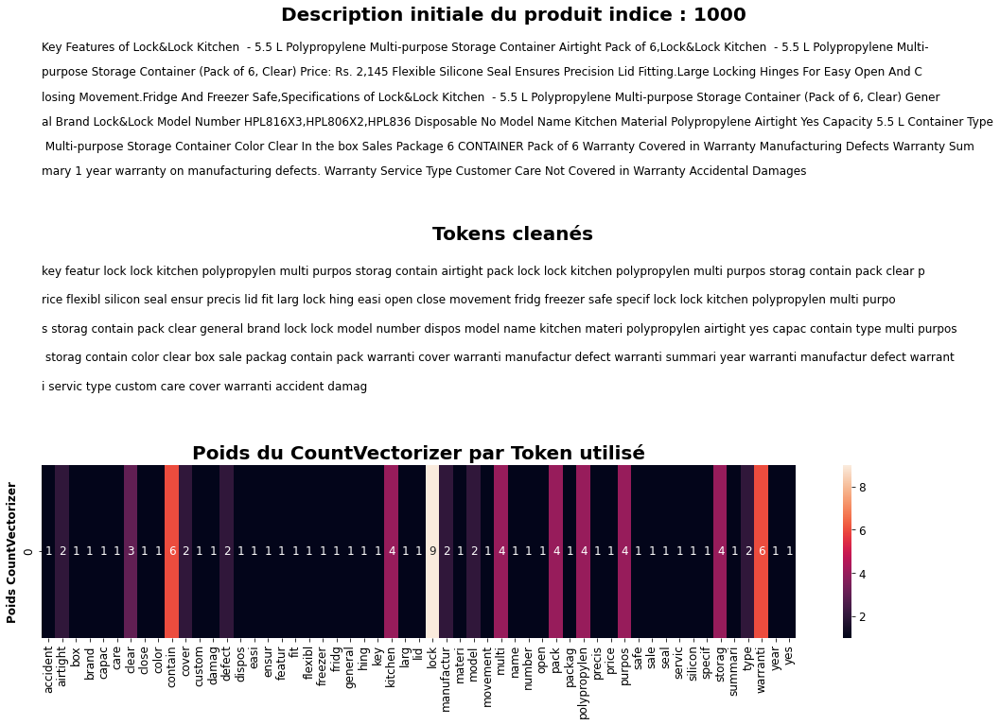

In [110]:
#Affichage des poids du countvectorizer du 1000ième individu

cv_random_displayer(cv_matrix, 1000)

In [290]:
#Tri des idividus par catégorie et mise en mémoire de la liste des catégories

final_df = final_df.sort_values(by = 'categs')
categories = final_df['categs'].values

#Remise en place du Count Vectorizer avec les valeurs triées

cvect = CountVectorizer(ngram_range = (1,1))
cv_fit = cvect.fit(final_df['count_vectorizer_cleaned'].values)
cv_transform = cvect.fit_transform(final_df['count_vectorizer_cleaned'].values)
cv_matrix = pd.DataFrame(cv_transform.toarray(), columns = cvect.get_feature_names_out())

  A l'aide des features extraits grâce au count-vectorizer, nous pouvons effectuer une analyse exploratoire de ce jeu de données, et effectuer une réduction dimensionnelle, suivie d'un clustering.

  Notre idée sera par la suite de mesurer l'adjusted ranom index entre nos différents clusters, et les catégories réelles auxquelles appartiennent les descriptions.

In [112]:
#Latent Dirichelet Allocation sur le jeu de données

lda_cvect, cvect_lda_df = LDA_reductor(cv_matrix, 7)
cvect_lda_df.sample(3)

,0,1,2,3,4,5,6
95,0.001135,0.875304,0.001140,0.119013,0.001134,0.001134,0.001139
788,0.007937,0.007938,0.007939,0.007942,0.007937,0.007938,0.952368
821,0.001832,0.001845,0.001840,0.967773,0.001832,0.001832,0.023047


In [113]:
#Affichage des 10 principaux tokens par Topic identifié par le LDA

display_topics(lda_cvect, cvect.get_feature_names(), 20)

Topic 0:
skin oil blanket use tea plant extract mink essenti tree keep organ anti bazaar fragranc aroma price seed allin variant


Topic 1:
babi girl cotton fabric detail boy print general dress specif pattern ideal sleev pack sale packag neck color content number


Topic 2:
mug warranti coffe qualiti laptop ceram power design usb perfect adapt batteri gift also product cover light price love replac


Topic 3:
design price materi featur home pack beauti gift make use specif come wall give inch color towel size perfect ceram


Topic 4:
vacuum comput scissor brush attach clean cabl dust brow learn cleaner chef simpli connect keyboard complet help rubber bristl side


Topic 5:
shower cap marbl purpl handicraft escort inlaid cranberri utsav recrafto flavor hookah mantra atm raini thank flaunt street worn timepiec


Topic 6:
product free buy ship deliveri cash genuin day watch replac guarante flipkart com onlin analog men india great price discount




PCA -- Nombre de dimensions initiales : 3787
PCA -- Nombre de composantes principales : 522
----------

TSNE -- Essais de 6 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 120
----------



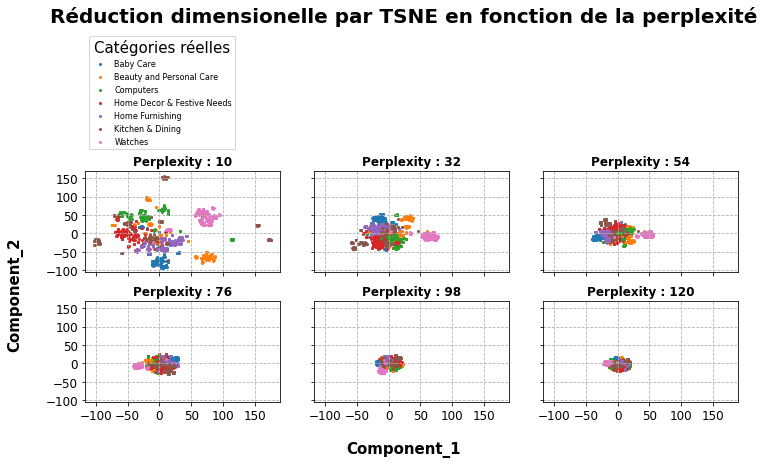

In [114]:
#Essai de la fonction TSNE_perplexity_tuner_mapped sur le jeu de données

TSNE_perplexity_tuner_mapped(cv_matrix, 0.99, 10, 120, 6, categories)

TruncatedSVD -- Nombre de dimensions initiales : 3787
TruncatedSVD -- Nombre de composantes principales : 522
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.358
Perplexité : 20 - ARI : 0.391
Perplexité : 30 - ARI : 0.418
Perplexité : 40 - ARI : 0.408
Perplexité : 50 - ARI : 0.393
Perplexité : 60 - ARI : 0.395
Perplexité : 70 - ARI : 0.352
Perplexité : 80 - ARI : 0.361
Perplexité : 90 - ARI : 0.347
Perplexité : 100 - ARI : 0.372
Meilleur perplexité : 30
Adjusted Random Index : 0.420


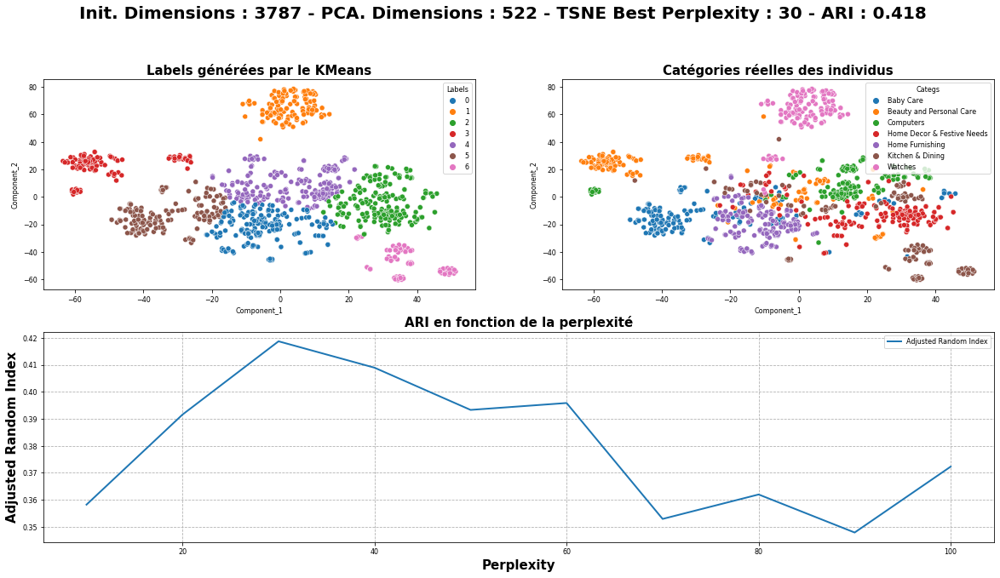

In [115]:
#Recherche de la meilleur perplexité pour le TSNE par recherche sur grille

cv_ari_sparse, cv_best_perp_sparse = PCA_TSNE_ARI_tuner_KM(cv_matrix, 0.99, 10, 100, 10, 7, categories, True, False)

PCA -- Nombre de dimensions initiales : 3787
PCA -- Nombre de composantes principales : 522
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.367
Perplexité : 20 - ARI : 0.393
Perplexité : 30 - ARI : 0.481
Perplexité : 40 - ARI : 0.445
Perplexité : 50 - ARI : 0.409
Perplexité : 60 - ARI : 0.421
Perplexité : 70 - ARI : 0.423
Perplexité : 80 - ARI : 0.357
Perplexité : 90 - ARI : 0.374
Perplexité : 100 - ARI : 0.360
Meilleur perplexité : 30
Adjusted Random Index : 0.481


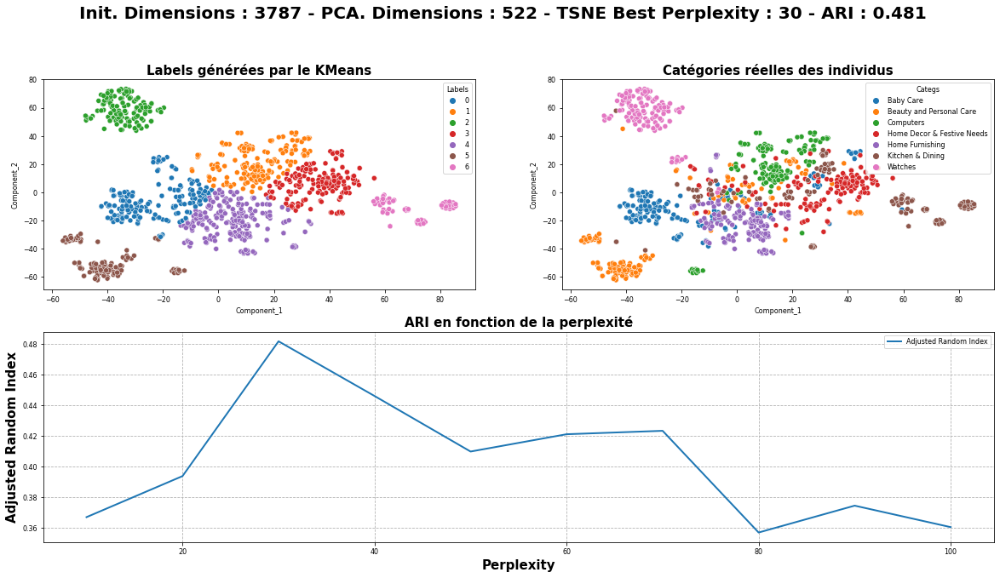

In [116]:
#Recherche de la meilleur perplexité pour le TSNE par recherche sur grille

cv_ari, cv_best_perp = PCA_TSNE_ARI_tuner_KM(cv_matrix, 0.99, 10, 100, 10, 7, categories, False, False)

Nous pouvons également effectuer une mesure de similarité entre nos différents individus en nous servant du jeu de données cv_matrix.

Pour cela, nous allons nous servir de la cosine similarity de la librairie statsmodels.

In [117]:
#Mise en place de la matrice de similarité entre les individus

cosine_matrix_cv = cosine_similarity_maker(cv_matrix, categories)
cosine_matrix_cv.sample(3)

,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,...,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches
Watches,0.416954,0.0,0.0,0.0,0.000000,0.000000,0.040249,0.007534,0.040249,0.0,...,0.645497,0.738549,0.615457,0.629941,0.755929,0.615457,0.629941,0.601929,0.721688,0.629941
Kitchen & Dining,0.448276,0.0,0.0,0.0,0.011864,0.010131,0.036616,0.020562,0.036616,0.0,...,0.322971,0.307941,0.307941,0.315188,0.315188,0.307941,0.315188,0.301172,0.361093,0.315188
Computers,0.515026,0.0,0.0,0.0,0.000000,0.000000,0.032813,0.010237,0.032813,0.0,...,0.526235,0.501745,0.501745,0.513553,0.513553,0.501745,0.513553,0.490716,0.588348,0.513553


Text(0.5, 1.0, 'Cosine Similarity entre les individus: \n Espace de redescription du CountVectorizer')

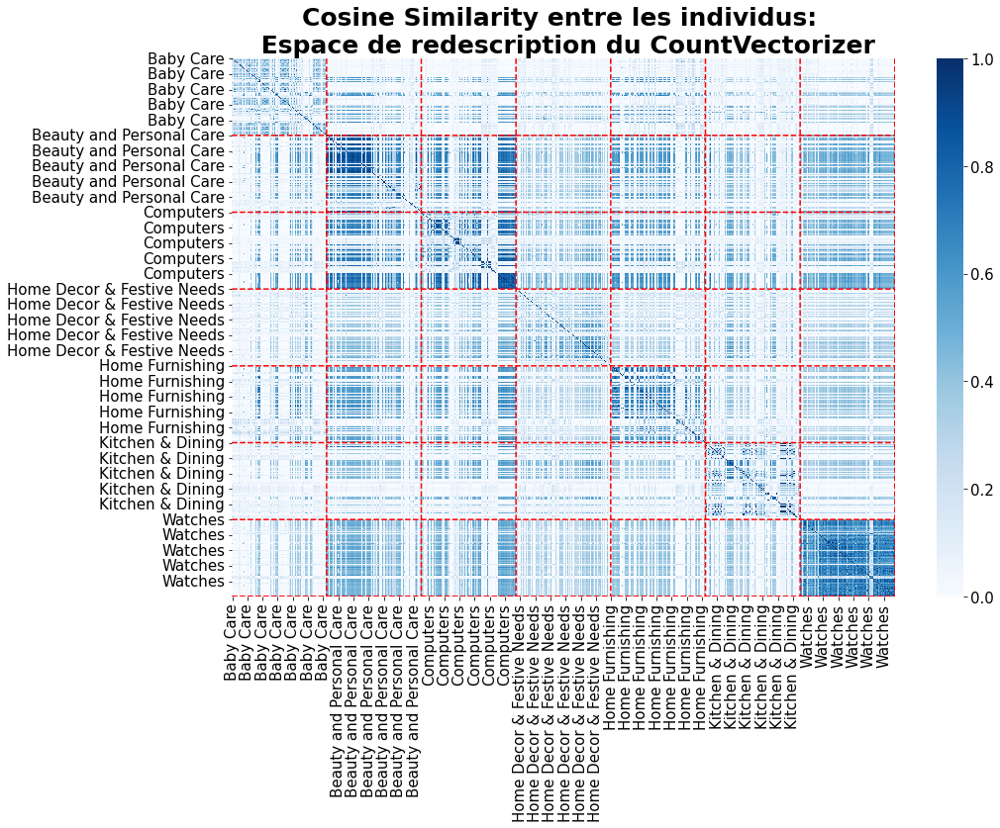

In [118]:
#Affichage de la matrice de similarités

plt.rcParams.update({'font.size' : 15})
plt.figure(figsize = (15,10))
sns.heatmap(cosine_matrix_cv, cmap = 'Blues')
for i in range(7):
    plt.plot(np.full((1050), (i + 1)*150), np.linspace(0, 1050, 1050), color = 'red', ls = '--')
    plt.plot(np.linspace(0, 1050, 1050), np.full((1050), (i + 1)*150), color = 'red', ls = '--')
plt.title('Cosine Similarity entre les individus: \n Espace de redescription du CountVectorizer', size = 25, weight = 'bold')

In [119]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_cv = confusion_matrice_maker(cv_matrix, cv_best_perp, 0.99, 7, categories)

PCA -- Nombre de dimensions initiales : 3787
PCA -- Nombre de composantes principales : 522
---------
TSNE - perplexité : 30
---------
KM - Nombre de clusters : 7


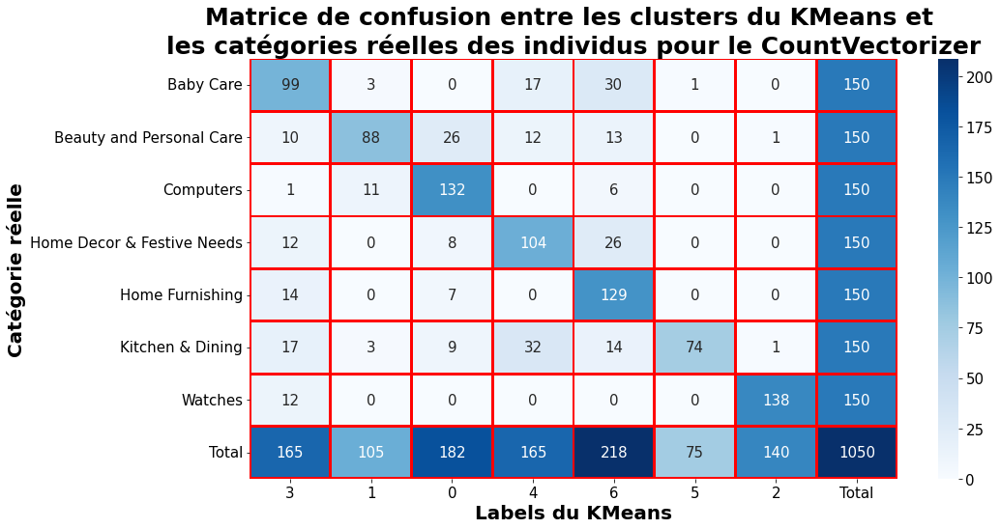

In [120]:
#Affichage de la matrice de confusion

confusion_matrix_displayer(confusion_matrix_cv, 'CountVectorizer')

Enfin, nous pouvons essayer un classfier simple composé d'une seule couche fully-connected, avec une activation softmax, et une sortie de forme (None, 7).

Afin d'améliorer les performances de ce classifier, nous éffectuons une réduction dimensionnelle par PCA de manière à conserver 99% de la variance (sans méthode du coude pour déterminer le nombre de composantes principales pour l'exemple).

In [291]:
#Importation de librairies supplémentaires

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow import keras
from keras.layers import Dense
from keras.utils import to_categorical
from keras import Sequential
from keras.layers import Input
from keras import optimizers
from tensorflow.keras import regularizers

In [292]:
#Fonction d'affichage de la courbe de la loss et de la loss en validation

def plot_loss(history):
    fig, axes = plt.subplots(1, 2, figsize = (15,5))
    for i, ax in zip(range(2), axes.ravel()):
        if i == 0:    
            ax.plot(history.history['loss'], label='loss', color = 'blue')
            ax.plot(history.history['val_loss'], label='val_loss', color = 'red')
            ax.set_xlabel('Epoch')
            ax.set_ylabel('Error [MPG]')
            ax.legend()
            ax.set_title('Validation et Training Loss du modèle par Epoch', size = 15, weight = 'bold')
            ax.grid(True)
        else:
            ax.plot(history.history['categorical_accuracy'], label='categorical_accuracy', color = 'blue')
            ax.plot(history.history['val_categorical_accuracy'], label='val_categorical_accuracy', color = 'red')
            ax.set_xlabel('Epoch')
            ax.set_ylabel('Categorical Accuracy]')
            ax.legend()
            ax.set_title('Validation et Training Accuracy du modèle par Epoch', size = 15, weight = 'bold')
            ax.grid(True) 

In [300]:
#Pré-traitement des données et préparation du classifier

lab = LabelEncoder()
labeled = lab.fit_transform(categories)
X_train, X_test, y_train, y_test = train_test_split(cv_matrix, labeled, test_size = 0.2, stratify = categories)

pca_cv = PCA(n_components = 0.99)
X_train = pca_cv.fit_transform(X_train)
X_test = pca_cv.transform(X_test)

y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

cv_classifier = Sequential()
cv_classifier.add(Input(shape = (X_train.shape[1])))
cv_classifier.add(Dense(7, activation = 'Softmax', kernel_regularizer=regularizers.L1L2(l1=1e-5, l2=1e-4), bias_regularizer=regularizers.L2(1e-4), activity_regularizer=regularizers.L2(1e-5)))
cv_classifier.summary()


Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 7)                 3073      
                                                                 
Total params: 3,073
Trainable params: 3,073
Non-trainable params: 0
_________________________________________________________________


In [301]:
# Compiler le modèle 
cv_classifier.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True), optimizer=optimizers.Adam(learning_rate=0.0001), metrics=['categorical_accuracy'])

# Entraîner sur les données d'entraînement (X_train, y_train)
history = cv_classifier.fit(X_train, y_train, epochs=500, batch_size=10, verbose=1, validation_split = 0.1)

Epoch 1/500
76/76 [==============================] - 1s 5ms/step - loss: 2.0846 - categorical_accuracy: 0.1693 - val_loss: 2.0455 - val_categorical_accuracy: 0.1786
Epoch 2/500
76/76 [==============================] - 0s 3ms/step - loss: 2.0333 - categorical_accuracy: 0.1958 - val_loss: 2.0094 - val_categorical_accuracy: 0.1905
Epoch 3/500
76/76 [==============================] - 0s 3ms/step - loss: 1.9845 - categorical_accuracy: 0.2130 - val_loss: 1.9745 - val_categorical_accuracy: 0.2143
Epoch 4/500
76/76 [==============================] - 0s 3ms/step - loss: 1.9369 - categorical_accuracy: 0.2407 - val_loss: 1.9398 - val_categorical_accuracy: 0.2262
Epoch 5/500
76/76 [==============================] - 0s 3ms/step - loss: 1.8906 - categorical_accuracy: 0.2910 - val_loss: 1.9053 - val_categorical_accuracy: 0.2381
Epoch 6/500
76/76 [==============================] - 0s 3ms/step - loss: 1.8450 - categorical_accuracy: 0.3214 - val_loss: 1.8721 - val_categorical_accuracy: 0.2738
Epoch 7/50

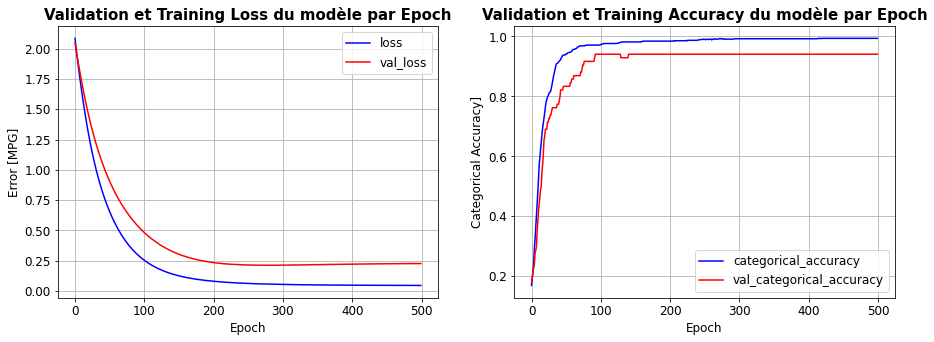

In [302]:
#Affichage de la loss et de l'accuracy en fonction de l'epoch

plot_loss(history)

In [303]:
#Mesure de la categorical crossentropy sur le jeu de données de test

y_pred = cv_classifier.predict(X_test)
CatAcc = tf.keras.metrics.CategoricalAccuracy()
CatAcc.update_state(y_test, y_pred)
print('Categorical Accuracy sur le jeu de données de test : {}'.format(str(CatAcc.result().numpy())[:5]))

7/7 [==============================] - 0s 2ms/step
Categorical Accuracy sur le jeu de données de test : 0.9


  A ce stade, nous avons des résultats intéressants en effectuant une réduction dimensionnelle sur notre jeu de données, et en effectuant un clustering.
    
  Néanmoins, ce jeu de données à été mis en place en utilisant la fonction mid-cleaning, ne tenant pas en compte la fréquence d'apparition des tokens dans le corpus global de desciptions. 
    
  Nous pouvons essayer d'effectuer les même opérations sur un dataFrame généré en utilisant le jeu de données entièrement cleané.

In [128]:
#Application de la seconde fonction de cleaning

final_df['count_vectorizer_full_cleaned'] = final_df['description'].swifter.apply(lambda x : final_cleaning(x, raw_corpus, 20, 300))

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

In [129]:
#Mise en place du count_vectorizer sur le jeu de données totalement cleané

cvect_full = CountVectorizer()
cv_fit2 = cvect_full.fit(final_df['count_vectorizer_full_cleaned'])
cv_transform2 = cvect_full.transform(final_df['count_vectorizer_full_cleaned'])
cv_matrix2 = pd.DataFrame(cv_transform2.toarray(), columns = cvect_full.get_feature_names_out())
cv_matrix2.sample(5)

,abstract,accessori,actual,adapt,add,addit,adhes,ador,afford,age,...,women,wood,wooden,work,would,wrap,year,yellow,yes,yet
568,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
387,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
973,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,0,0
548,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
93,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [130]:
#Latent Dirichelet Allocation sur le jeu de données

lda_cvect_full, cvect_full_lda_df = LDA_reductor(cv_matrix2, 7)
cvect_full_lda_df.sample(3)

,0,1,2,3,4,5,6
656,0.028676,0.028575,0.028669,0.028697,0.028596,0.028574,0.828213
1013,0.376162,0.004001,0.004071,0.003981,0.168601,0.231083,0.212102
802,0.002074,0.002076,0.372122,0.567233,0.052344,0.002071,0.002081


In [131]:
#Affichage des 10 principaux tokens par Topic identifié par le LDA

display_topics(lda_cvect_full, cvect_full.get_feature_names(), 20)

Topic 0:
analog men india great discount showpiec dial women strap water resist maxima best round gold sonata black case clasp brass


Topic 1:
skin combo towel bottl bath soft soap water size easi shape bodi cotton gift wrap nutcas wash print ceram mous


Topic 2:
ceram coffe perfect gift one love make safe give rockmantra craft get also pizza microwav tea enjoy dishwash ensur bring


Topic 3:
use qualiti light wall warranti high home brand made decor steel hair room clean easi model size box look general


Topic 4:
girl boy cotton detail fabric dress ideal print general pattern sleev neck wash packag sale content casual number blue occas


Topic 5:
laptop warranti usb power adapt batteri led qualiti charger light vaio vgn smartpro includ pleas cover best cell brand fan


Topic 6:
inch box packag sale print model number cover dimens general width multicolor brand key height cotton cushion polyest content name




PCA -- Nombre de dimensions initiales : 471
PCA -- Nombre de composantes principales : 264
----------

TSNE -- Essais de 6 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 120
----------



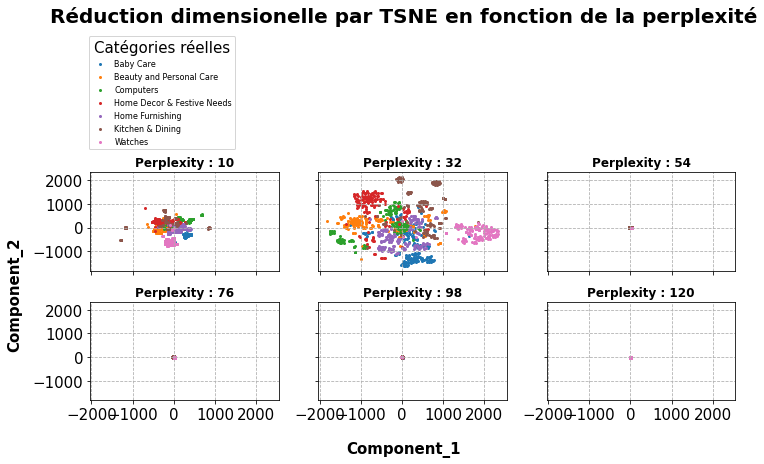

In [132]:
#Essais de différentes valeurs de perplexités pour le TSNE

TSNE_perplexity_tuner_mapped(cv_matrix2, 0.99, 10, 120, 6, categories)

TruncatedSVD -- Nombre de dimensions initiales : 471
TruncatedSVD -- Nombre de composantes principales : 263
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.365
Perplexité : 20 - ARI : 0.383
Perplexité : 30 - ARI : 0.345
Perplexité : 40 - ARI : 0.351
Perplexité : 50 - ARI : 0.429
Perplexité : 60 - ARI : 0.305
Perplexité : 70 - ARI : 0.328
Perplexité : 80 - ARI : 0.350
Perplexité : 90 - ARI : 0.330
Perplexité : 100 - ARI : 0.334
Meilleur perplexité : 50
Adjusted Random Index : 0.430


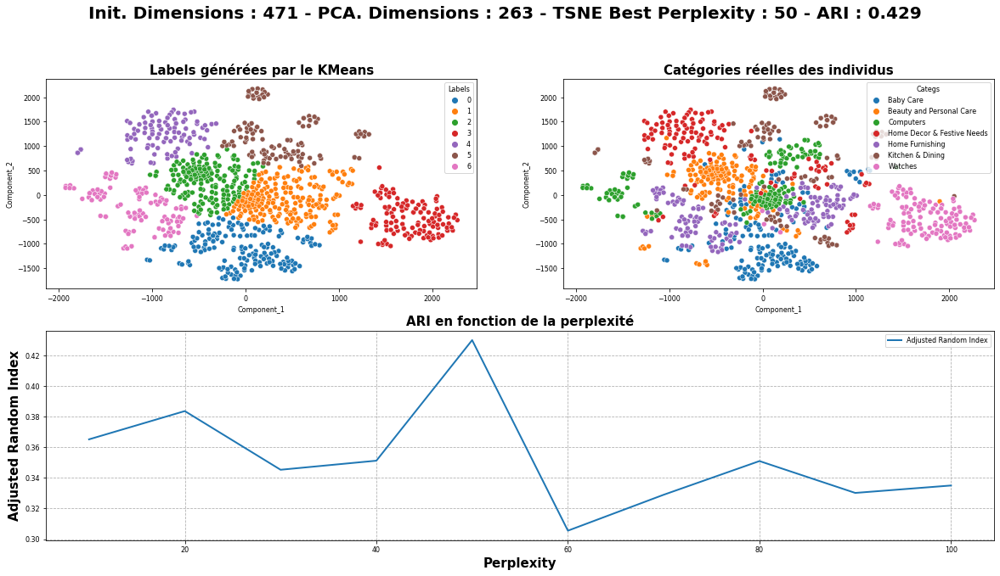

In [133]:
#Recherche de la meilleur perplexité pour le clustering et mesure de l'ARI

ari_cv2, best_perp_cv2 = PCA_TSNE_ARI_tuner_KM(cv_matrix2, 0.99, 10, 100, 10, 7, categories, True, False)

In [134]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_cv2 = confusion_matrice_maker(cv_matrix2, best_perp_cv2, 0.99, 7, categories)

PCA -- Nombre de dimensions initiales : 471
PCA -- Nombre de composantes principales : 264
---------
TSNE - perplexité : 50
---------
KM - Nombre de clusters : 7


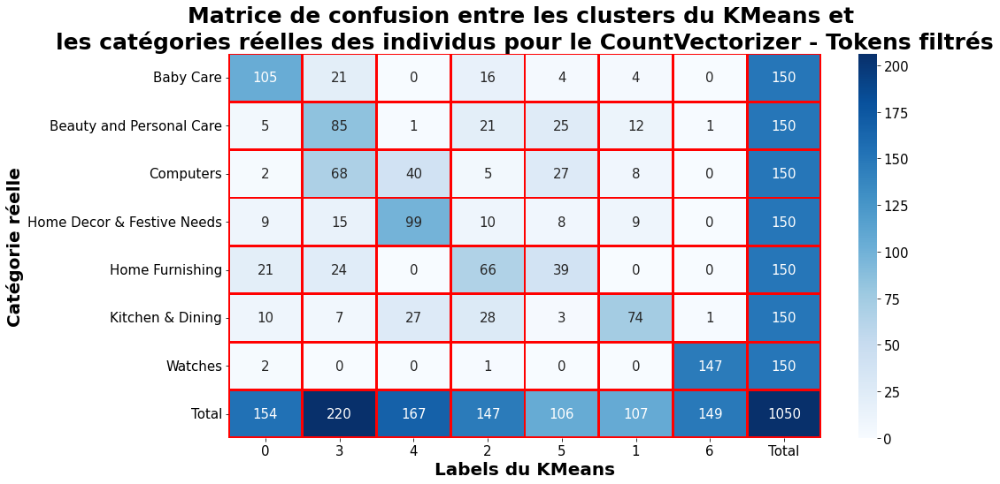

In [135]:
#Affichage de la matrice de confusion

confusion_matrix_displayer(confusion_matrix_cv2, 'CountVectorizer - Tokens filtrés')

Dans le cas du CountVectorizer, nous avons de meilleurs résultats sans filtrer les tokens en fonction de leur fréquence d'apparition dans le jeu de données.

En réalité, cela est fortement lié à la réduction dimensionnelle par PCA. 

En effet, les tokens les plus et moins représentés dans le jeu de données sont également ceux pour lesquels nous avons une variance plus faible que les autres. Ainsi, ils seront moins pré-pondérants dans la création des axes d'inerties principaux.

## 5.4- TF-IDF

   Dans le cas du TF-IDF, nous n'utiliserons que les tokens générés par la première fonction de nettoyage des descriptions, sans filtrer les tokens en fonction de leur fréquence.

In [304]:
#Importation des librairies supplémentaires

from sklearn.feature_extraction.text import TfidfVectorizer

In [305]:
#Mise en place du tfidf-vectorizer et affichage d'une partie du vocabulaire avec les fréquences

ctf = TfidfVectorizer()
ctf_fit = ctf.fit(final_df['count_vectorizer_cleaned'])
tfidf_matrix = pd.DataFrame(ctf.transform(final_df['count_vectorizer_cleaned']).toarray(), columns = ctf.get_feature_names_out())
tfidf_vocab = pd.DataFrame({'Tokens' : ctf.vocabulary_.keys(), 'Frequencies' : ctf.vocabulary_.values()})
tfidf_vocab = tfidf_vocab.sort_values(by = 'Frequencies', ascending = False)
tfidf_vocab.sample(10)

,Tokens,Frequencies
1741,everlast,1124
1819,laptop,1847
3271,establish,1110
2272,comprehens,690
3432,introduc,1702
2845,infin,1658
3241,cooker,732
2351,mytholog,2200
2590,ecraftindia,1030
2379,antiqu,137


In [138]:
#Somme des lignes de la matrice tf-idf

tfidf_matrix.sample(3)

,aaa,aapno,aari,aarika,abil,abl,abod,abras,abroad,absolut,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
281,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
514,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
345,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [139]:
#Latent Dirichelet Allocation sur le jeu de données

lda_tfidf, tfidf_lda_df = LDA_reductor(tfidf_matrix, 7)
tfidf_lda_df.sample(3)

,0,1,2,3,4,5,6
45,0.032985,0.032984,0.032987,0.801629,0.032984,0.032984,0.033446
963,0.025179,0.025179,0.025179,0.848899,0.025179,0.025179,0.025206
1041,0.023996,0.023996,0.023996,0.856012,0.023996,0.023996,0.024009


In [140]:
#Affichage des 20 principaux tokens par Topic identifié par le LDA sur le jeu de données tfidf

display_topics(lda_tfidf, ctf_fit.get_feature_names(), 20)

Topic 0:
waiter pedrini corkscrew knife steel babi price tree boy beauti wrap oil jumpsuit tribal skin fern tea group intex rang


Topic 1:
babi detail neck boy sleev fabric girl cotton com flipkart ideal pattern short print brand solid offer dress pyjama casual


Topic 2:
brow makeup goldencollect jewelleri pouch vaniti sticker kit almond papaya mxofer honey soap gir arch elf ash wallmantra sexi jasmin


Topic 3:
watch com flipkart analog genuin cash ship deliveri buy free product guarante replac men day onlin discount india great maxima


Topic 4:
pine help stimul furthermor cough gout bronchiti pain sexual arthriti circul oil sick muscular rheumat mental catarrh effect breathless asthma


Topic 5:
mxofer soap kit aloevera rose papaya jasmin almond honey facewash lemon cranberri mixfruit overwhelm everytim mix lavend excel tast sweet


Topic 6:
mug design babi pack featur color specif detail print cotton materi girl price ceram box type inch general packag gift




PCA -- Nombre de dimensions initiales : 3787
PCA -- Nombre de composantes principales : 770
----------

TSNE -- Essais de 6 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 120
----------



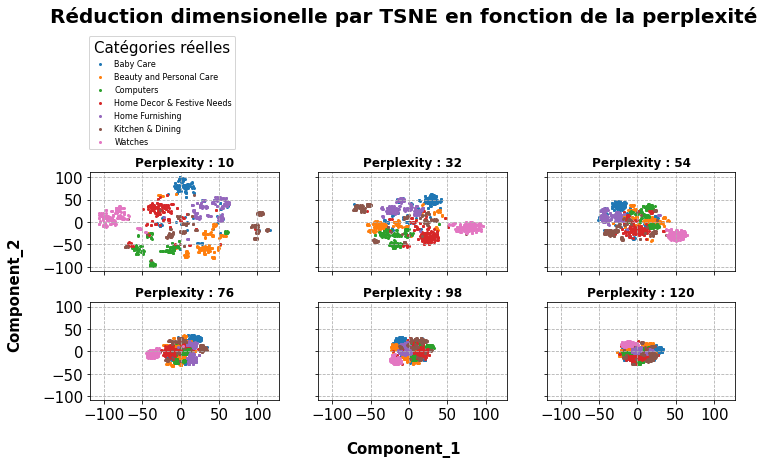

In [141]:
#Scatterplots TSNE en fonction de la perplexité

TSNE_perplexity_tuner_mapped(tfidf_matrix, 0.99, 10, 120, 6, categories)

TruncatedSVD -- Nombre de dimensions initiales : 3787
TruncatedSVD -- Nombre de composantes principales : 770
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.618
Perplexité : 20 - ARI : 0.509
Perplexité : 30 - ARI : 0.431
Perplexité : 40 - ARI : 0.440
Perplexité : 50 - ARI : 0.435
Perplexité : 60 - ARI : 0.457
Perplexité : 70 - ARI : 0.408
Perplexité : 80 - ARI : 0.371
Perplexité : 90 - ARI : 0.382
Perplexité : 100 - ARI : 0.366
Meilleur perplexité : 10
Adjusted Random Index : 0.616


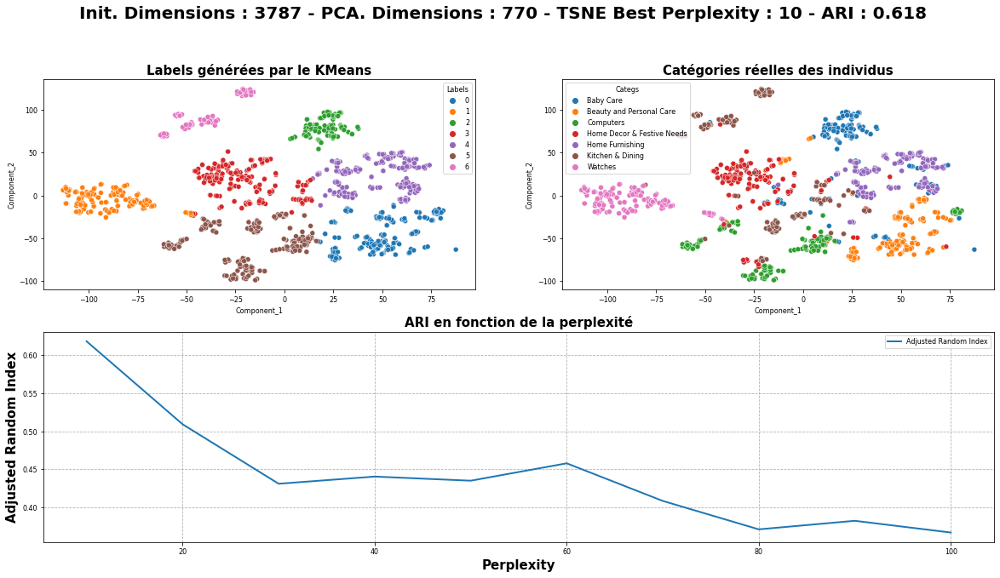

In [142]:
#Recherche de la meilleur perplexité pour le clustering et mesure de l'ARI avec réduction dimensionnelle initiée par TruncatedSVD

ari_tfidf_sparse, best_perp_tfidf_sparse = PCA_TSNE_ARI_tuner_KM(tfidf_matrix, 0.99, 10, 100, 10, 7, categories, True, False)

PCA -- Nombre de dimensions initiales : 3787
PCA -- Nombre de composantes principales : 770
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.615
Perplexité : 20 - ARI : 0.536
Perplexité : 30 - ARI : 0.441
Perplexité : 40 - ARI : 0.377
Perplexité : 50 - ARI : 0.379
Perplexité : 60 - ARI : 0.429
Perplexité : 70 - ARI : 0.388
Perplexité : 80 - ARI : 0.395
Perplexité : 90 - ARI : 0.426
Perplexité : 100 - ARI : 0.414
Meilleur perplexité : 10
Adjusted Random Index : 0.616


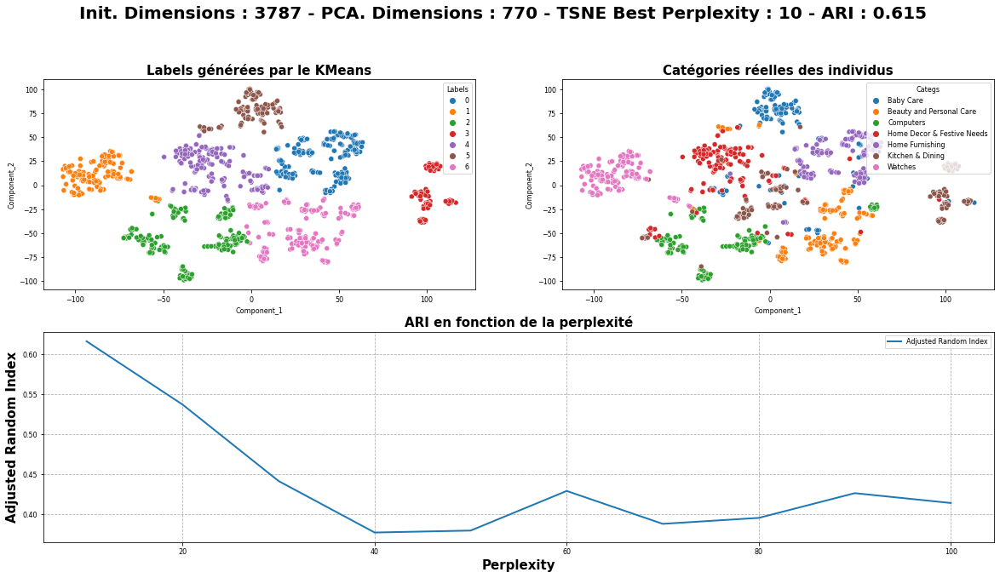

In [143]:
#Recherche de la meilleur perplexité pour le clustering et mesure de l'ARI avec réduction dimensionnelle initiée par PCA

ari_tfidf, best_perp_tfidf = PCA_TSNE_ARI_tuner_KM(tfidf_matrix, 0.99, 10, 100, 10, 7, categories, False, False)

In [144]:
#Mise en place de la matrice de similarité entre les individus

cosine_matrix_tfidf = cosine_similarity_maker(tfidf_matrix, categories)
cosine_matrix_tfidf.sample(3)

,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,...,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches
Computers,0.058775,0.010806,0.013049,0.099726,0.001266,0.001132,0.005055,0.015752,0.005050,0.000000,...,0.048237,0.047121,0.046243,0.044327,0.042661,0.045336,0.049711,0.041834,0.058216,0.045864
Kitchen & Dining,0.011377,0.016579,0.020021,0.027242,0.038625,0.021286,0.030445,0.031687,0.030414,0.026401,...,0.009581,0.009360,0.009185,0.008805,0.008474,0.009005,0.009874,0.008309,0.011563,0.009110
Computers,0.090016,0.000000,0.000000,0.000000,0.000000,0.000000,0.005315,0.001359,0.005309,0.000000,...,0.125033,0.122140,0.119864,0.114897,0.110579,0.117512,0.128852,0.108435,0.150898,0.118883


Text(0.5, 1.0, 'Cosine Similarity entre les individus: \n Espace de redéscription du TF-IDF')

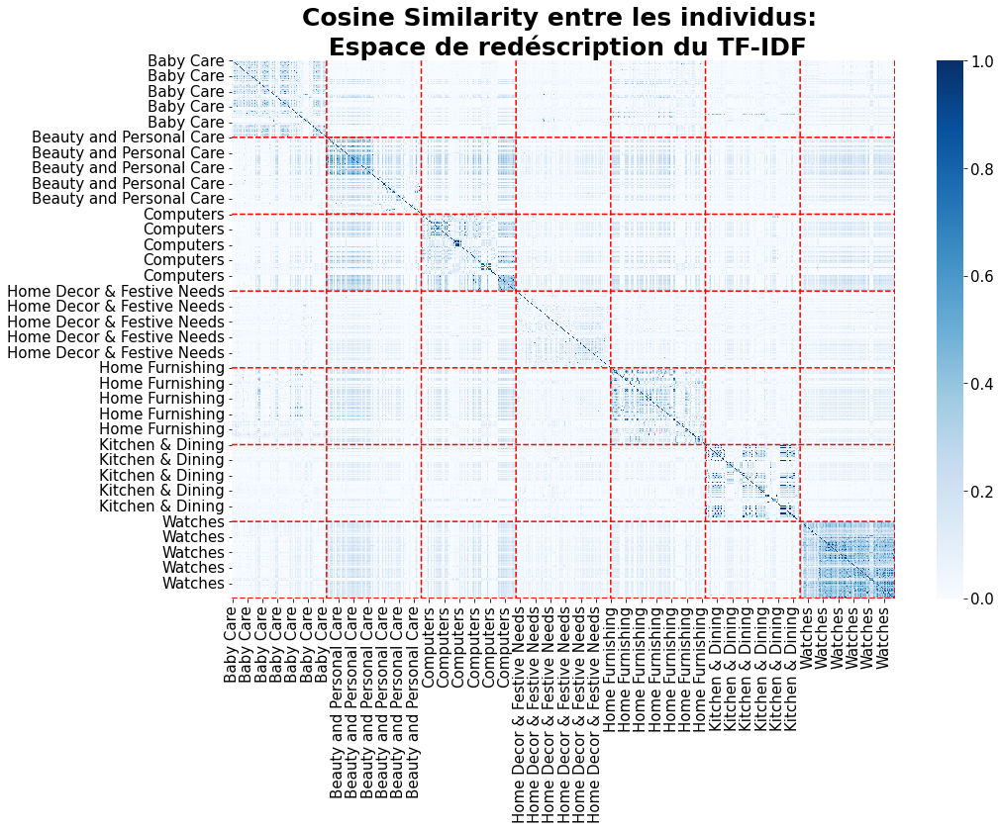

In [145]:
#Affichage de la matrice de similarités pour le TF-IDF

plt.rcParams.update({'font.size' : 15})
plt.figure(figsize = (15,10))
sns.heatmap(cosine_matrix_tfidf, cmap = 'Blues')
for i in range(7):
    plt.plot(np.full((1050), (i + 1)*150), np.linspace(0, 1050, 1050), color = 'red', ls = '--')
    plt.plot(np.linspace(0, 1050, 1050), np.full((1050), (i + 1)*150), color = 'red', ls = '--')
plt.title('Cosine Similarity entre les individus: \n Espace de redéscription du TF-IDF', size = 25, weight = 'bold')

In [146]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_tfidf = confusion_matrice_maker(tfidf_matrix, best_perp_tfidf, 0.99, 7, categories)

PCA -- Nombre de dimensions initiales : 3787
PCA -- Nombre de composantes principales : 770
---------
TSNE - perplexité : 10
---------
KM - Nombre de clusters : 7


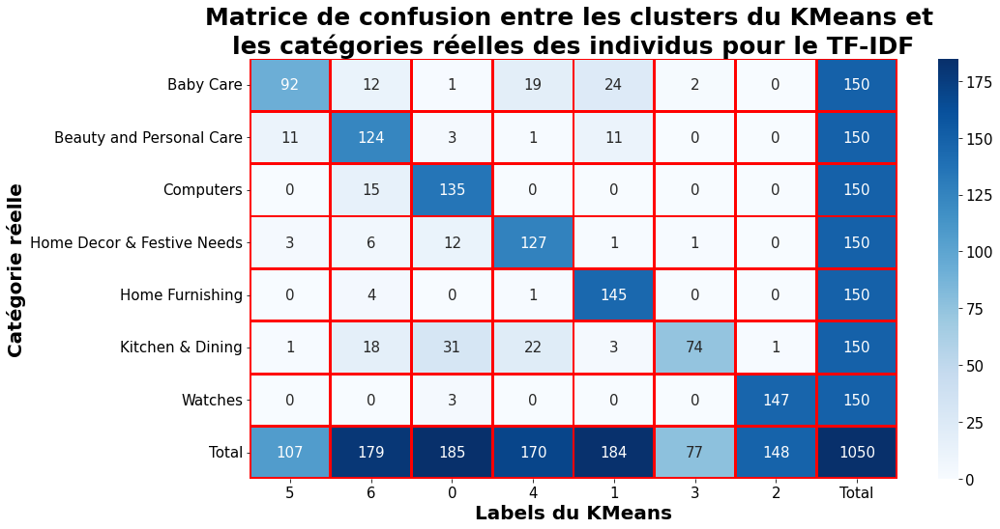

In [147]:
#Affichage de la matrice de confusion

confusion_matrix_displayer(confusion_matrix_tfidf, 'TF-IDF')

  De la même manière, nous pouvons mettre en place un classifier de manière à avoir une idée de l'éfficacité d'un classifier sur notre jeu de données.

In [307]:
#Préparation du modèle

pca_tfidf = PCA(n_components = 0.99)
X_train, X_test, y_train, y_test = train_test_split(tfidf_matrix, labeled, test_size = 0.2, stratify = categories)

X_train = pca_tfidf.fit_transform(X_train)
X_test = pca_tfidf.transform(X_test)
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

tfidf_classifier = Sequential()
tfidf_classifier.add(Input(shape = (X_train.shape[1])))
tfidf_classifier.add(Dense(7, activation = 'Softmax', kernel_regularizer=regularizers.L1L2(l1=1e-5, l2=1e-4), bias_regularizer=regularizers.L2(1e-4), activity_regularizer=regularizers.L2(1e-5)))
tfidf_classifier.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 7)                 4473      
                                                                 
Total params: 4,473
Trainable params: 4,473
Non-trainable params: 0
_________________________________________________________________


In [308]:
# Compiler le modèle 
tfidf_classifier.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True), 
                         optimizer=optimizers.Adam(learning_rate=0.001), metrics=['categorical_accuracy'])

# Entraîner sur les données d'entraînement (X_train, y_train)
history_tfidf = tfidf_classifier.fit(X_train, y_train, epochs=500, batch_size=10, verbose=1, validation_split = 0.1)

Epoch 1/500
76/76 [==============================] - 1s 5ms/step - loss: 1.9325 - categorical_accuracy: 0.2553 - val_loss: 1.9042 - val_categorical_accuracy: 0.4524
Epoch 2/500
76/76 [==============================] - 0s 3ms/step - loss: 1.8900 - categorical_accuracy: 0.5066 - val_loss: 1.8752 - val_categorical_accuracy: 0.5833
Epoch 3/500
76/76 [==============================] - 0s 3ms/step - loss: 1.8498 - categorical_accuracy: 0.7262 - val_loss: 1.8474 - val_categorical_accuracy: 0.7381
Epoch 4/500
76/76 [==============================] - 0s 3ms/step - loss: 1.8104 - categorical_accuracy: 0.8426 - val_loss: 1.8190 - val_categorical_accuracy: 0.7976
Epoch 5/500
76/76 [==============================] - 0s 3ms/step - loss: 1.7713 - categorical_accuracy: 0.9048 - val_loss: 1.7916 - val_categorical_accuracy: 0.8571
Epoch 6/500
76/76 [==============================] - 0s 3ms/step - loss: 1.7331 - categorical_accuracy: 0.9405 - val_loss: 1.7642 - val_categorical_accuracy: 0.8690
Epoch 7/50

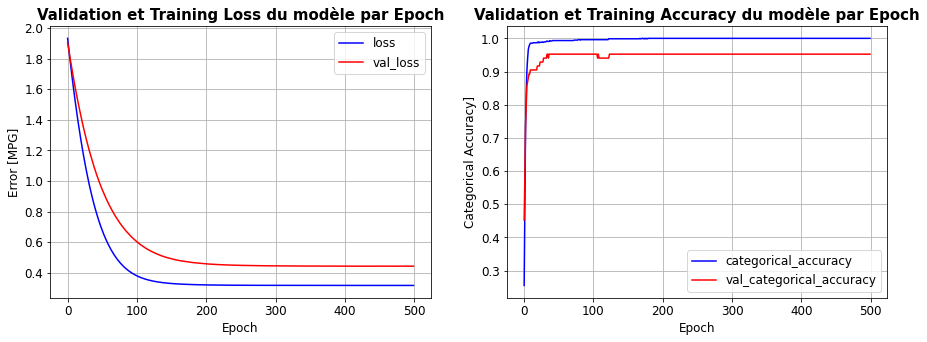

In [309]:
#Mesure de la loss à l'entraînement et en validation

plot_loss(history_tfidf)

In [310]:
#Mesure de la categorical accuracy sur le jeu de données de test

y_pred = tfidf_classifier.predict(X_test)
CatAcc = tf.keras.metrics.CategoricalAccuracy()
CatAcc.update_state(y_test, y_pred)
print('Categorical Accuracy sur le jeu de données de test : {}'.format(str(CatAcc.result().numpy())[:5]))

7/7 [==============================] - 0s 2ms/step
Categorical Accuracy sur le jeu de données de test : 0.933


## 5.5- Word2Vec

  A présent, nous pouvons passer à des méthodes de Word Embedding, (Words to Vectors), pour lesquelles l'idée est de redécrire les différents tokens dans un espace vectoriel de dimension fixée (par exemple 300 dans le cas du Word2Vec par la suite, et la taille du vocabulaire en lignes).

  Dans ce nouvel espace de redéscription, l'idée est que deux Tokens ont un sens d'autant plus proche qu'ils sont proches dans ce nouvel espace. Pour cela, nous nous servont du contexte dans lequel les Tokens sont utilisés, i.e. les Tokens dans le voisinage direct (pris en définissant une fenêtre de taille fixe, par exemple 5 ici).

  Ainsi, deux Tokens ayant des sens similaires seront utilisés dans des contextes similaires, et seront proches dans l'epace de redescription. En appliquant ce plongement de mots à chaque token d'une description données, nous pouvons décrire chaque description dans un espace vectoriel de dimenssions (taille de la mattrice d'embedding, longueur maximale des phrases), auquel nous appliquont un GlobalAvergaePooling pour saisir mathématiquement le sens moyen des descriptions dans un espace de dimensions 300, et interpréter la proximité de deux descriptions dans cette espace par la proximité en terme de sens.

In [107]:
#Importation de librairies supplémentaires

#Importation des fonction de préprocessing de texte
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
#from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.models import Model

#Importation du WordNetLemmatizer et du Word2Vec depuis Gensim
from nltk.stem import WordNetLemmatizer
import gensim
from gensim.models import Word2Vec

#Importation de layers Keras pour la mise en place du features Extractor
from keras.layers import Embedding
from keras.layers import GlobalAveragePooling1D
from keras.layers import AveragePooling1D
from keras.layers import MaxPooling1D
from keras.layers import Flatten
from keras.layers import Input

  En ce qui concerne le Word2Vec, nous définissons une nouvelle fontion de nettoyage, plus adaptée au fonctionnement de l'algorithme. Nous utiliserons toujours le RegExp Tokenizer de manière à obtenir un token par mot, en supprimant les éléments de ponctuation (inutiles dans le contexte de chaque mot pour notre problème, mais qui serait utilise pour de la clasification de sentiments pour des tweets par exemple).

  Puis, nous mettons tous les tokens en minuscule, et supprimons les caractères numériques. Enfin, nous supprimons les tokens trop courts et les stop-words qui n'apportent pas d'éléments de contexte pertinents pour chaque token. 

  Finalement, contrairement aux approches Bag-of-Words, nous utiliserons un Lemmetaizer, de manière à regrouper les tokens ayant des sens très identiques (contrairement aux stemmers utilisés précédemment qui regroupent les tokens qui se ressemblent). 

In [153]:
#Fonction de nettoyage pour le word2vec

def w2v_cleaning(doc):
    #tokenisation
    tokenizer = RegexpTokenizer(r'\w+')
    tokens = tokenizer.tokenize(doc)
    
    #lower and keep alpha only
    lower_w = [w.lower() for w in tokens if w.isalpha()]
    
    #suppression des tokens d'un caractère
    size_filtered = [w for w in lower_w if len(w) > 2]
    
    #suppression des stopwords
    no_stop_words = [w for w in size_filtered if w not in stop_w]
    
    #lemmatizer
    lemmer = WordNetLemmatizer()
    lemmed = [lemmer.lemmatize(w) for w in no_stop_words]
    
    #final
    final = ' '.join(lemmed)
    
    return final

In [154]:
#Création des tokens

final_df['w2v_tokens'] = final_df['description'].swifter.apply(lambda x : w2v_cleaning(x))
final_df['w2v_tokens'][803]

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

'buy rega pavilion adapter flipkart com genuine product day replacement guarantee free shipping cash delivery'

In [155]:
#Fonction retournant le nombre de tokens dans une phrase pour déterminer la taille maximale de nos phrases préprocessées

def word_len_returner(sentence):
    tmp = sentence.split(' ')
    return len(tmp)

In [156]:
#Application de la fonction

final_df['lenghts'] = final_df['w2v_tokens'].swifter.apply(lambda x : word_len_returner(x))
max_len = final_df['lenghts'].max()
print('Longueur maximale de listes de tokens : {}'.format(max_len))

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

Longueur maximale de listes de tokens : 354


Text(0.5, 1.0, 'Distribution de la longueur des descriptions nettoyées en terme de nombre de tokens')

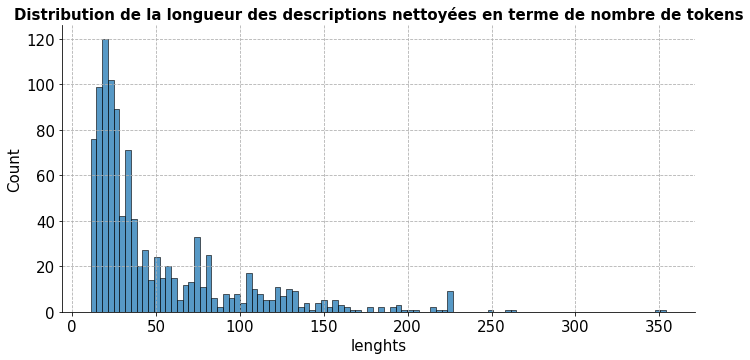

In [157]:
#Distribution du nombre de tokens dans les descitpions

sns.displot(data = final_df, x = 'lenghts', bins = 100, aspect = 2, height = 5)
plt.grid(True, ls = '--')
plt.title('Distribution de la longueur des descriptions nettoyées en terme de nombre de tokens', size = 15, weight = 'bold')

In [158]:
#Fonction de mise en place du Word2Vec à partir de la librairie gensim, retournant le modèle, la liste des mots, et les vecteurs correspondants à chaque mot

def word2vec_builder(w2v_size, w2v_window, w2v_min_count, w2v_epochs, maxlen, sent):
    sentences = [gensim.utils.simple_preprocess(text) for text in sent]
    w2v_model = Word2Vec(min_count=w2v_min_count, 
                       window=w2v_window,
                       vector_size=w2v_size,
                       seed=11, workers=4, compute_loss = True)
    w2v_model.build_vocab(sentences)
    history = w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
    model_vectors = w2v_model.wv
    w2v_words = model_vectors.index_to_key
    print("Taille du vocabulaire du Word2Vec : {}".format(len(w2v_words)))
    return model_vectors, w2v_words, w2v_model

In [159]:
#Utilisation de la fonction word2vec_builder, et détermination de la taille du vocabulaire

'''1- Matrice d'embedding de taille(vocab_size * 300)
   2- Taille du contexte : 5 (5 mots avant et après chaque token en input pour réaliser le plongement de mots)
   3- Entraînement sur 100 Epochs
   4- Longueur maximale en Input correspondant à la longueur maximale des descriptions pré-procéssées par la fonction de nettoyage.'''

w2v_vectors, w2v_words, wv_model = word2vec_builder(300, 5, 1, 100, max_len, final_df['w2v_tokens'].to_list())

Taille du vocabulaire du Word2Vec : 4369


Etant donné que le modèle entraîné est un continuous Bag-Of-Words, nous pouvons essayer de prédire un token en sortie en fonction de son contexte.

In [160]:
#Fonction de comparaison du token prédit par le modèle et du token réele en fonction du contexte

def w2v_output_predict():
    n = np.random.randint(1050)
    tokens = final_df['w2v_tokens'].values[n].split(' ')
    len_tmp = len(tokens)
    i = np.random.randint(5, len_tmp - 5)
    reel_word = tokens[i]
    context = tokens[i-6: i-1]
    context.extend(tokens[i+1: i+6])
    cbow_pred = wv_model.predict_output_word(context, topn = 5)
    plt.figure(figsize = (10,10))
    plt.rcParams.update({'font.size' : 10})
    plt.title('Comparaison entre le Token réel et les \ntokens prédits en fonction du contexte', size = 30, weight = 'bold')
    plt.text(-0.05, 0.9, 'Prédiction du terme : ', weight = 'bold', size = 20)
    plt.text(0.45, 0.9, '"{}"'.format(reel_word), weight = 'bold', size = 20, color = 'green')
    plt.text(-0.05, 0.8, '5 Tokens précédents :', weight = 'bold', size = 20)
    plt.text(0.45, 0.8, '{}'.format(tokens[i-6: i-1]), weight = 'bold', size = 20, color = 'navy')
    plt.text(-0.05, 0.7, '5 Tokens suivants :', weight = 'bold', size = 20)
    plt.text(0.45, 0.7, '{}'.format(tokens[i+1: i+6]), weight = 'bold', size = 20, color = 'navy')
    plt.text(-0.05, 0.6, 'Prédictions du modèle : ', weight = 'bold', size = 20)
    for i in range(5):
        if cbow_pred[i][0] == reel_word:
        plt.text(0.5, 0.6-(i*0.1), '{}'.format(cbow_pred[i]), weight = 'bold', size = 20, color = 'green') 
        else:
            plt.text(0.5, 0.6-(i*0.1), '{}'.format(cbow_pred[i]), weight = 'bold', size = 20, color = 'red') 
    plt.axis('off')

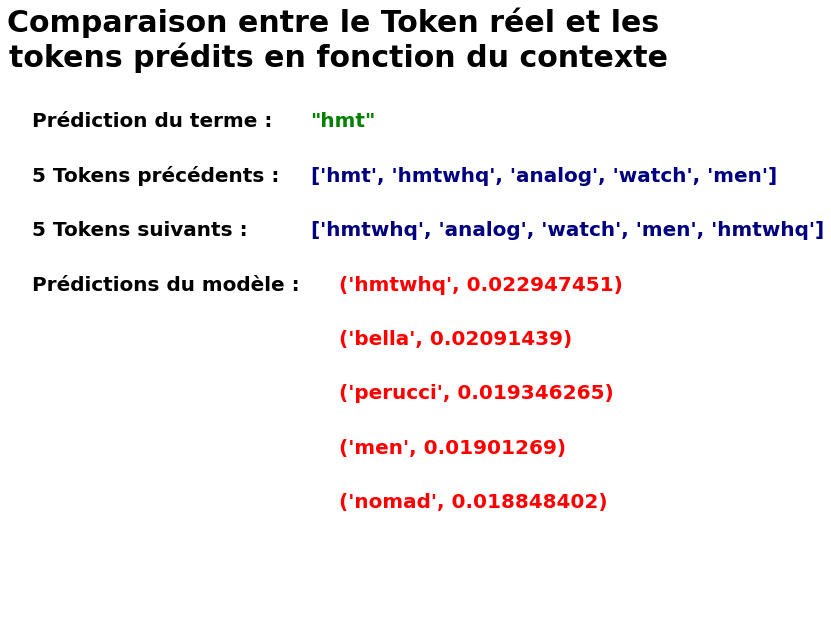

In [161]:
#Comparaison entre un token pris au hasard dans une description et ses 5 meilleures prédictions en fonction du contexte

w2v_output_predict()

In [162]:
#Création de la matrice des word_vectors

word_vectors = []

for i in w2v_words:
    word_vectors.append(w2v_vectors[i])
    
word_vectors = pd.DataFrame(word_vectors, index = w2v_words)
word_vectors.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
advance,0.275417,-0.572016,0.694817,0.185296,-0.089814,-0.222683,0.238399,0.153052,-0.115161,0.011297,...,0.663717,-0.260779,-0.096328,0.057408,0.068377,0.199642,-0.345504,-0.403713,0.051603,-0.095157
tiedribbons,-0.005101,-0.285821,-0.402918,0.079530,0.182054,0.331870,0.137065,-0.052611,-0.388926,0.212451,...,-0.188617,0.169564,0.034167,0.159929,-0.166838,0.185645,-0.499879,0.062251,0.509894,0.127289
helped,-0.102267,-0.144750,0.108491,-0.076780,-0.037679,-0.086678,-0.027731,0.040155,0.026182,-0.141807,...,0.176587,-0.052904,-0.095142,-0.067883,-0.114152,0.141035,0.032356,-0.131101,0.130099,-0.190415


In [163]:
#Réduction dimensionnelle par PCA et TSNE de manière à représenter tous les mots dans un espace à deux dimensions

w2v_pca_df = PCA_reductor(word_vectors, 0.99)
tsne_w2v = TSNE(n_jobs = -1, n_components = 2, random_state = 11, learning_rate = 50, perplexity = 5)
tsne_w2v_df = tsne_w2v.fit_transform(w2v_pca_df)
tsne_w2v_df = pd.DataFrame(tsne_w2v_df, columns = ['Component_1', 'Component_2'])
tsne_w2v_df.sample(3)

PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 100


,Component_1,Component_2
3130,69.635941,-2.654424
2233,55.330246,-72.270279
1424,80.937431,-19.048376


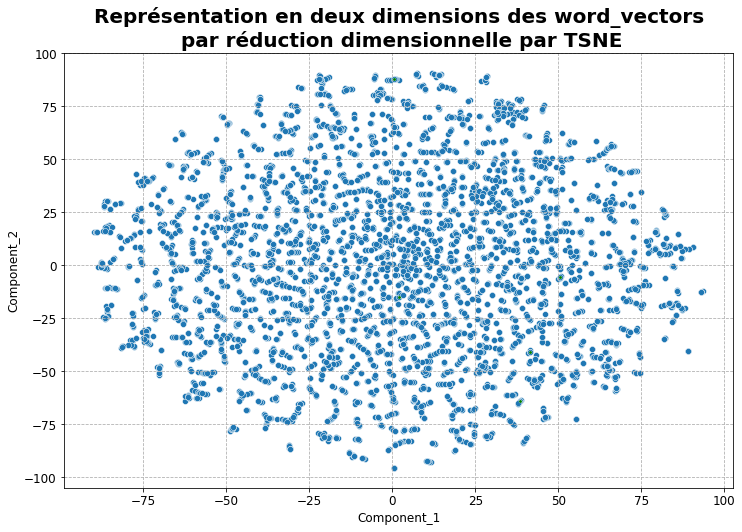

In [164]:
#Affichage des mots dans l'espace de redescription du TSNE

tsne_w2v_df['Word'] = word_vectors.index
tmp = tsne_w2v_df.sample(5)

plt.figure(figsize = (12,8))
plt.rcParams.update({'font.size' : 12})
sns.scatterplot(data = tsne_w2v_df, x = 'Component_1', y = 'Component_2')
sns.scatterplot(data = tmp, x = 'Component_1', y = 'Component_2', marker = 'o', color = 'green', s = 10)
plt.title('Représentation en deux dimensions des word_vectors\n par réduction dimensionnelle par TSNE', size = 20, weight = 'bold')
plt.grid(True, ls = '--')

Text(0, 0.5, 'TSNE Component_2')

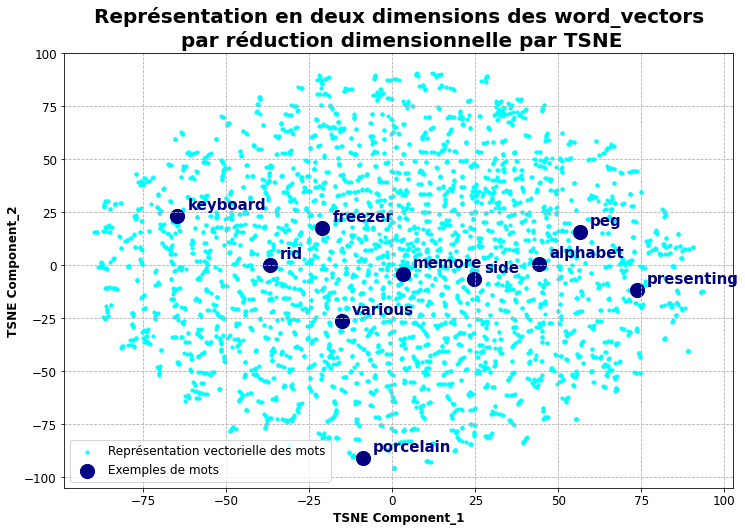

In [165]:
#Affichage des mots dans l'espace de redescription du TSNE

tsne_w2v_df['Word'] = word_vectors.index
tmp = tsne_w2v_df.sample(10)

plt.figure(figsize = (12,8))
plt.rcParams.update({'font.size' : 12})
plt.scatter(tsne_w2v_df['Component_1'], tsne_w2v_df['Component_2'], s = 10, color = 'cyan', label = 'Représentation vectorielle des mots')
plt.scatter(tmp['Component_1'], tmp['Component_2'], marker = 'o', s = 200, color = 'navy', label = 'Exemples de mots')
plt.title('Représentation en deux dimensions des word_vectors\n par réduction dimensionnelle par TSNE', size = 20, weight = 'bold')
for i in tmp.index:
    plt.text(tmp.loc[tmp.index == i, 'Component_1'] + 3, tmp.loc[tmp.index == i, 'Component_2'] + 3, '{}'.format(tmp.loc[tmp.index == i, 'Word'].values[0]),
           color = 'navy', size = 15, weight = 'bold')
plt.grid(True, ls = '--')
plt.legend()
plt.xlabel('TSNE Component_1', weight = 'bold')
plt.ylabel('TSNE Component_2', weight = 'bold')

Notons qu'il est possible à ce stade de mesurer la proximité de deux tokens en terme de sens en mesurant leur cosine similarity dans l'espace de redescription en 300 dimensions. 

Par soucis de temps d'éxecution, nous n'effecturons pas ce calcul dans ce notebook.

In [166]:
#Fonction de création de la matrice d'embedding à partir des word_vectors

def embedding_matrix_maker(sent, w2v_size, word_vectors, vocab, maxlen):
  #Tokenization des phrases
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(sent)
  #Transformation des phrases en arrays numpy 2D - pour chaque description, les tokens sont remplacé par leur integer associé par la methode pad_sequences
    x_sentences = pad_sequences(tokenizer.texts_to_sequences(sent),
                                                     maxlen=maxlen,
                                                     padding='post') 
  #Récupération de la taille du vocabulaire et de la liste des mots correspondants aux tokens
    word_index = tokenizer.word_index #Dictionnaire avec clé correspondants aux tokens et valeurs aux tokens associés à chaque token
    vocab_size = len(word_index) + 1

  #Initialisation de la matrice d'embedding pour notre extracteur de features final
    embedding_matrix = np.zeros((vocab_size, w2v_size))
    i=0
    j=0

  #Récupération des vecteurs de mots et mise à jour de la matrice d'embedding pour chaque mot unique
    for word, idx in word_index.items():
        i +=1
        if word in w2v_words:
            j +=1
            embedding_vector = word_vectors[word]
            if embedding_vector is not None:
                embedding_matrix[idx] = word_vectors[word]
    print('Forme de la matrice embedding : {}'.format(embedding_matrix.shape))
    embedding_matrix_df = pd.DataFrame(embedding_matrix)
    return embedding_matrix , embedding_matrix_df, x_sentences, vocab_size, word_index

In [167]:
#Création de la matrice d'embedding

embedding_matrix_w2v, embedding_matrix_w2v_df, x_sentences, vocab_size, word_index = embedding_matrix_maker(final_df['w2v_tokens'].to_list(), 300, w2v_vectors, w2v_words, max_len)
embedding_matrix_w2v_df.sample(3)

Forme de la matrice embedding : (4373, 300)


,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
3284,0.001629,0.125012,0.050701,0.041785,-0.307725,-0.060193,-0.189855,0.163313,0.082266,-0.086634,...,-0.048161,0.099166,0.071678,0.016356,0.016870,-0.003764,-0.005694,-0.152515,-0.211846,0.129117
168,0.692846,-0.256254,0.367588,-0.514085,2.254965,0.043669,-0.474018,0.957585,0.230114,0.664604,...,0.274761,0.048043,0.011497,0.685412,0.548538,-0.313205,-0.805517,0.440990,0.303099,-1.379233
324,0.587401,-0.667966,-0.264603,0.187630,-0.564708,0.092128,-0.164429,1.056554,0.220431,0.376993,...,0.255424,0.091885,0.433597,-0.068175,-0.820522,-0.067946,0.164284,0.746682,-1.112196,-0.369539


In [168]:
# Création du modèle d'embedding avec un GlobalAveragePooling pour réduire la dimension en sortie d'embedding layer

input=Input(shape=(len(x_sentences),max_len),dtype='float64')
word_input=Input(shape=(max_len,),dtype='float64')  
word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=300,
                         weights = [embedding_matrix_w2v],
                         input_length=max_len)(word_input)
word_vec=GlobalAveragePooling1D()(word_embedding)  
embed_model = Model([word_input],word_vec)

embed_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 354)]             0         
                                                                 
 embedding (Embedding)       (None, 354, 300)          1311900   
                                                                 
 global_average_pooling1d (G  (None, 300)              0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 1,311,900
Trainable params: 1,311,900
Non-trainable params: 0
_________________________________________________________________


In [169]:
#Utilisation du modèle d'embedding en inférence sur les individus

embeddings_w2v = embed_model.predict(x_sentences)
embeddings_w2v_df = pd.DataFrame(embeddings_w2v)

33/33 [==============================] - 0s 1ms/step


PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 47
----------

TSNE -- Essais de 6 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 120
----------



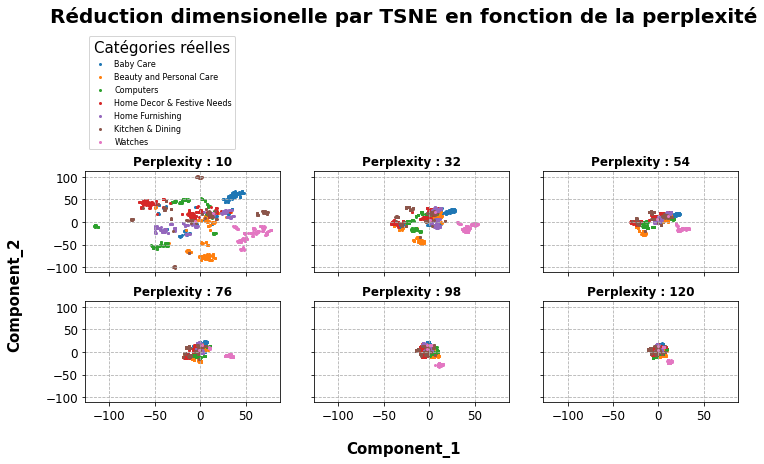

In [170]:
#Scatterplots TSNE en fonction de la perplexité

TSNE_perplexity_tuner_mapped(embeddings_w2v_df, 0.99, 10, 120, 6, categories)

PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 50
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.361
Perplexité : 20 - ARI : 0.345
Perplexité : 30 - ARI : 0.377
Perplexité : 40 - ARI : 0.378
Perplexité : 50 - ARI : 0.394
Perplexité : 60 - ARI : 0.398
Perplexité : 70 - ARI : 0.402
Perplexité : 80 - ARI : 0.385
Perplexité : 90 - ARI : 0.369
Perplexité : 100 - ARI : 0.333
Perplexité : 110 - ARI : 0.344
Perplexité : 120 - ARI : 0.333
Perplexité : 130 - ARI : 0.395
Perplexité : 140 - ARI : 0.349
Perplexité : 150 - ARI : 0.380
Meilleur perplexité : 70
Adjusted Random Index : 0.393


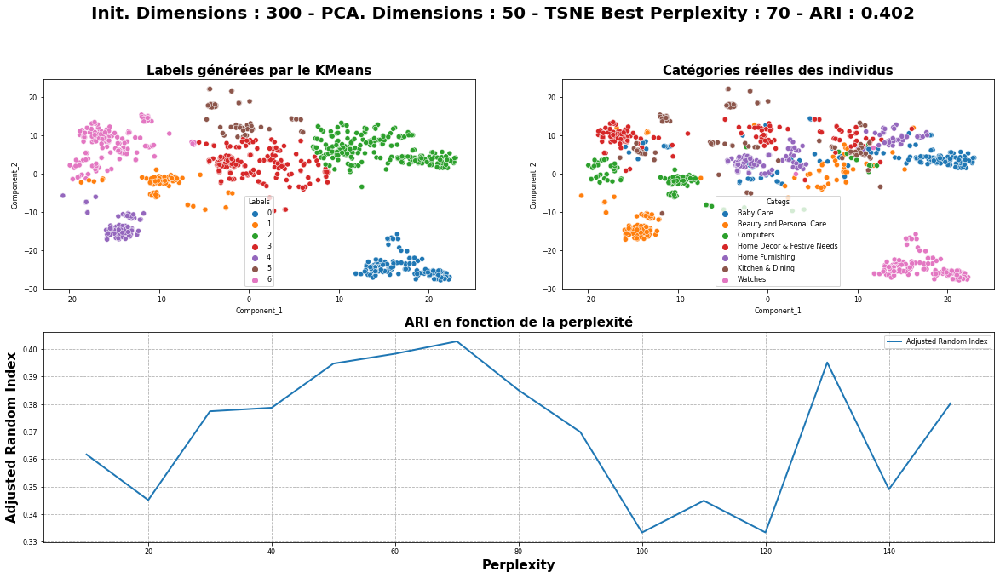

In [171]:
#Recherche de la meilleure perplexité pour le clustering et mesure de l'ARI

ari_w2v, best_perp_w2v = PCA_TSNE_ARI_tuner_KM(embeddings_w2v_df, 0.99, 10, 150, 15, 7, categories, False, True)

In [172]:
#Mise en place de la matrice de similarité entre les individus

cosine_matrix_w2v = cosine_similarity_maker(embeddings_w2v_df, categories)
cosine_matrix_w2v.sample(3)

,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,...,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches
Computers,0.147933,0.358491,0.295819,0.082906,-0.087270,-0.032482,0.142415,0.105081,0.151805,-0.048316,...,0.031550,0.109291,0.088423,0.091834,0.075956,0.109022,0.091956,0.120627,0.072486,0.080768
Home Decor & Festive Needs,-0.006393,-0.183299,-0.167662,-0.136606,-0.046977,0.027268,0.042109,0.126765,0.043227,-0.169977,...,-0.040117,-0.103526,-0.064006,-0.095580,-0.098798,-0.024335,-0.073572,-0.074135,-0.067311,-0.101004
Home Decor & Festive Needs,0.878251,-0.202550,-0.258390,-0.210735,-0.213106,-0.330243,-0.010930,-0.078607,-0.013195,-0.303701,...,0.639125,0.633194,0.657463,0.677128,0.691832,0.679840,0.662402,0.659835,0.722092,0.632369


Text(0.5, 1.0, 'Cosine Similarity entre les individus: \n Espace de redescription du word2vec')

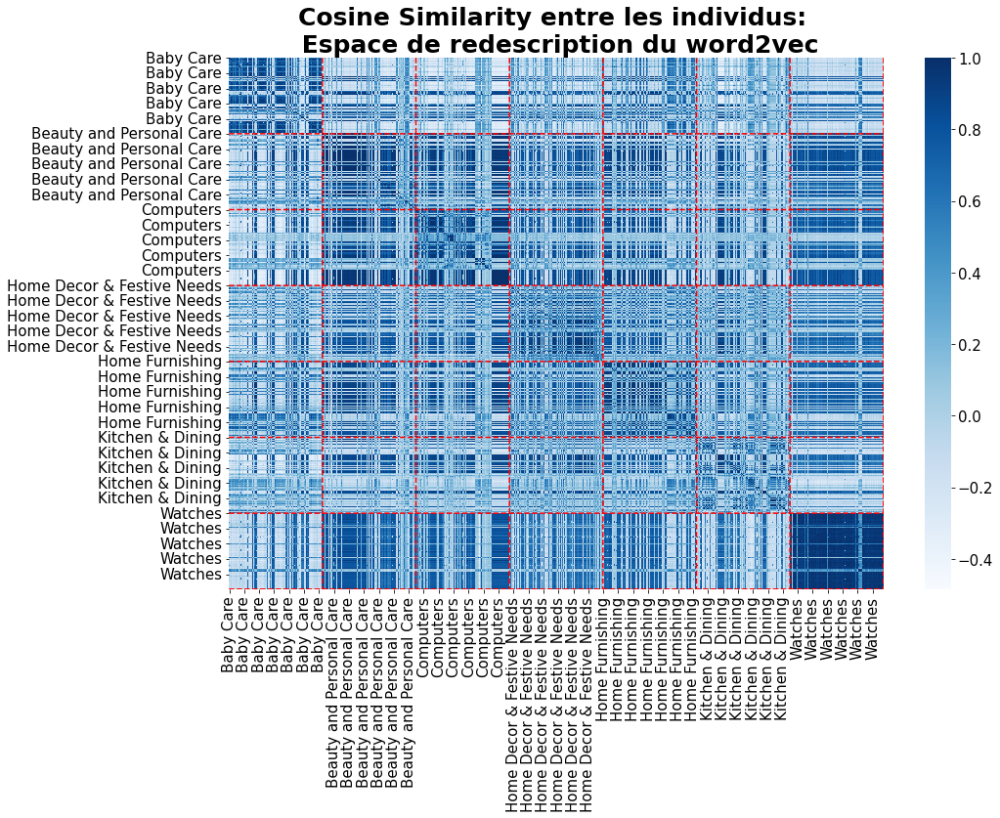

In [173]:
#Affichage de la matrice de similarités pour le word2vec 

plt.rcParams.update({'font.size' : 15})
plt.figure(figsize = (15,10))
sns.heatmap(cosine_matrix_w2v, cmap = 'Blues')
for i in range(7):
    plt.plot(np.full((1050), (i + 1)*150), np.linspace(0, 1050, 1050), color = 'red', ls = '--')
    plt.plot(np.linspace(0, 1050, 1050), np.full((1050), (i + 1)*150), color = 'red', ls = '--')
plt.title('Cosine Similarity entre les individus: \n Espace de redescription du word2vec', size = 25, weight = 'bold')

In [174]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_w2v = confusion_matrice_maker(embeddings_w2v_df, best_perp_w2v, 0.99, 7, categories)

PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 47
---------
TSNE - perplexité : 70
---------
KM - Nombre de clusters : 7


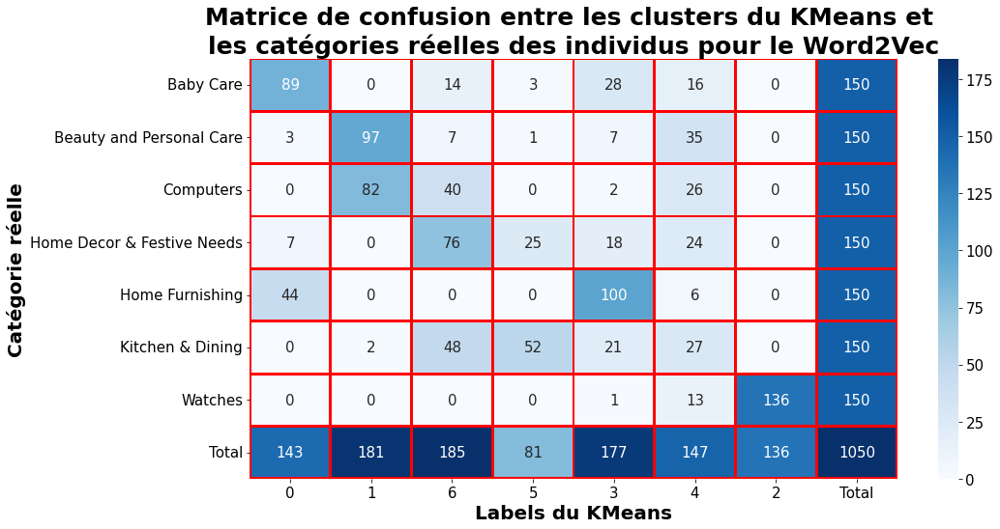

In [175]:
#Affichage de la matrice de confusion

confusion_matrix_displayer(confusion_matrix_w2v, 'Word2Vec')

  De la même manière que pour le TF-IDF et le CountVectorizer, nous pouvons essayer de mettre en place un classifier, et mesurer la précision de notre classifieur sur notre jeu de données.

In [176]:
#Mise en place du classifier

input=Input(shape=(len(x_sentences),max_len),dtype='float64')
word_input=Input(shape=(max_len,),dtype='float64')  
word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=300,
                         weights = [embedding_matrix_w2v],
                         input_length=max_len)(word_input)
word_vec=GlobalAveragePooling1D()(word_embedding) 
softmax7 = Dense(7, activation = 'Softmax')(word_vec)
w2v_classifier = Model([word_input],softmax7)

#Chaque layer doit être entraînable dans notre cas
for i in w2v_classifier.layers:
    i.trainable = True

w2v_classifier.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 354)]             0         
                                                                 
 embedding_1 (Embedding)     (None, 354, 300)          1311900   
                                                                 
 global_average_pooling1d_1   (None, 300)              0         
 (GlobalAveragePooling1D)                                        
                                                                 
 dense_2 (Dense)             (None, 7)                 2107      
                                                                 
Total params: 1,314,007
Trainable params: 1,314,007
Non-trainable params: 0
_________________________________________________________________


In [177]:
#Pré-traitement des données et préparation du classifier

lab = LabelEncoder()
labeled = lab.fit_transform(categories)
X_train, X_test, y_train, y_test = train_test_split(x_sentences, labeled, test_size = 0.2, stratify = labeled)

y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

In [178]:
# Compiler le modèle 
w2v_classifier.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True), 
                         optimizer=optimizers.Adam(learning_rate=0.001), metrics=['categorical_accuracy'])

# Entraîner sur les données d'entraînement (X_train, y_train)
history_w2v = w2v_classifier.fit(X_train, y_train, epochs=100, batch_size=10, verbose=1, validation_split = 0.1)

Epoch 1/100
76/76 [==============================] - 1s 5ms/step - loss: 1.8185 - categorical_accuracy: 0.3876 - val_loss: 1.7303 - val_categorical_accuracy: 0.4286
Epoch 2/100
76/76 [==============================] - 0s 3ms/step - loss: 1.5996 - categorical_accuracy: 0.5119 - val_loss: 1.5647 - val_categorical_accuracy: 0.5119
Epoch 3/100
76/76 [==============================] - 0s 3ms/step - loss: 1.4280 - categorical_accuracy: 0.5688 - val_loss: 1.4350 - val_categorical_accuracy: 0.5476
Epoch 4/100
76/76 [==============================] - 0s 3ms/step - loss: 1.2874 - categorical_accuracy: 0.6772 - val_loss: 1.3181 - val_categorical_accuracy: 0.5952
Epoch 5/100
76/76 [==============================] - 0s 3ms/step - loss: 1.1690 - categorical_accuracy: 0.7500 - val_loss: 1.2266 - val_categorical_accuracy: 0.6905
Epoch 6/100
76/76 [==============================] - 0s 3ms/step - loss: 1.0647 - categorical_accuracy: 0.7937 - val_loss: 1.1438 - val_categorical_accuracy: 0.7143
Epoch 7/10

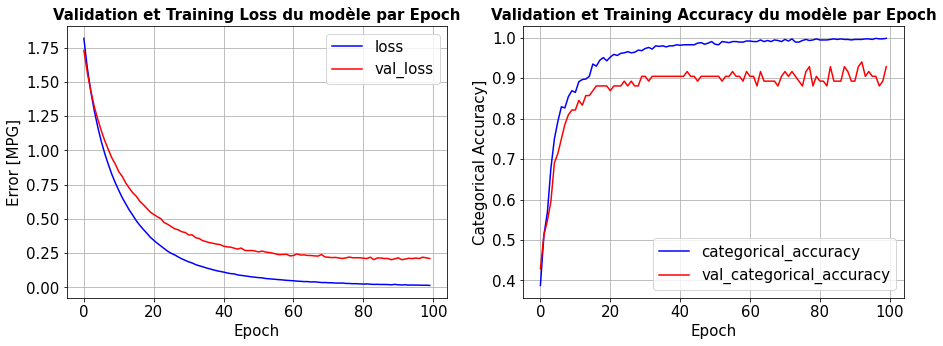

In [179]:
#Affichage de la loss et des métriques définies

plot_loss(history_w2v)

Malgrès des performances moins bonnes du word2vec pour l'embedding par rapport au TF-IDF et au CountVectorizer (ARI inférieur), le classifier présente de meilleurs performances à l'entraînement, tant du point de vue de lal loss que de l'accuracy.

Notons également un overfitting moins prononcé (meilleure généralisation) et une convergence plus rapide.

Nous nous proposons d'améliorer notre modèle en éffectuant un fine-tuning sur une partie de notre jeu de données, et en comparant les performances avec et sans entraînement.

In [180]:
#Pré-traitement des données avec une test_size plus élevée - entraîenemt sur 35% du jeu de données

lab = LabelEncoder()
labeled = lab.fit_transform(categories)
X_train, X_test, y_train, y_test = train_test_split(x_sentences, labeled, test_size = 0.65, stratify = labeled)

y_train_cat = to_categorical(y_train)
y_test_cat = to_categorical(y_test)
X_train_df = pd.DataFrame(X_train)
X_test_df = pd.DataFrame(X_test)

In [181]:
#Embedding avec le modèle initial (poids du WordVec dans la couche d'embedding)

embeddings_w2v_X_test = embed_model.predict(X_test)
embeddings_w2v_X_test_df = pd.DataFrame(embeddings_w2v_X_test)
embeddings_w2v_X_test_df.sample(3)

22/22 [==============================] - 0s 1ms/step


,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
180,0.013724,-0.005884,-0.017518,-0.051766,0.016629,-0.016623,-0.005342,0.023339,0.011441,-0.003842,...,-0.005567,-0.015887,-0.005208,-0.008137,-0.032199,0.005322,-0.035266,0.007458,-0.015571,-0.037770
612,0.078465,0.019292,0.078981,0.061366,0.094734,0.194039,0.015108,0.121883,-0.011880,0.228504,...,-0.091302,0.025314,-0.115652,-0.067131,-0.060877,-0.036889,0.059747,0.068898,-0.089105,0.001240
122,0.143871,-0.064881,-0.068764,0.112123,0.034160,-0.037450,0.044344,0.111263,0.030279,0.106190,...,-0.023365,-0.091335,-0.044000,-0.041745,-0.107750,-0.010906,-0.035823,-0.019517,-0.077990,-0.045542


PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 46
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.300
Perplexité : 20 - ARI : 0.315
Perplexité : 30 - ARI : 0.367
Perplexité : 40 - ARI : 0.350
Perplexité : 50 - ARI : 0.331
Perplexité : 60 - ARI : 0.338
Perplexité : 70 - ARI : 0.313
Perplexité : 80 - ARI : 0.322
Perplexité : 90 - ARI : 0.314
Perplexité : 100 - ARI : 0.317
Meilleur perplexité : 30
Adjusted Random Index : 0.366


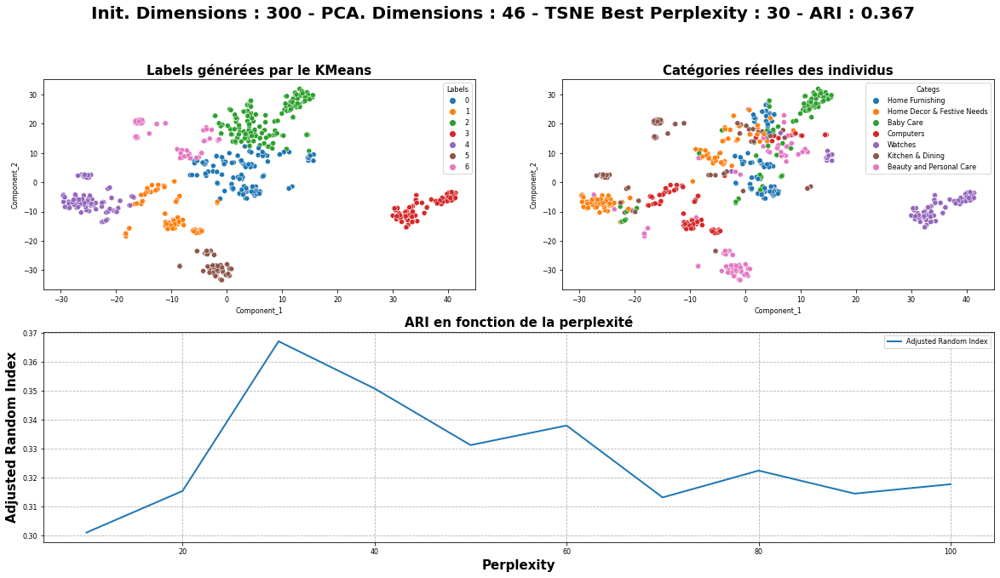

In [182]:
#Recherche de la meilleure perplexité pour le clustering et mesure de l'ARI sur le jeu de données X_test

ari_w2v_test, best_perp_w2v_test = PCA_TSNE_ARI_tuner_KM(embeddings_w2v_X_test_df, 0.99, 10, 100, 10, 7, lab.inverse_transform(y_test), False, False)

In [183]:
#Mise en place du classifier pour entraîement sur le jeu de données X_train

input=Input(shape=(len(x_sentences),max_len),dtype='float64')
word_input=Input(shape=(max_len,),dtype='float64')  
word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=300,
                         weights = [embedding_matrix_w2v],
                         input_length=max_len)(word_input)
word_vec=GlobalAveragePooling1D()(word_embedding) 
softmax7 = Dense(7, activation = 'Softmax')(word_vec)
w2v_classifier_X_train = Model([word_input],softmax7)

#Chaque layer doit être entraînable dans notre cas
for i in w2v_classifier_X_train.layers:
    i.trainable = True

w2v_classifier_X_train.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 354)]             0         
                                                                 
 embedding_2 (Embedding)     (None, 354, 300)          1311900   
                                                                 
 global_average_pooling1d_2   (None, 300)              0         
 (GlobalAveragePooling1D)                                        
                                                                 
 dense_3 (Dense)             (None, 7)                 2107      
                                                                 
Total params: 1,314,007
Trainable params: 1,314,007
Non-trainable params: 0
_________________________________________________________________


In [184]:
# Compiler le modèle 
w2v_classifier_X_train.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True), 
                         optimizer=optimizers.Adam(learning_rate=0.001), metrics=['categorical_accuracy'])

# Entraîner sur les données d'entraînement (X_train, y_train)
history_w2v_X_train = w2v_classifier_X_train.fit(X_train, y_train_cat, epochs=115, batch_size=10, verbose=1, validation_split = 0.1)

Epoch 1/115
33/33 [==============================] - 1s 8ms/step - loss: 1.8890 - categorical_accuracy: 0.3212 - val_loss: 1.8398 - val_categorical_accuracy: 0.4595
Epoch 2/115
33/33 [==============================] - 0s 4ms/step - loss: 1.7588 - categorical_accuracy: 0.4424 - val_loss: 1.7393 - val_categorical_accuracy: 0.5135
Epoch 3/115
33/33 [==============================] - 0s 4ms/step - loss: 1.6503 - categorical_accuracy: 0.4515 - val_loss: 1.6545 - val_categorical_accuracy: 0.5135
Epoch 4/115
33/33 [==============================] - 0s 4ms/step - loss: 1.5590 - categorical_accuracy: 0.5273 - val_loss: 1.5733 - val_categorical_accuracy: 0.5405
Epoch 5/115
33/33 [==============================] - 0s 4ms/step - loss: 1.4767 - categorical_accuracy: 0.5485 - val_loss: 1.5048 - val_categorical_accuracy: 0.6486
Epoch 6/115
33/33 [==============================] - 0s 4ms/step - loss: 1.4055 - categorical_accuracy: 0.5909 - val_loss: 1.4411 - val_categorical_accuracy: 0.6757
Epoch 7/11

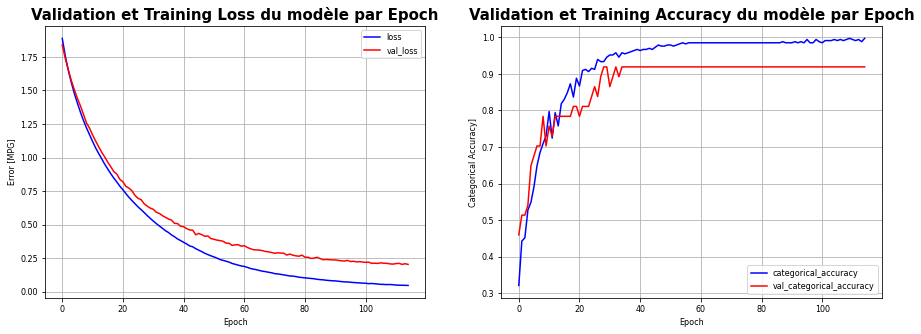

In [185]:
#Affichage de la loss et des métriques définies

plot_loss(history_w2v_X_train)

In [186]:
#Récupération des poids de la couche d'embedding de notre nouveau modèle

new_weights = np.array(w2v_classifier_X_train.layers[1].get_weights())[0]
new_weights.shape

(4373, 300)

In [187]:
#Nouveau modèle d'embedding

input=Input(shape=(len(x_sentences),max_len),dtype='float64')
word_input=Input(shape=(max_len,),dtype='float64')  
word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=300,
                         weights = [new_weights],
                         input_length=max_len)(word_input)
word_vec=GlobalAveragePooling1D()(word_embedding)  
embed_model_fine_tuned = Model([word_input],word_vec)

embed_model_fine_tuned.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 354)]             0         
                                                                 
 embedding_3 (Embedding)     (None, 354, 300)          1311900   
                                                                 
 global_average_pooling1d_3   (None, 300)              0         
 (GlobalAveragePooling1D)                                        
                                                                 
Total params: 1,311,900
Trainable params: 1,311,900
Non-trainable params: 0
_________________________________________________________________


In [188]:
#Embedding avec le nouveau modèle(poids du modèle fine-tuned dans la couche d'embedding)

embeddings_w2v_X_test_tuned = embed_model_fine_tuned.predict(X_test)
embeddings_w2v_X_test_tuned_df = pd.DataFrame(embeddings_w2v_X_test_tuned)
embeddings_w2v_X_test_tuned_df.sample(3)

22/22 [==============================] - 0s 1ms/step


,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
212,0.056243,0.068640,0.155733,0.098263,0.074815,0.249889,-0.011959,0.091143,-0.070628,0.255940,...,-0.129284,0.040786,-0.093526,-0.010440,-0.037065,-0.080948,0.095050,-0.060205,-0.102091,0.073957
56,0.161867,-0.085641,0.041040,0.065281,-0.041159,0.002713,0.119062,0.082814,0.009326,-0.027978,...,0.093826,-0.136350,-0.089001,-0.126547,-0.022684,-0.060539,0.006714,0.004441,-0.024766,-0.136823
610,0.026637,0.009808,-0.072535,0.012189,0.012248,0.023253,0.056933,-0.003137,-0.031321,0.028685,...,-0.066370,-0.017019,-0.009443,-0.007672,-0.034368,0.013398,0.014718,0.018272,0.025064,-0.030396


PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 42
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.517
Perplexité : 20 - ARI : 0.519
Perplexité : 30 - ARI : 0.545
Perplexité : 40 - ARI : 0.555
Perplexité : 50 - ARI : 0.563
Perplexité : 60 - ARI : 0.533
Perplexité : 70 - ARI : 0.536
Perplexité : 80 - ARI : 0.573
Perplexité : 90 - ARI : 0.422
Perplexité : 100 - ARI : 0.573
Meilleur perplexité : 80
Adjusted Random Index : 0.573


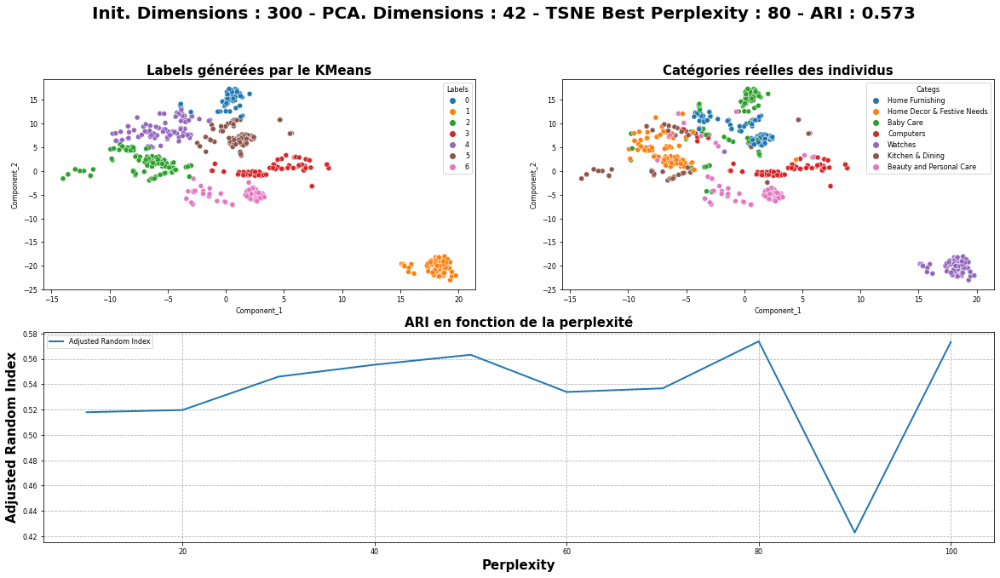

In [189]:
#Recherche de la meilleure perplexité pour le clustering et mesure de l'ARI sur le jeu de données X_test

ari_w2v_tuned, best_perp_w2v_tuned = PCA_TSNE_ARI_tuner_KM(embeddings_w2v_X_test_tuned_df, 0.99, 10, 100, 10, 7, lab.inverse_transform(y_test), False, False)

  Nous avons de bien meilleurs résultats avec un modèle fine-tuned sur une partie de notre jeu de donnnées.

PCA -- Nombre de dimensions initiales : 300
PCA -- Nombre de composantes principales : 42
---------
TSNE - perplexité : 80
---------
KM - Nombre de clusters : 7


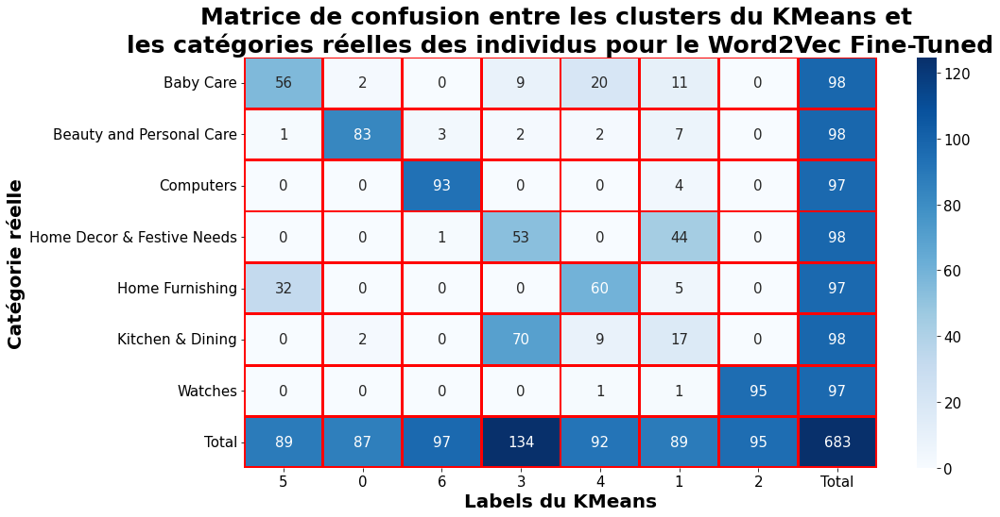

In [190]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_w2v_ft = confusion_matrice_maker(embeddings_w2v_X_test_tuned_df, best_perp_w2v_tuned, 0.99, 7, lab.inverse_transform(y_test))
confusion_matrix_displayer(confusion_matrix_w2v_ft, 'Word2Vec Fine-Tuned')

## 5.6- BERT Hugging Face



A présent, nous pouvons nous intéresser à des algorithmes de traitement du langage naturel plus récents, et réputés plus performants, les transformers.

Nous allons dans un premier temps nous intéresser à BERT, pour Bidirectionnal Encoding Representation from Transformers.

L'idée pour nous est de représenter les différentes descriptions dans un espace à dimensions fixe, puis, de la même manière que pour l'approche Word2Vec, effectuer une réduction dimensonnelle et un clustering sur les individus dans l'espace de redescription à dimensions réduites.

Pour ce faire, BERT utilise dans un premier temps une couche d'embedding positionnelle (de taille 1024 pour l'architecture Large BERT et 512 pour le small Bert), puis plusieurs couches d'encodeurs (entre 12 et 24 en fonction de l'architecture BERT choisie). Chaque encodeur est composé d'une couche d'attention multi-tête (auto-attention dans notre cas), et d'un Feed-Forward Network (2 couches avec activation ReLu).

Ce type de couche vient régler le problème des couches classique de traitement de séquences (RNN et LSTM), pour lesquels on observe des phénomènes de disparition et explosion du gradient, notament lorsque les séquences de texte sont trop longues.

In [108]:
#Importation de librairies supplémentaires

#Installation de trasformers sous la dernière version disponible
!pip install transformers

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

# Transfromers
import os
import transformers
from transformers import *

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [118]:
#Affichage des GPU disponibles

print(tf.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.11.0
Num GPUs Available:  1
True


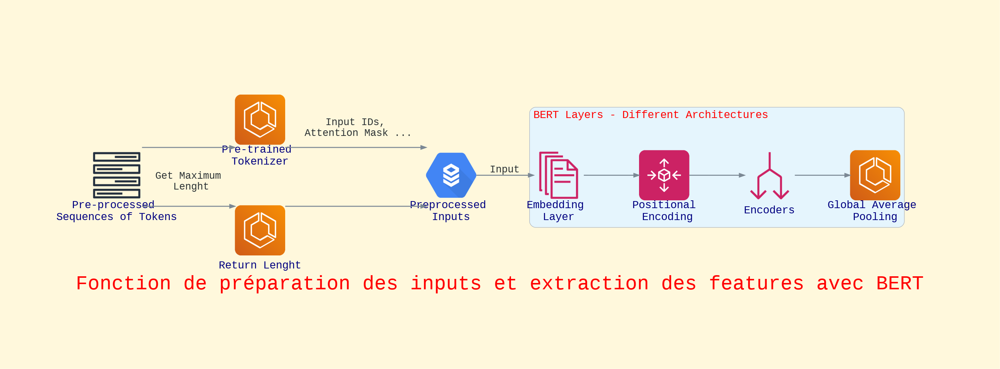

In [193]:
#Diagramme explicatif de l'extraction de features avec BERT

from diagrams.aws.storage import S3
from diagrams.aws.compute import ECS
from diagrams.aws.general import Forums
from diagrams.aws.management import SystemsManagerDocuments
from diagrams.aws.management import AutoScaling
from diagrams.aws.management import OpsworksDeployments

graph_attr = {
    "fontsize": "40",
    "bgcolor": "cornsilk", 'lwidth' : '20', 'fontcolor' : 'red', 'fontweight' : 'bold'
}

node_attr = {
    "fontsize": "22",
    "fontcolor": "navy", 'fontweight' : 'bold',
}

clust_attr = {
    'fontsize' : '22', 'fontcolor' : 'red', 'fontweight' : 'bold'
}


with Diagram('Fonction de préparation des inputs et extraction des features avec BERT', graph_attr = graph_attr, node_attr = node_attr, direction = 'LR') as diag:

    Initial_Sentence = Forums('\nPre-processed \nSequences of Tokens', style = 'bold')
    Tokenizer = ECS('\nPre-trained \nTokenizer', style = 'bold')
    Max_len = ECS('\nReturn Lenght', style = 'bold')
    Preprocessed_Inputs = SQL('\nPreprocessed \nInputs', style = 'bold')

    with Cluster('BERT Layers - Different Architectures', graph_attr = clust_attr):
        Embedding = SystemsManagerDocuments('\nEmbedding \nLayer', style = 'bold')
        Positional_Encoding = AutoScaling('\nPositional\n Encoding', style = 'bold')
        Encoders = OpsworksDeployments('\nEncoders', style = 'bold')
        Pool = ECS('\nGlobal Average \nPooling', style = 'bold')
        Embedding >> Edge(label = '', style = 'bold', fontsize = '20') >> Positional_Encoding
        Positional_Encoding >> Edge(label = '', style = 'bold', fontsize = '20') >> Encoders
        Encoders >> Edge(label = '', style = 'bold', fontsize = '20') >> Pool

    Initial_Sentence >> Edge(label = '', style = 'bold', fontsize = '20') >> Tokenizer
    Initial_Sentence >> Edge(label = 'Get Maximum\n Lenght', style = 'bold', fontsize = '20') >> Max_len
    Tokenizer >> Edge(label = 'Input IDs,\n Attention Mask ...', style = 'bold', fontsize = '20') >> Preprocessed_Inputs
    Max_len >> Edge(label = '', style = 'bold', fontsize = '20') >> Preprocessed_Inputs
    Preprocessed_Inputs >> Edge(label = 'Input', style = 'bold', fontsize = '20') >> Embedding
diag

In [205]:
# Fonction de préparation des séquences

def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[] #Inputs de la sequence tokenizée en associant un token à un integer de manière unique (association clé-valeurs)
    attention_mask=[] #Attention mask adapté à la longueur de la liste de tokens (longueur = longueur maximale des description pré-traitées) - si input de longueur 200, nous aurons 200 valeurs égales
                      #à 1 et le reste égale à 0 (de manière à gérer la fin de séquence en input)
    input_type_ids = []
    token_type_ids = [] #Contient les 2 précédentes informations  citées
    bert_inp_tot = []
    for sent in sentences:
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = False,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

# Fonction d'éxtraction des features'
def feature_BERT_fct(model, model_type, sentences, max_length, b_size) :
    batch_size = b_size
    batch_size_pred = b_size
    #Auto-Tokenizer Bert
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)

    #Création de batchs pour les descriptions en entrée
    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        #Extraction des inputs en appelant la fonction bert_inp_fct
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        #Extraction des features en appelant l'encodeur, et extraction des derniers états cachés
        outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
        last_hidden_states = outputs.last_hidden_state

        #Concaténation des hidden states des différents batchs (et initialisation pour le premier batch) 
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    #Création des features à partir du dernier état cachés des différents batchs
    #Les last_hidden_states sont de dimensions max_len par 788 dans le cas de small bert, nous en faisons la moyenne, ce qui est strictement équivalent à un GlobalAveragePooling
    #Ainsi, nous aurons, pour chaque phrase, des features de dimensions 788 dans le cas de small bert
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
     
    return features_bert

In [206]:
#Fonction de nettoyage des sentences pour l'utilisation de bert

def dl_cleaning(doc, uncased, limit_len):

    #tokenization
    tokens = word_tokenize(doc)

    #bert-uncased = phrases en minuscule, bert-cased = majuscules conservées
    if uncased == True:
        lw = [w.lower() for w in tokens]
    else:
        lw = tokens
      
    #Small Bert = 512 longueur maximale en input - Large bert = 1024 longueur maximale en input
    size = [w for w in lw if len(w)>limit_len]
    transfer = ' '.join(size)
    return transfer

In [207]:
#Preprocessing small bert uncased
final_df['DL_small_bert_uncased'] = final_df['description'].swifter.apply(lambda x : dl_cleaning(x, True, 2))
final_df['DL_small_bert_uncased'][0]

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain 213 height pack price 899 this curtain enhances the look the interiors.this curtain made from 100 high quality polyester fabric.it features eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain ant- wrinkle and anti shrinkage and have elegant apparance.give your home bright and modernistic appeal with these designs the surreal attention sure steal hearts these contemporary eyelet and valance curtains slide smoothly when you draw them apart first thing the morning welcome the bright sun rays you want wish good morning the whole world and when you draw them close the evening you create the most special moments joyous beauty given the soothing prints bring home the elegant curtain that softly filters light your room that you get the right amount sunlight. specifications elegance polyester multicolor 

In [208]:
#Preprocessing large bert uncased
final_df['DL_large_bert_uncased'] = final_df['description'].swifter.apply(lambda x : dl_cleaning(x, True, 0))
final_df['DL_large_bert_uncased'][0]

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain , elegance polyester multicolor abstract eyelet door curtain ( 213 cm in height , pack of 2 ) price : rs . 899 this curtain enhances the look of the interiors.this curtain is made from 100 % high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs . the surreal attention is sure to steal hearts . these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening , you create the most special moments of joyous beauty given by the soothing prints . bring home the elegant curtain that softly filters light in your room

In [209]:
#Preprocessing large bert uncased
final_df['DL_large_bert_uncased'] = final_df['description'].swifter.apply(lambda x : dl_cleaning(x, True, 0))
final_df['DL_large_bert_uncased'][0]

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain , elegance polyester multicolor abstract eyelet door curtain ( 213 cm in height , pack of 2 ) price : rs . 899 this curtain enhances the look of the interiors.this curtain is made from 100 % high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs . the surreal attention is sure to steal hearts . these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening , you create the most special moments of joyous beauty given by the soothing prints . bring home the elegant curtain that softly filters light in your room

In [210]:
#La longueur maximale doit être de 512 pour les architectures bert de base, et 1024 pour les architectures Large Bert

final_df['DL_lenght_large'] = final_df['DL_large_bert_uncased'].apply(lambda x : len(x.split(' ')))
final_df['DL_lenght_small'] = final_df['DL_small_bert_uncased'].apply(lambda x : len(x.split(' ')))
final_df['DL_lenght_very_small'] = final_df['DL_small_bert_uncased'].apply(lambda x : len(x.split(' ')))
large_bert_max = final_df['DL_lenght_large'].max()
small_bert_max = final_df['DL_lenght_small'].max()
print('Longueur maximale pour input small bert : {}'.format(small_bert_max))
print('Longueur maximale pour input large bert : {}'.format(large_bert_max))

Longueur maximale pour input small bert : 488
Longueur maximale pour input large bert : 639


In [211]:
#Fonction retourant les feaures en fonction du model pré-entrainé sélectionné
from transformers import BertForMaskedLM

def bert_encoding_matrix(type, b_size, mod_type):
    if type == 'small':
        maxlen = small_bert_max
        sent = final_df['DL_small_bert_uncased']
    elif type == 'large':
        maxlen = large_bert_max
        sent = final_df['DL_large_bert_uncased']
    elif type == 'large_cased':
        maxlen = large_bert_max
        sent = final_df['DL_large_bert_cased']
    model = TFAutoModel.from_pretrained(mod_type, from_pt = True)
    sentences = sent.to_list()
    features_bert = feature_BERT_fct(model, mod_type, sentences, 
                                                         maxlen, b_size)
    bert_df = pd.DataFrame(features_bert)
    return bert_df

Avant de passer à la suite, nous pouvons afficher quelques résultats concernant la préparation des inputs.

In [212]:
#Mise en place d'une phrase test pré-processed pour Small Bert

test_sentence = final_df['DL_small_bert_uncased'].values[0]
test_sentence

'buy uberlyfe large vinyl sticker for rs.595 online uberlyfe large vinyl sticker best prices with free shipping cash delivery only genuine products day replacement guarantee'

In [213]:
#Création du tokenizer

bert_tokenizer = AutoTokenizer.from_pretrained('bert-base-uncased')

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file vocab.txt from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/vocab.txt
loading file to

In [214]:
#Affichage des outputs du tokenizer sur la phrase test

bert_tokenizer([test_sentence])

{'input_ids': [[101, 4965, 19169, 2135, 7959, 2312, 8877, 6293, 2121, 2005, 12667, 1012, 5354, 2629, 3784, 19169, 2135, 7959, 2312, 8877, 6293, 2121, 2190, 7597, 2007, 2489, 7829, 5356, 6959, 2069, 10218, 3688, 2154, 6110, 11302, 102]], 'token_type_ids': [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]], 'attention_mask': [[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]]}

In [215]:
#Création des inputs pour l'encoder

input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct([test_sentence], AutoTokenizer.from_pretrained('bert-base-uncased'), 488)

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file vocab.txt from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/vocab.txt
loading file to

In [216]:
#Affichage de l'attention mask - longueur maximale = 488, longueur de la sequence = 34

attention_mask

array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [217]:
#Affichage des Inputs IDs - 50 premières valeurs

input_ids[0][:50]

array([ 4965, 19169,  2135,  7959,  2312,  8877,  6293,  2121,  2005,
       12667,  1012,  5354,  2629,  3784, 19169,  2135,  7959,  2312,
        8877,  6293,  2121,  2190,  7597,  2007,  2489,  7829,  5356,
        6959,  2069, 10218,  3688,  2154,  6110, 11302,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0], dtype=int32)

In [219]:
#Extraction des features de notre phrase de test - batch size à 1 car une seule description à process

features_test = feature_BERT_fct(TFAutoModel.from_pretrained('bert-base-uncased', from_pt = True), 'bert-base-uncased', [test_sentence], 488, 1)

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file pytorch_model.bin from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/pytorch_m

1/1 [==============================] - 2s 2s/step


In [220]:
#Affichage des features extraits

[features_test]

[array([[ 2.21863687e-01, -1.87370881e-01,  3.38349462e-01,
          2.71445602e-01,  1.40428454e-01, -5.03184497e-02,
         -2.66294301e-01,  1.29898369e-01, -1.56491086e-01,
         -1.20558545e-01, -5.07904589e-02,  1.37289450e-01,
         -7.99228773e-02,  1.12230763e-01, -1.84699699e-01,
          9.97180939e-02, -2.49920130e-01, -1.92049474e-01,
         -4.43169177e-02,  1.11838967e-01,  1.20418638e-01,
          2.13292390e-01,  5.02841473e-01, -3.63211393e-01,
         -2.29486734e-01,  7.94086680e-02, -4.09812070e-02,
         -1.69499353e-01, -3.16692561e-01,  5.97842857e-02,
          2.62903988e-01, -9.33627337e-02,  1.38286397e-01,
         -5.93974860e-03,  1.57603651e-01,  2.15210348e-01,
         -4.65661585e-01,  1.74813345e-01,  1.75702676e-01,
         -1.09048344e-01,  3.24084580e-01, -9.35309008e-03,
         -2.47705340e-01, -6.09804643e-03, -1.03392564e-01,
         -4.53795582e-01, -4.24427867e-01, -9.03411433e-02,
         -4.79948670e-01, -2.99422592e-0

In [221]:
#Utilisation de la fonction pour le modèle bert-base-uncased - batch size à 10

bert_base_uncased_encoding = bert_encoding_matrix('small', 10, 'bert-base-uncased')

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file pytorch_model.bin from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/pytorch_m

1/1 [==============================] - 0s 32ms/step


PCA -- Nombre de dimensions initiales : 768
PCA -- Nombre de composantes principales : 293
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.279
Perplexité : 20 - ARI : 0.279
Perplexité : 30 - ARI : 0.278
Perplexité : 40 - ARI : 0.277
Perplexité : 50 - ARI : 0.272
Perplexité : 60 - ARI : 0.275
Perplexité : 70 - ARI : 0.271
Perplexité : 80 - ARI : 0.270
Perplexité : 90 - ARI : 0.274
Perplexité : 100 - ARI : 0.272
Meilleur perplexité : 20
Adjusted Random Index : 0.279


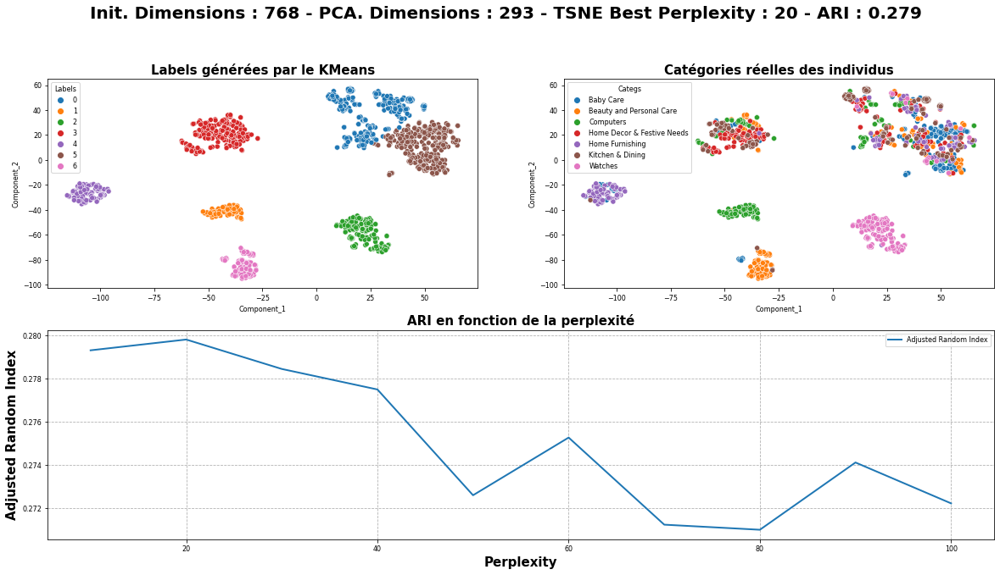

In [223]:
#Recherche de la meilleure perplexité

ari_bert_base, perp_bert_base = PCA_TSNE_ARI_tuner_KM(bert_base_uncased_encoding, 0.99, 10, 100, 10, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 768
PCA -- Nombre de composantes principales : 293
---------
TSNE - perplexité : 20
---------
KM - Nombre de clusters : 7


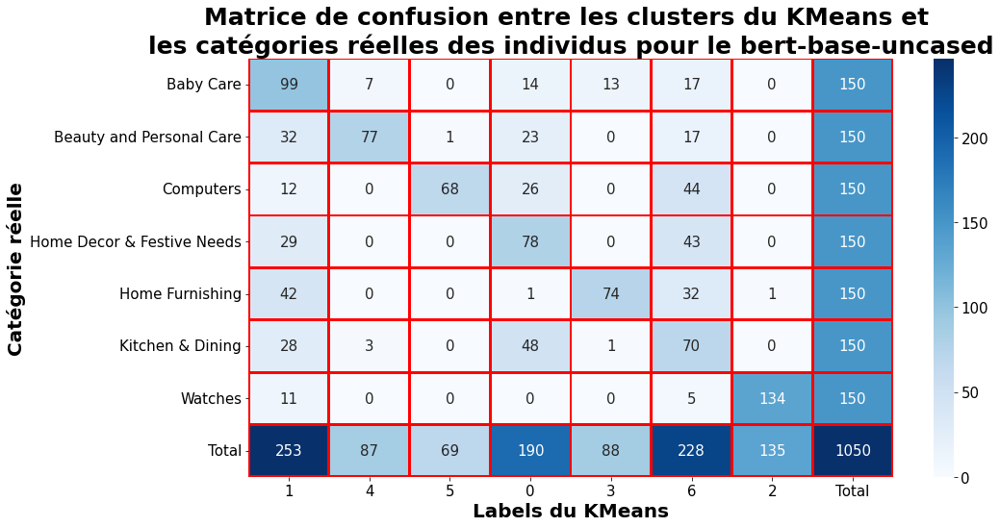

In [224]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_bert_base = confusion_matrice_maker(bert_base_uncased_encoding, perp_bert_base, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_bert_base, 'bert-base-uncased')

Nous avons des résultats relativement mauvais avec bert-base-uncased dans notre cas. Nous pouvons utiliser un modèle pré-entraîné sur des données d'entraînement plus proches de nos données actuelles.

Pour cela, nous utiliserons un modèle basé sur l'architecture large-bert, entraîné sur des produits amazon, prennant en input des descriptions pré-processed en lowercase : 'bergum/product_description_ranking'.

In [225]:
#Utilisation de la fonction pour le modèle product_description_ranking pré-entraîné sur des produits amazon - batch size à 10

bergum_product_ranking_encoding = bert_encoding_matrix('large', 10, 'bergum/product_description_ranking')

Downloading:   0%|          | 0.00/824 [00:00<?, ?B/s]

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/config.json
Model config BertConfig {
  "_name_or_path": "bergum/product_description_ranking",
  "architectures": [
    "BertForSequenceClassification"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 384,
  "id2label": {
    "0": "LABEL_0"
  },
  "initializer_range": 0.02,
  "intermediate_size": 1536,
  "label2id": {
    "LABEL_0": 0
  },
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 6,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "sbert_ce_default_activation_function": "torch.nn.modules.linear.Identity",
  "torch_dtype": "float32",
  "transformers_version": "4.25.1",
  "typ

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

loading weights file pytorch_model.bin from cache at /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/pytorch_model.bin
Loading PyTorch weights from /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/pytorch_model.bin
PyTorch checkpoint contains 22,714,113 parameters
Loaded 22,713,216 parameters in the TF 2.0 model.
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['bert.embeddings.position_ids', 'classifier.weight', 'classifier.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TF

Downloading:   0%|          | 0.00/538 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/712k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/125 [00:00<?, ?B/s]

loading file vocab.txt from cache at /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/vocab.txt
loading file tokenizer.json from cache at /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/tokenizer.json
loading file added_tokens.json from cache at None
loading file special_tokens_map.json from cache at /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/special_tokens_map.json
loading file tokenizer_config.json from cache at /root/.cache/huggingface/hub/models--bergum--product_description_ranking/snapshots/5105d6fea39ccee75d95dba29df6649c364230ac/tokenizer_config.json


1/1 [==============================] - 0s 20ms/step


PCA -- Nombre de dimensions initiales : 384
PCA -- Nombre de composantes principales : 105
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.269
Perplexité : 20 - ARI : 0.272
Perplexité : 30 - ARI : 0.271
Perplexité : 40 - ARI : 0.276
Perplexité : 50 - ARI : 0.272
Perplexité : 60 - ARI : 0.272
Perplexité : 70 - ARI : 0.272
Perplexité : 80 - ARI : 0.267
Perplexité : 90 - ARI : 0.267
Perplexité : 100 - ARI : 0.274
Meilleur perplexité : 40
Adjusted Random Index : 0.276


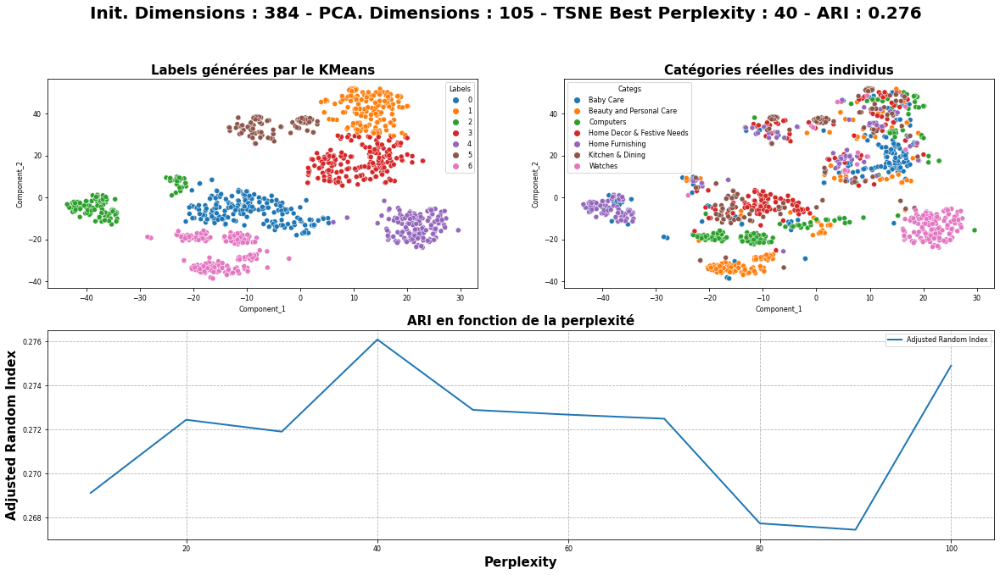

In [226]:
#Recherche de la meilleure perplexité

ari_bergum, perp_bergum = PCA_TSNE_ARI_tuner_KM(bergum_product_ranking_encoding, 0.99, 10, 100, 10, 7, categories, False, True)

Nous pouvons également essayer un modèle roberta, entraîné sur des données non lowercased. Pour cela, nous utilisons la fonction de nettoyage sans placer les tokens en minuscule.

In [227]:
#Nettoyage des tokens pour un cas d'utilisation large-bert cased - uncased placé à False dans la fonction de nettoyage, sans suppression de tokens basé sur leur taille

final_df['DL_large_bert_cased'] = final_df['description'].swifter.apply(lambda x : dl_cleaning(x, False, 0))
final_df['DL_large_bert_cased'].sample(1)

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

818    Buy Raymond Abstract Single Blanket Orange at ...
Name: DL_large_bert_cased, dtype: object

In [228]:
#Utilisation de la fonction pour le modèle roberta-large

roberta_encoding = bert_encoding_matrix('large_cased', 10, 'roberta-large')

Downloading:   0%|          | 0.00/482 [00:00<?, ?B/s]

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/config.json
Model config RobertaConfig {
  "_name_or_path": "roberta-large",
  "architectures": [
    "RobertaForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "bos_token_id": 0,
  "classifier_dropout": null,
  "eos_token_id": 2,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-05,
  "max_position_embeddings": 514,
  "model_type": "roberta",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 1,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 1,
  "use_cache": true,
  "vocab_size": 50265
}



Downloading:   0%|          | 0.00/1.43G [00:00<?, ?B/s]

loading weights file pytorch_model.bin from cache at /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/pytorch_model.bin
Loading PyTorch weights from /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/pytorch_model.bin
PyTorch checkpoint contains 407,933,017 parameters
Loaded 355,359,744 parameters in the TF 2.0 model.
Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaModel: ['lm_head.decoder.weight', 'lm_head.dense.weight', 'lm_head.layer_norm.bias', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.bias']
- This IS expected if you are initializing TFRobertaModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaModel from a PyTorch model that you expect to be ex

Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

loading file vocab.json from cache at /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/vocab.json
loading file merges.txt from cache at /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/merges.txt
loading file tokenizer.json from cache at /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/tokenizer.json
loading file added_tokens.json from cache at None
loading file special_tokens_map.json from cache at None
loading file tokenizer_config.json from cache at None
loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--roberta-large/snapshots/5069d8a2a32a7df4c69ef9b56348be04152a2341/config.json
Model config RobertaConfig {
  "_name_or_path": "roberta-large",
  "architectures": [
    "RobertaForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "bos_token_id": 0,
  "classifier_dropout": null,
  "eos

1/1 [==============================] - 0s 278ms/step


PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 403
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.238
Perplexité : 20 - ARI : 0.226
Perplexité : 30 - ARI : 0.217
Perplexité : 40 - ARI : 0.217
Perplexité : 50 - ARI : 0.214
Perplexité : 60 - ARI : 0.198
Perplexité : 70 - ARI : 0.209
Perplexité : 80 - ARI : 0.220
Perplexité : 90 - ARI : 0.202
Perplexité : 100 - ARI : 0.200
Meilleur perplexité : 10
Adjusted Random Index : 0.238


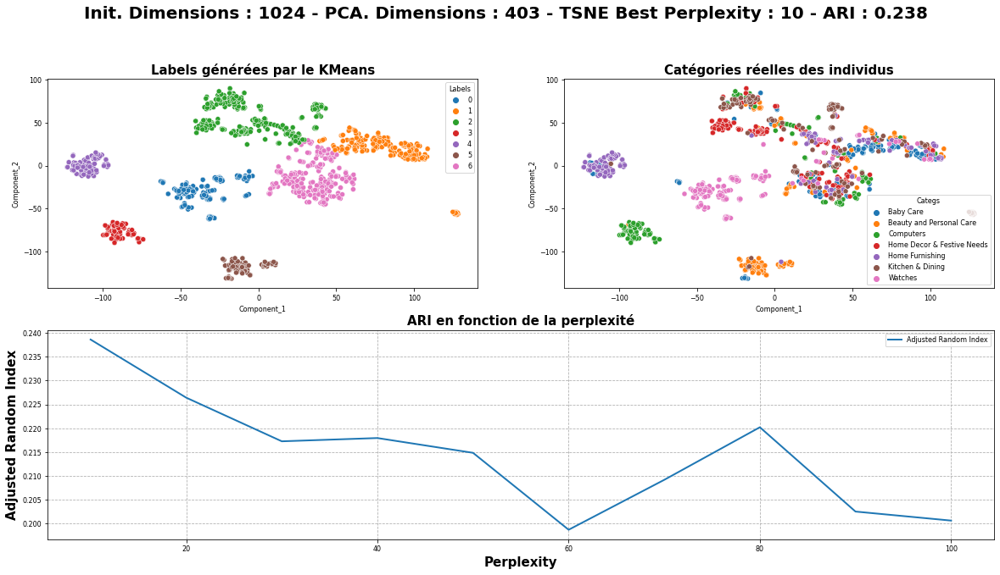

In [229]:
#Recherche de la meilleure perplexité

ari_roberta, perp_roberta = PCA_TSNE_ARI_tuner_KM(roberta_encoding, 0.99, 10, 100, 10, 7, categories, False, True)

## 5.7- BERT Tensorflow Hub

A ce stade, nous avons eu des résultats décevants avec Bert-HuggingFace. Cela est du au fait que nous avons besoin d'un modèle pré-entraîné sur des données d'entraînement similaires à notre jeu de données pour avoir de bons résultats.

Pour aller plus loin, nous pouvons utiliser Bert Tensorflow_hub, et effectuer un fine-tuning total sur une faible partie du jeu de données pour avoir des résultats intéressants sur le jeu de données de test, comme nous le verrons dans cette partie.

In [230]:
#Importation de tensorflow_hub pour utiliser les modèles pré-entraînés, et tensorflow_test pour le preprocessing des individus

import tensorflow_hub as hub
import tensorflow_text as text

In [231]:
#Définition du preprocesseur et de l'encodeur de l'architecture large-bert-uncased

preprocess = hub.load("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
encoder = hub.load("https://tfhub.dev/tensorflow/bert_en_wwm_uncased_L-24_H-1024_A-16/4")

Dans notre cas, nous importons directement la fonction de pre-processing associée à l'encodeur que nous souhaitons utiliser (lowercase, puis Tokenizer et extraction des Inputs).

In [232]:
#Fonction retournant la matrice d'embedding d'une phrase, avec un GlobalAveragePooling pour réduire les dimenions

def bert_encode_returner(text):
    preprocessed = preprocess([text])
    encoded = encoder(preprocessed)
    pooled_output = np.array(encoded['pooled_output'])[0]
    return pooled_output

In [233]:
#Application de la fonction à toutes les descriptions

final_df['TF_bert_base_uncased'] = final_df['description'].swifter.apply(lambda x : bert_encode_returner(x))

Pandas Apply:   0%|          | 0/1050 [00:00<?, ?it/s]

In [234]:
#Extraction des features 

large_bert_encoded = []
for i in range(len(final_df)):
  large_bert_encoded.append(final_df['TF_bert_base_uncased'][i])

large_bert_encoded = np.array(large_bert_encoded)
large_bert_encoded_df = pd.DataFrame(large_bert_encoded)
large_bert_encoded_df.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
635,-0.962743,-0.041540,-0.975049,0.997552,0.996378,-0.821203,-0.698201,-0.990718,0.215873,-0.922318,...,-0.441436,0.610727,-0.332494,-0.973723,-0.969514,-0.061094,0.981407,0.740604,-0.586623,0.946495
696,0.994640,-0.991941,-0.966896,-0.605733,-0.610010,-0.912760,-0.750704,0.172087,-0.426530,-0.547663,...,0.478002,0.997256,-0.368986,-0.969223,-0.540262,-0.648160,0.912703,0.196993,-0.956375,0.903909
568,0.999760,-0.689777,-0.939319,-0.975138,-0.991310,-0.946769,-0.919954,-0.851232,-0.996207,-0.946993,...,0.085854,0.983714,0.808246,-0.972385,-0.976381,0.764890,0.989010,-0.915356,-0.839772,0.962953


PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 274
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.072
Perplexité : 20 - ARI : 0.081
Perplexité : 30 - ARI : 0.084
Perplexité : 40 - ARI : 0.083
Perplexité : 50 - ARI : 0.078
Perplexité : 60 - ARI : 0.082
Perplexité : 70 - ARI : 0.078
Perplexité : 80 - ARI : 0.076
Perplexité : 90 - ARI : 0.072
Perplexité : 100 - ARI : 0.075
Meilleur perplexité : 30
Adjusted Random Index : 0.085


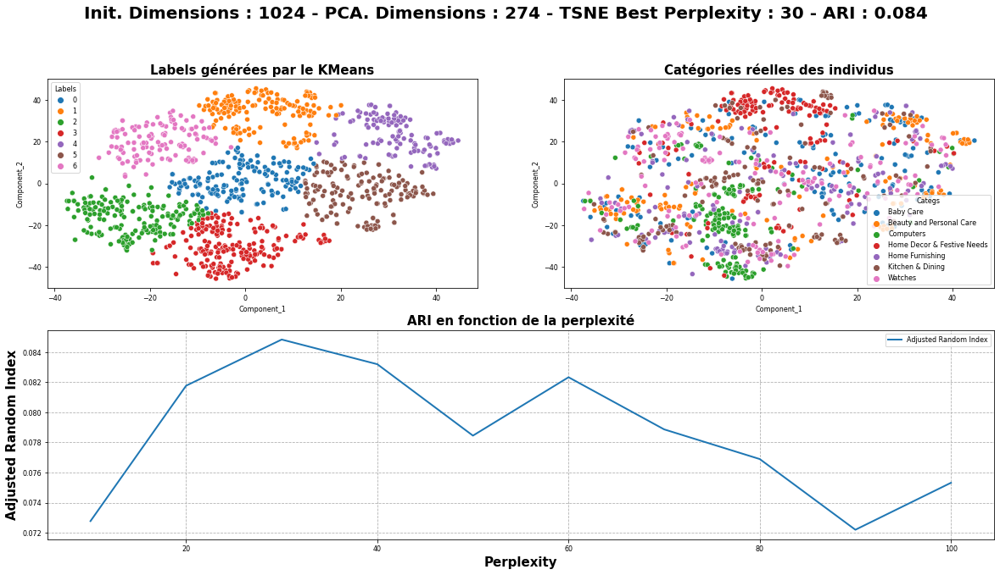

In [235]:
#Recherche de la meilleure valeur de perplexité pour le TSNE et clustering

large_bert_ari, large_bert_perp = PCA_TSNE_ARI_tuner_KM(large_bert_encoded_df, 0.99, 10, 100, 10, 7, categories, False, True)

De la même manière que pour le Word2Vec, nous avons de mauvais résultats avec large BERT.

Nous nous proposons d'effectuer un fine-tuning sur 35% du jeu de données, et de tester l'extraction des features sur le jeu de données de test.

In [236]:
#Définition de la fonction de construction du classifier

def build_classifier_model():
    text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
    preprocessing_layer = hub.KerasLayer('https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3', name='preprocessing')
    encoder_inputs = preprocessing_layer(text_input)
    encoder = hub.KerasLayer('https://tfhub.dev/tensorflow/bert_en_wwm_uncased_L-24_H-1024_A-16/4', trainable=True, name='BERT_encoder')
    outputs = encoder(encoder_inputs)
    net = outputs['pooled_output']
    net = tf.keras.layers.Dense(7, activation=None, name='classifier')(net)
    return tf.keras.Model(text_input, net)

#Définition de la fonction de construction de l'encoder

def build_embedding_model():
    text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
    preprocessing_layer = hub.KerasLayer('https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3', name='preprocessing')
    encoder_inputs = preprocessing_layer(text_input)
    encoder = hub.KerasLayer('https://tfhub.dev/tensorflow/bert_en_wwm_uncased_L-24_H-1024_A-16/4', trainable=True, name='BERT_encoder')
    outputs = encoder(encoder_inputs)
    net = outputs['pooled_output']
    return tf.keras.Model(text_input, net)

In [237]:
#Création du classifier
large_bert_classifier = build_classifier_model()
large_bert_classifier.summary()

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 text (InputLayer)              [(None,)]            0           []                               
                                                                                                  
 preprocessing (KerasLayer)     {'input_mask': (Non  0           ['text[0][0]']                   
                                e, 128),                                                          
                                 'input_type_ids':                                                
                                (None, 128),                                                      
                                 'input_word_ids':                                                
                                (None, 128)}                                                

In [238]:
#Définition des jeux de données de test et d'entraînement

X_train, X_test, y_train, y_test = train_test_split(final_df['description'].values, categories, stratify = categories, random_state = 11, test_size = 0.65)
lab = LabelEncoder()
lab.fit(y_train)
y_train_lab = lab.transform(y_train)
y_test_lab = lab.transform(y_test)

y_train_cat = to_categorical(y_train_lab)
y_test_cat = to_categorical(y_test_lab)

In [239]:
# Compiler le modèle 
large_bert_classifier.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True), 
                         optimizer=optimizers.Adam(learning_rate=0.00001), metrics=['categorical_accuracy'])

# Entraîner sur les données d'entraînement (X_train, y_train)
history_large_bert_classifier = large_bert_classifier.fit(X_train, y_train_cat, epochs=8, batch_size=10, verbose=1, validation_split = 0.1)

Epoch 1/8
33/33 [==============================] - 59s 926ms/step - loss: 1.7721 - categorical_accuracy: 0.3667 - val_loss: 1.2289 - val_categorical_accuracy: 0.5946
Epoch 2/8
33/33 [==============================] - 28s 864ms/step - loss: 0.6999 - categorical_accuracy: 0.8242 - val_loss: 0.5108 - val_categorical_accuracy: 0.8378
Epoch 3/8
33/33 [==============================] - 28s 863ms/step - loss: 0.2249 - categorical_accuracy: 0.9455 - val_loss: 0.3772 - val_categorical_accuracy: 0.9459
Epoch 4/8
33/33 [==============================] - 29s 869ms/step - loss: 0.1031 - categorical_accuracy: 0.9758 - val_loss: 0.3732 - val_categorical_accuracy: 0.8919
Epoch 5/8
33/33 [==============================] - 29s 867ms/step - loss: 0.0435 - categorical_accuracy: 0.9909 - val_loss: 0.3241 - val_categorical_accuracy: 0.8919
Epoch 6/8
33/33 [==============================] - 28s 864ms/step - loss: 0.0420 - categorical_accuracy: 0.9909 - val_loss: 0.3623 - val_categorical_accuracy: 0.9189
Epoc

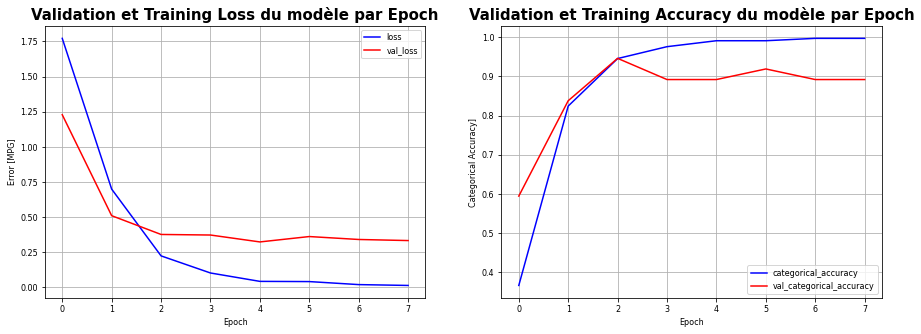

In [240]:
#Affichage des courbes d'évolution des loss et accuracy en fonction de l'epoch

plot_loss(history_large_bert_classifier)

Comme nous pouvons le constater, le modèle converge facilement au bout de huit epochs (et overfit au delà, un dropout en amont du classifier, et une régularisation peut aider à résoudre ce problème, mais ce n'est pas notre objectif ici).

In [241]:
#Construction du modèle d'embedding sans fine-tuning
bert_embedding_model = build_embedding_model()

In [242]:
#Inférence des deux modèles sur le jeu de données X_test
bert_embedding_X_test = []
fine_tuned_bert_embdedding_X_test = []

for i in X_test:
    fine_tuned_bert_embdedding_X_test.append(np.array(large_bert_classifier.layers[2](large_bert_classifier.layers[1]([i]))['pooled_output'][0]))
    bert_embedding_X_test.append(np.array(bert_embedding_model.layers[2](bert_embedding_model.layers[1]([i]))['pooled_output'][0]))

fine_tuned_bert_embdedding_df = pd.DataFrame(fine_tuned_bert_embdedding_X_test)
bert_embedding_X_test_df = pd.DataFrame(bert_embedding_X_test)

bert_embedding_X_test_df.sample(3)
fine_tuned_bert_embdedding_df.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
502,-0.785013,-0.893253,-0.668266,0.534007,-0.499031,-0.358771,0.897931,0.999184,0.964957,-0.996791,...,0.990266,0.968585,-0.070587,-0.951819,-0.319423,-0.870595,0.569440,0.996483,-0.999097,0.228556
336,-0.991715,0.805446,-0.002058,-0.419650,0.798963,-0.430796,-0.507986,-0.969888,-0.794669,0.963503,...,-0.816698,-0.952535,0.792944,0.669647,-0.759428,-0.771367,0.906793,0.963251,0.972145,0.281194
488,-0.590389,-0.959217,-0.823146,0.710975,-0.661409,-0.307470,0.858300,0.998834,0.989123,-0.997574,...,0.996050,0.970087,-0.629289,-0.931786,-0.084852,-0.937553,0.672499,0.997617,-0.999458,0.211657


PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 235
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.196
Perplexité : 20 - ARI : 0.123
Perplexité : 30 - ARI : 0.167
Perplexité : 40 - ARI : 0.123
Perplexité : 50 - ARI : 0.118
Perplexité : 60 - ARI : 0.122
Perplexité : 70 - ARI : 0.152
Perplexité : 80 - ARI : 0.094
Perplexité : 90 - ARI : 0.105
Perplexité : 100 - ARI : 0.108
Meilleur perplexité : 10
Adjusted Random Index : 0.196


(0.196704586712332, 10)

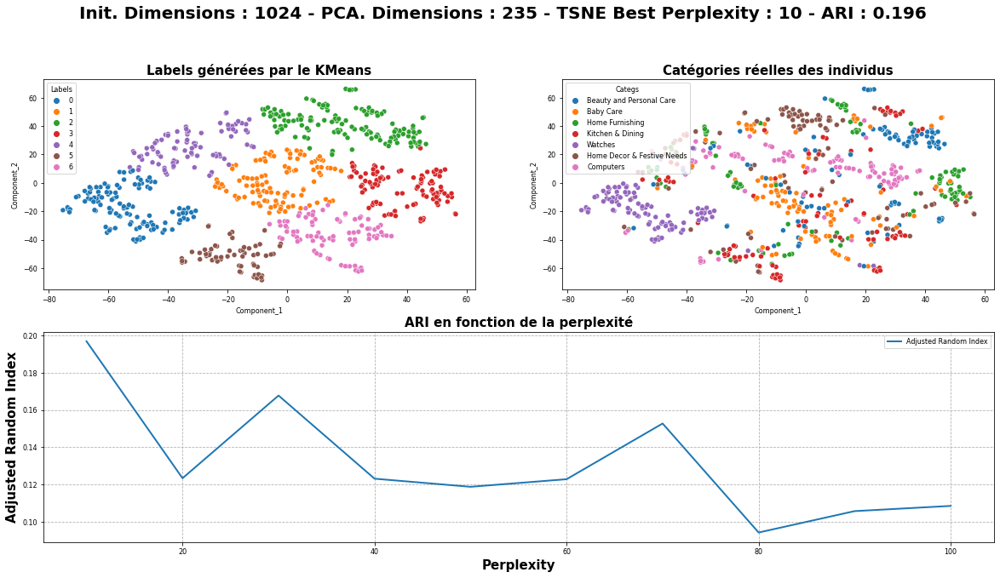

In [244]:
#Recherche de la meilleure valeur de perplexité pour le modèle d'embedding classique

PCA_TSNE_ARI_tuner_KM(bert_embedding_X_test_df, 0.99, 10, 100, 10, 7, y_test, False, True)

PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 231
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.702
Perplexité : 20 - ARI : 0.758
Perplexité : 30 - ARI : 0.755
Perplexité : 40 - ARI : 0.771
Perplexité : 50 - ARI : 0.779
Perplexité : 60 - ARI : 0.785
Perplexité : 70 - ARI : 0.783
Perplexité : 80 - ARI : 0.783
Perplexité : 90 - ARI : 0.787
Perplexité : 100 - ARI : 0.788
Perplexité : 110 - ARI : 0.791
Perplexité : 120 - ARI : 0.789
Perplexité : 130 - ARI : 0.789
Perplexité : 140 - ARI : 0.789
Perplexité : 150 - ARI : 0.787
Meilleur perplexité : 110
Adjusted Random Index : 0.791


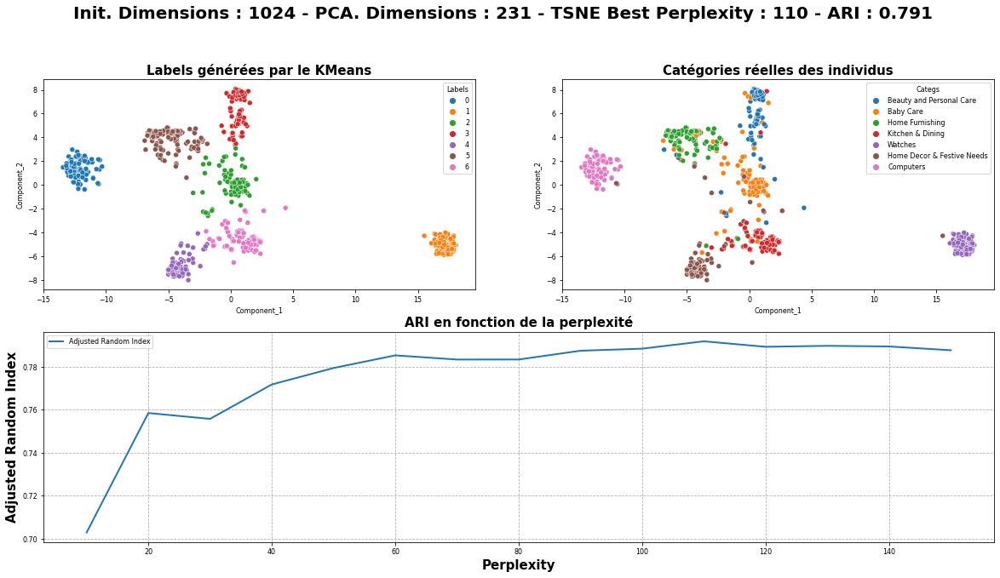

In [251]:
#Recherche de la meilleure valeur de perplexité pour le modèle d'embedding fine-tuned

bert_fine_tuned_ari, bert_fine_tuned_perp = PCA_TSNE_ARI_tuner_KM(fine_tuned_bert_embdedding_df, 0.99, 10, 150, 15, 7, y_test, False, False)

PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 231
---------
TSNE - perplexité : 110
---------
KM - Nombre de clusters : 7


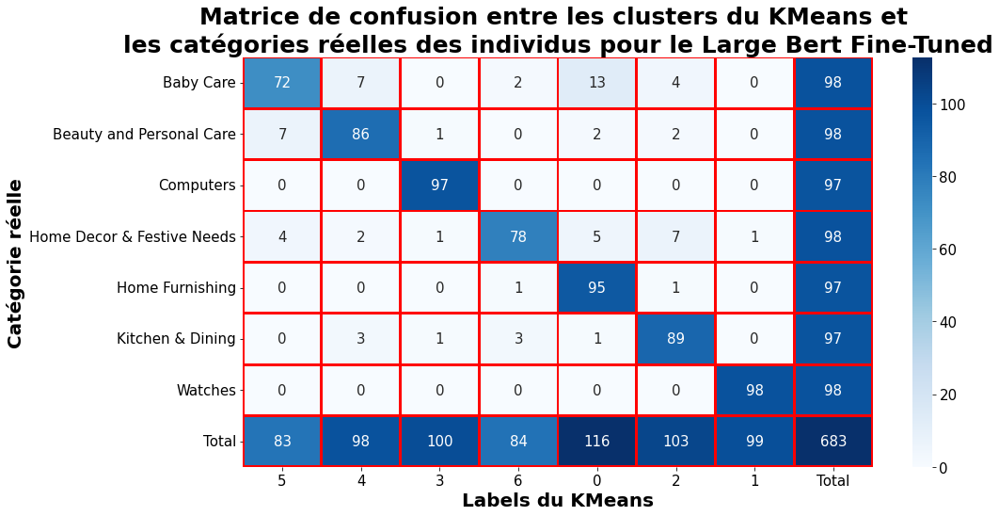

In [252]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_bert_ft = confusion_matrice_maker(fine_tuned_bert_embdedding_df, bert_fine_tuned_perp, 0.99, 7, y_test)
confusion_matrix_displayer(confusion_matrix_bert_ft, 'Large Bert Fine-Tuned')

## 5.7- Universal Sentence Encoder

Enfin, pour terminer la partie d'extraction de features des données textuelles, nous abordons l'approche Universal Sentence Encoder.

In [253]:
#Importation de Universal Sentences Encoder

use_encoder = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

In [254]:
#Extraction des features en utilisant USE

use_features = []

for i in final_df['description'].values:
    use_features.append(np.array(use_encoder([i])[0]))

use_features_df = pd.DataFrame(use_features)
use_features_df.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
735,-0.051438,-0.072351,-0.008227,0.031919,0.004705,0.060405,-0.021949,-0.008645,0.042419,-0.074022,...,-0.004748,-0.013475,-0.028568,0.056713,0.016228,0.026642,0.077170,0.013819,0.001945,-0.023207
185,-0.034248,-0.076781,0.010169,0.012293,0.056482,0.012442,0.010968,-0.032757,-0.002636,-0.074371,...,-0.040468,-0.057949,-0.022545,0.050319,0.019401,0.035814,0.070308,0.010141,0.029972,-0.065323
362,-0.051129,-0.052245,0.010446,0.053866,-0.019354,0.053375,-0.050840,-0.017578,-0.038029,-0.040350,...,0.030670,-0.054187,-0.052930,-0.053914,0.050239,-0.045428,0.053805,0.053049,0.000283,-0.053698


PCA -- Nombre de dimensions initiales : 512
PCA -- Nombre de composantes principales : 313
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.367
Perplexité : 20 - ARI : 0.413
Perplexité : 30 - ARI : 0.412
Perplexité : 40 - ARI : 0.395
Perplexité : 50 - ARI : 0.410
Perplexité : 60 - ARI : 0.422
Perplexité : 70 - ARI : 0.428
Perplexité : 80 - ARI : 0.418
Perplexité : 90 - ARI : 0.425
Perplexité : 100 - ARI : 0.373
Meilleur perplexité : 70
Adjusted Random Index : 0.428


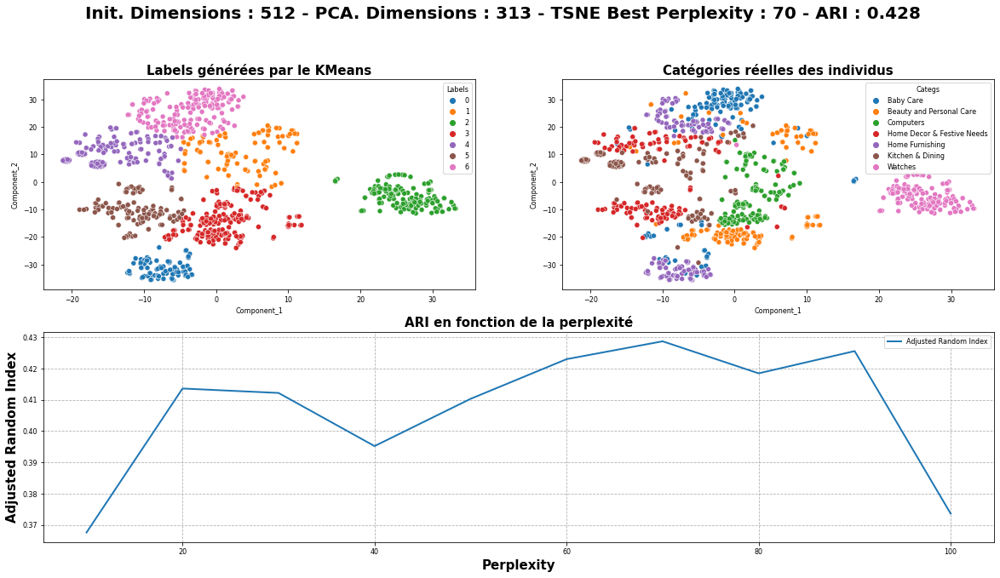

In [255]:
#Recherhce de la meilleure valeur de perplexité pour le modèle d'embedding fine-tuned

use_ari, use_perp = PCA_TSNE_ARI_tuner_KM(use_features_df, 0.99, 10, 100, 10, 7, categories, False, True)

PCA -- Nombre de dimensions initiales : 512
PCA -- Nombre de composantes principales : 308
---------
TSNE - perplexité : 70
---------
KM - Nombre de clusters : 7


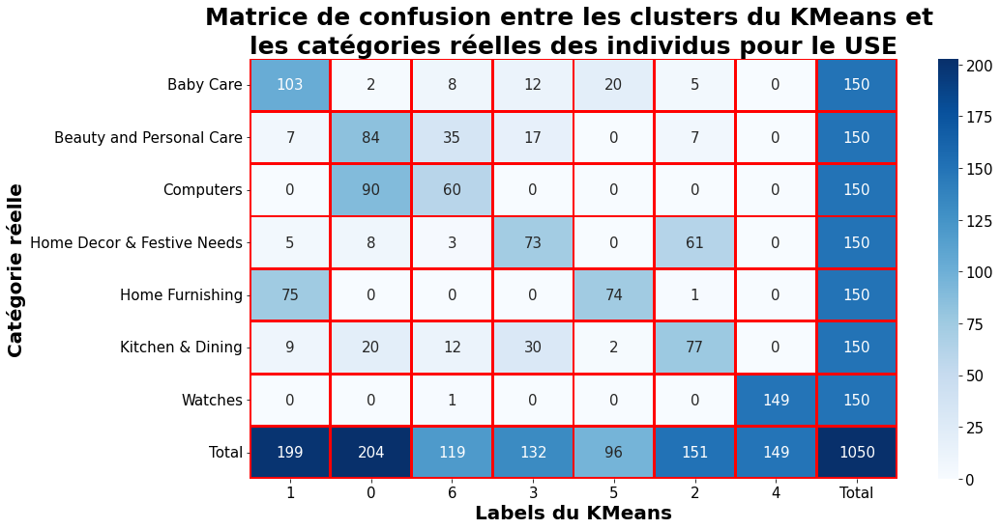

In [256]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_bert_ft = confusion_matrice_maker(use_features_df, use_perp, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_bert_ft, 'USE')

Text(0.5, 1.0, 'Cosine Similarity entre les individus: \n Espace de redéscription de USE')

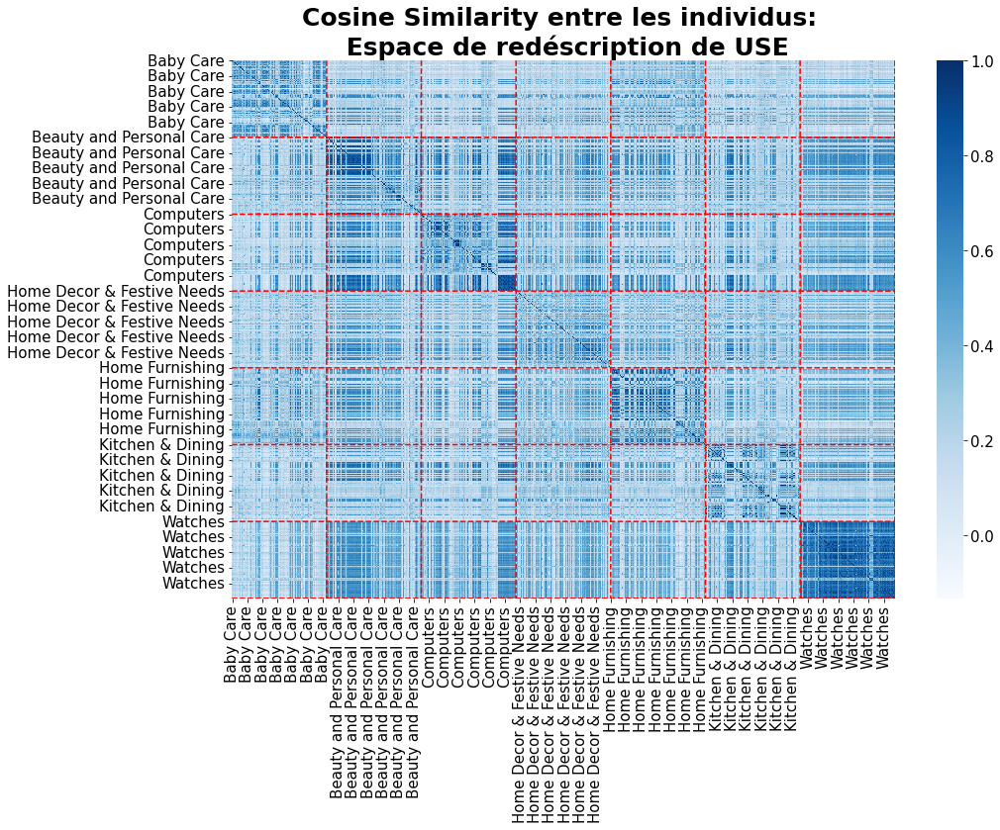

In [257]:
#Mise en place de la matrice de similarité entre les individus

cosine_matrix_use = cosine_similarity_maker(use_features_df, categories)

#Affichage de la matrice de similarités pour le word2vec fine-tuned

plt.rcParams.update({'font.size' : 15})
plt.figure(figsize = (15,10))
sns.heatmap(cosine_matrix_use, cmap = 'Blues')
for i in range(7):
    plt.plot(np.full((1050), (i + 1)*150), np.linspace(0, 1050, 1050), color = 'red', ls = '--')
    plt.plot(np.linspace(0, 1050, 1050), np.full((1050), (i + 1)*150), color = 'red', ls = '--')
plt.title('Cosine Similarity entre les individus: \n Espace de redescription de USE', size = 25, weight = 'bold')

# 6- Features Extraction d'images

  De la même manière que pour la partie traitement de texte sur les descriptions des produits, nous allons utiliser différentes approches pour extraire des features des différentes images disponibles dans notre jeu de données.
    
  De cette manière, nous pourrons décrire chaque individu en utilisant les features extraits, puis effectuer une réduction dimensionnelle, et un clustering sur l'espace à dimensions réduites de manière à mettre en avant plusieurs clusters, et mesurer l'adjusted random index entre les étiquettes des différents clusters et les catégories réelles des individus.

## 6.1- Features extraction en utilisant SIFT

In [109]:
#Définition du chemin d'accès

path = "gdrive/MyDrive/P6/Images/"
files = final_df['image'].values
print('Images disponibles : {}'.format(len(files)))

Images disponibles : 1050


In [110]:
#Importation de librairies supplémentaires

import cv2
from cv2 import SIFT
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import MiniBatchKMeans

In [260]:
#Nous créons ensuite 7 listes d'images correspondants aux images des différentes catégories de produits

list_categ = final_df['categs'].unique()
list_types = []
for i in list_categ:
    tmp = str(i).replace(' ', '_')
    locals()[tmp] = final_df.loc[final_df['categs'] == i, 'image'].values
    list_types.append(tmp)

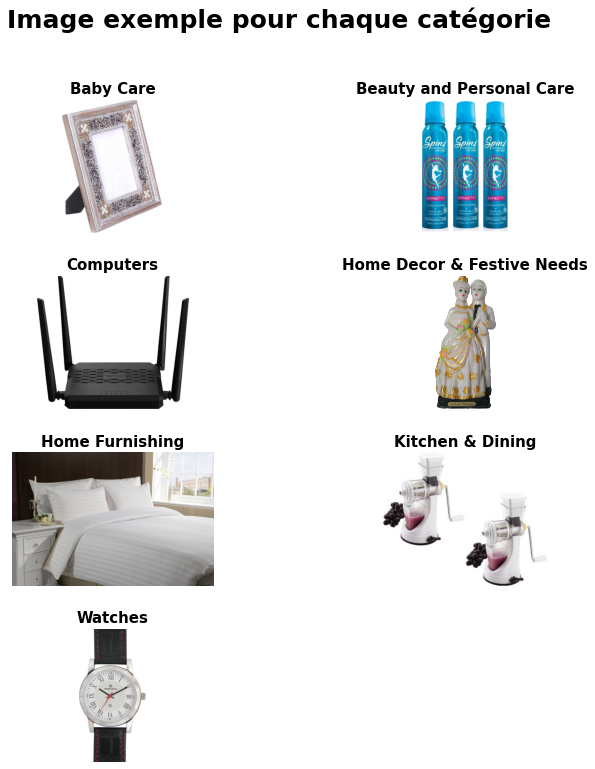

In [261]:
#Affichage d'une image exemple prise au hasard pour chaque catégorie

fig, axes = plt.subplots(4, 2, figsize = (10,10))
fig.tight_layout(pad=1)
fig.suptitle('Image exemple pour chaque catégorie', size = 25, weight = 'bold', y = 1.1)
plt.delaxes(axes[-1, -1])
for name, i, ax in zip(list_categ, range(len(list_types)), axes.ravel()):
    n = np.random.randint(150)
    pic = plt.imread(path + locals()[list_types[i]][n])
    ax.imshow(pic)
    ax.axis('off')
    ax.set_title('{}'.format(name), size = 15, weight = 'bold')

  Dans un premier temps, nous pouvons utiliser une image prise au hasard dans notre jeu de données afin de visualiser les différents traitements à mettre en place.

In [262]:
#Fonction d'affichage aléatoire d'une image avec les différents channels

def random_image_displayer():
    random_index = np.random.randint(len(files))
    random_image = cv2.imread(path + files[random_index])
    channels = ['Red', 'Green', 'Blue', 'All']
    fig, axes = plt.subplots(1, 4, figsize = (20,5))
    fig.tight_layout(pad = 2)
    for i, ax, chan in zip(range(4), axes.ravel(), channels):
        if i < 3:
            ax.imshow(random_image[:, :, i], cmap = 'gray')
            ax.set_title('{} channel'.format(chan), weight = 'bold', color = chan.lower())
            ax.margins(10)
            ax.axis('off')
        else:
            ax.imshow(random_image)
            ax.set_title('{} channels'.format(chan), weight = 'bold')
            ax.axis('off')
            ax.margins(10)

In [111]:
def image_displayer(n):
    if (n < len(files)):
        image = cv2.imread(path + files[n])
        gray = cv2.imread(path + files[n], 0)
        equalized = cv2.equalizeHist(gray)
        channels = ['Red', 'Green', 'Blue', 'All', 'Equalized', 'Edges']
        kernel_edges = np.array([[-1,-1,-1], 
                           [-1,8,-1], 
                           [-1,-1,-1]])
        edges = cv2.filter2D(src=gray, ddepth=-1, kernel=kernel_edges)
        fig, axes = plt.subplots(2, 3, figsize = (20,10))
        fig.tight_layout(pad = 2)
        for i, ax, chan in zip(range(6), axes.ravel(), channels):
            if i < 3:
                ax.imshow(image[:, :, i], cmap = 'gray')
                ax.set_title('{} channel'.format(chan), weight = 'bold', color = chan.lower())
                ax.axis('off')
            elif i == 3:
                ax.imshow(image)
                ax.set_title('{} channels'.format(chan), weight = 'bold')
                ax.axis('off')
            elif i == 4:
                ax.imshow(equalized, cmap = 'gray')
                ax.set_title('{} image'.format(chan), weight = 'bold')
                ax.axis('off')
            elif i == 5:
                ax.imshow(edges, cmap = 'gray')
                ax.set_title('{} detection'.format(chan), weight = 'bold')
                ax.axis('off')
    else:
            print('Please select a number below : {}'.format(len(files)))

In [264]:
#Fonction d'affichage des histograms d'images

def hist_plotter(n):
    if n < 1050:
        image = cv2.imread(path + files[n]) 
        gray = cv2.imread(path + files[n], 0)
        equalized = cv2.equalizeHist(gray)
        fig, axes = plt.subplots(2, 2, figsize = (20,10))
        for i, ax in zip(range(4), axes.ravel()):
            if i == 0:
                ax.imshow(gray, cmap = 'gray')
                ax.axis('off')
                ax.set_title('GrayScale Image', size = 20, weight = 'bold')
            elif i == 1:
                ax.imshow(equalized, cmap = 'gray')
                ax.axis('off')
                ax.set_title('Equalized Image', size = 20, weight = 'bold')
            elif i == 2:
                h1 = ax.hist(gray.flatten(), bins = 100)
                ax.set_title('Histogramme image originale', size = 20, weight = 'bold')
                ax.set_xlabel('Grey Level', size = 10, weight = 'bold')
                ax.set_ylabel('Count')
                ax.grid(True, ls = '--')
            elif i == 3:
                h1 = ax.hist(equalized.flatten(), bins = 100)
                ax.set_title('Histogramme image égalisée', size = 20, weight = 'bold')
                ax.set_xlabel('Grey Level', size = 10, weight = 'bold')
                ax.set_ylabel('Count')
                ax.grid(True, ls = '--')

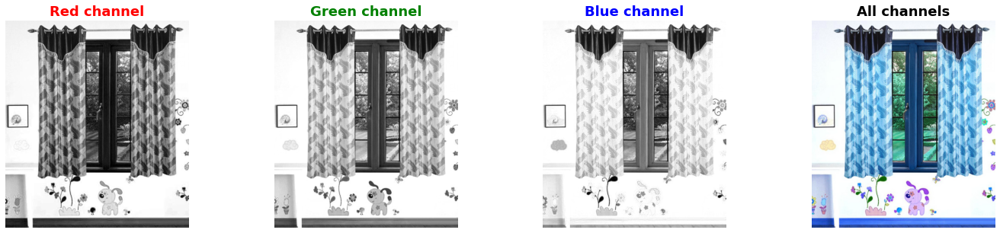

In [265]:
#Essai de la fonction

random_image_displayer()

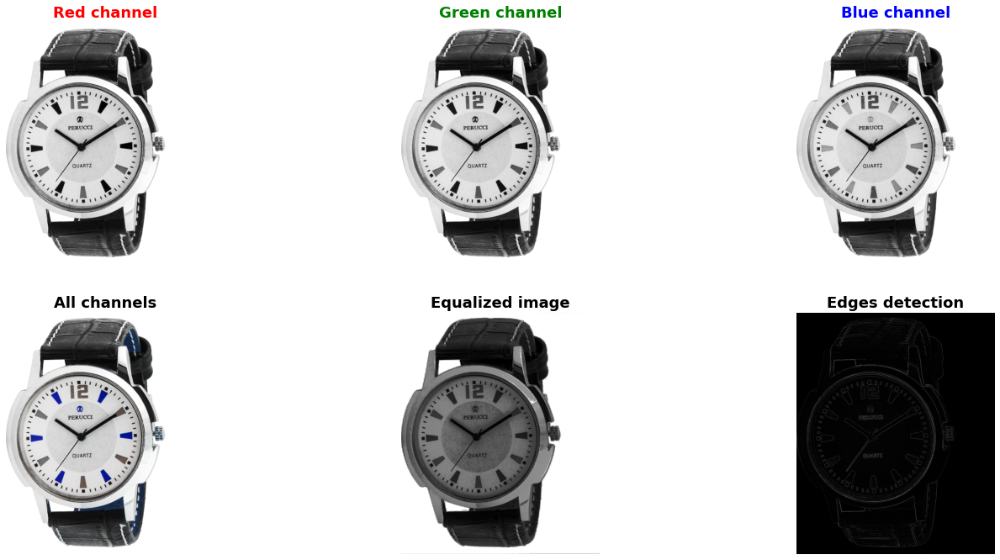

In [266]:
#Nous prennons une image sur laquelle nous allons effectuer différents traitements

image_displayer(950)

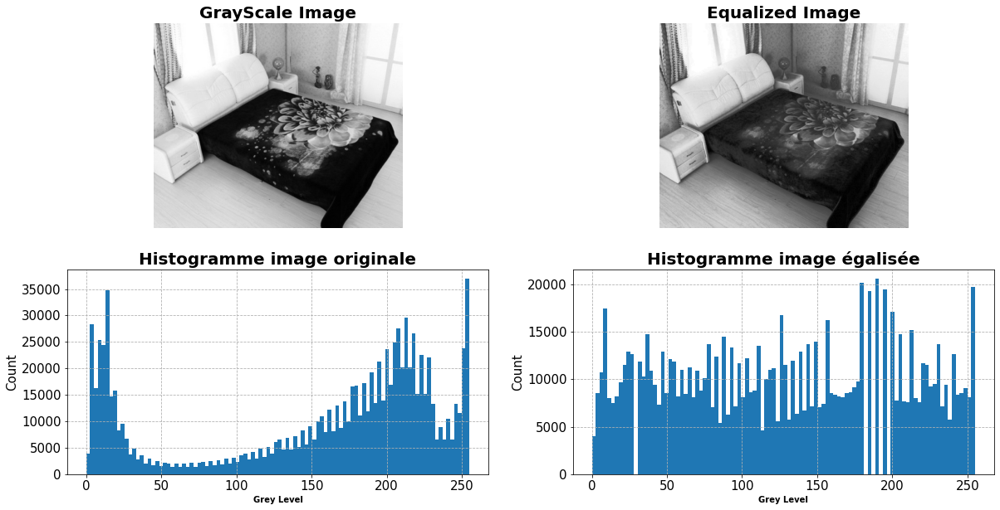

In [267]:
#Utilisation de la fonction de comparaison image originale et égalisée

hist_plotter(700)

In [268]:
#Fonction de mise en place des descripteurs et d'affichage des keypoints en utilisant l'algorithme SIFT

def sift_desc_kp_display(n):
    image = cv2.imread(path + files[n])
    gray = cv2.imread(path + files[n], 0)
    equalized = cv2.equalizeHist(gray)
    sift = cv2.SIFT_create()
    keypoints, des = sift.detectAndCompute(equalized, None)
    final_img = cv2.drawKeypoints(image, keypoints, gray, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    fig, axes = plt.subplots(1, 3, figsize = (20,10))
    for i, ax in zip(range(3), axes.ravel()):
        if i == 0:
            ax.imshow(image)
            ax.set_title('Color Image', size = 20, weight = 'bold')
            ax.axis('off')
        elif i == 1:
            ax.imshow(equalized, cmap = 'gray')
            ax.set_title('Equalized Image', size = 20, weight = 'bold')
            ax.axis('off')
        elif i == 2:
            ax.imshow(final_img)
            ax.set_title('Image with SIFT features', size = 20, weight = 'bold')
            ax.axis('off')
    fig.suptitle('{} Keypoints détectés'.format(des.shape[0]), size = 25, weight = 'bold', y = 0.9)
    plt.show()
    

In [269]:
#Fonction rtournant l'image égalisée

def equalized_returner(n):
    gray = cv2.imread(path + files[n], 0)
    equalized = cv2.equalizeHist(gray)
    return equalized

In [270]:
#Fonction retournant les keypoints

def sift_kp_returner(equalized):
    sift = cv2.SIFT_create()
    keypoints = np.array(sift.detect(equalized, None))
    return keypoints

In [271]:
#Fonction retournant les descripteurs

def sift_desc_returner(n):
    sift = cv2.SIFT_create()
    image = cv2.imread(path + files[n])
    gray = cv2.imread(path + files[n], 0)
    equalized = cv2.equalizeHist(gray)
    keypoints, des = sift.detectAndCompute(equalized, None)
    del keypoints
    return des

In [272]:
#Fonction affichant la différence des gaussiennes

def DoG_displayer(n, kernel_size, sigma, n_DoG):
    image = cv2.imread(path + files[n])
    gray = cv2.imread(path + files[n], 0)
    equalized = cv2.equalizeHist(gray)
    fig, axes = plt.subplots(1, n_DoG,  figsize = (30,10))
    fig.suptitle('SIFT Principle - Difference of Gaussians', size = 25, weight = 'bold', y = 0.75)
    for i, ax in zip(range(n_DoG), axes.ravel()):
        im1 = cv2.GaussianBlur(image,(kernel_size,kernel_size),sigma)
        im2 = cv2.GaussianBlur(image,(kernel_size,kernel_size),sigma*i)
        dif = im1 - im2
        ax.imshow(dif, cmap = 'gray')
        ax.axis('off')
        ax.set_title('Octave {}'.format(i + 1), size = 15, weight = 'bold')

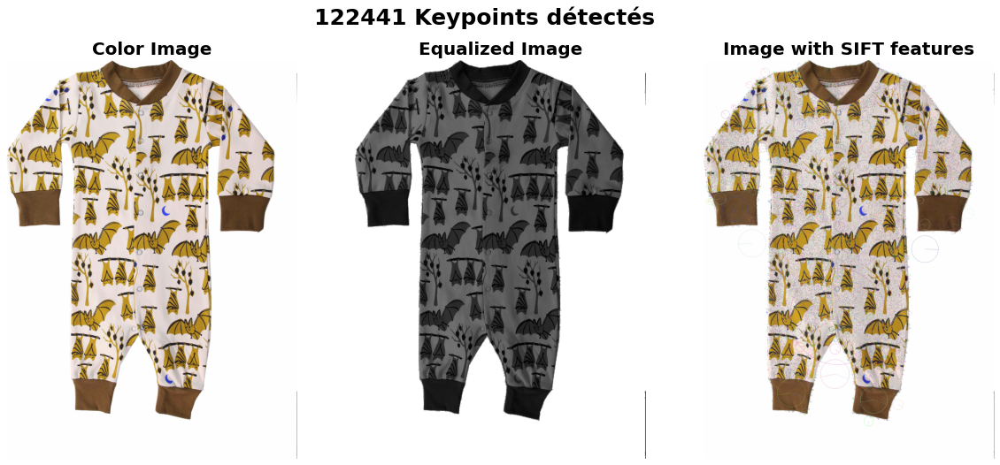

In [273]:
#Affichage des keypoints de la 51-ième image

sift_desc_kp_display(50)

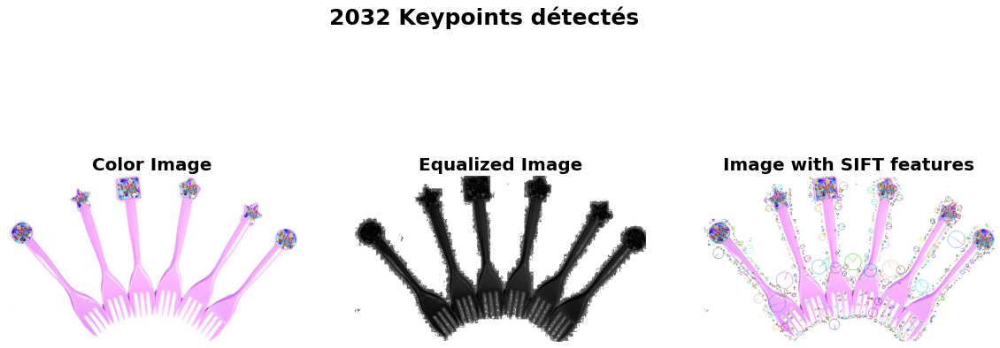

In [274]:
#Affichage des keypoints de la 70ième image

sift_desc_kp_display(70)

Pour extraire les Keypoints, Sift utilise la différence des Gaussiennes sur des images de manière à mettre en évidence des points d'intérêt, puis à les décrire.

Nous pouvons mettre en évidence la différence des Gaussiennes sur une image en particulier.

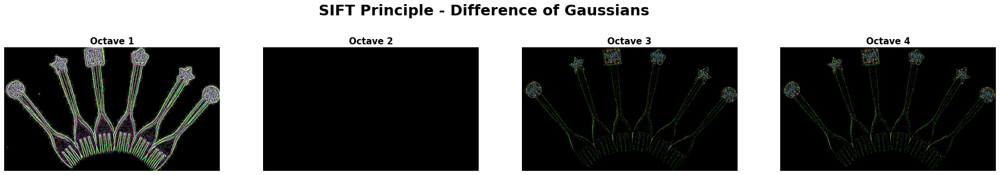

In [276]:
#Affichage de 4 différences de filtres gaussiens pour l'image 70

DoG_displayer(70, 5, 5, 4)

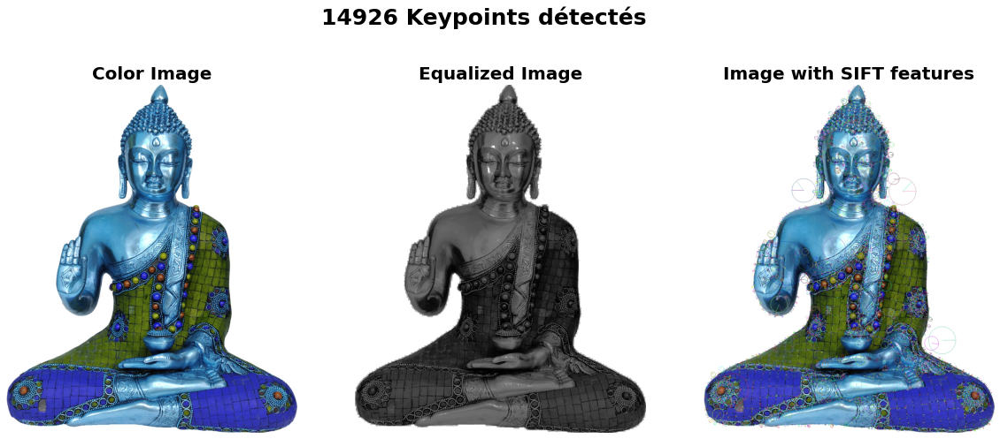

In [277]:
#Affichage des keypoints de la 520ième image

sift_desc_kp_display(520)

In [278]:
#Extraction des keypoints pour chaque image

sift_kp = np.array([])
sift_kp = np.array([sift_desc_returner(x) for x in final_df.index])

#Concaténation des keypoints

all_sift_keypoints = np.concatenate(sift_kp)
all_sift_keypoints.shape

(9051347, 128)

In [279]:
# Détermination du nombre de clusters - racine 

k = int(round(np.sqrt(len(all_sift_keypoints)),0))
print("Nombre de clusters estimés : ", k)

# Clustering - Utilisation de MiniBatchKMeanse
kmeans = MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=11)
kmeans.fit(all_sift_keypoints)


Nombre de clusters estimés :  3009


MiniBatchKMeans(init_size=9027, n_clusters=3009, random_state=11)

In [280]:
#Fonction de construction des histogrammes

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist

In [281]:
# Création de la matrice des histogrammes
hist_vectors=[]

for i, image_desc in enumerate(sift_kp) :
    hist = build_histogram(kmeans, image_desc, i)
    hist_vectors.append(hist)

im_features = np.asarray(hist_vectors)
im_features_df = pd.DataFrame(im_features)

In [282]:
#Affichage de quelques valeurs

im_features_df.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,2999,3000,3001,3002,3003,3004,3005,3006,3007,3008
835,0.000060,0.000179,0.000537,0.000239,0.000298,0.000298,0.000298,0.000358,0.000239,0.000418,...,0.000060,0.000119,0.000358,0.000179,0.000119,0.000418,0.001015,0.000716,0.000537,0.000537
141,0.000000,0.000302,0.000302,0.000172,0.000560,0.000172,0.000431,0.000129,0.000043,0.000302,...,0.000345,0.000345,0.000259,0.000172,0.000129,0.000431,0.000259,0.000216,0.000129,0.000388
346,0.005556,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001852,0.000000,0.000926,0.000000


PCA -- Nombre de dimensions initiales : 3009
PCA -- Nombre de composantes principales : 883
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.012
Perplexité : 20 - ARI : 0.009
Perplexité : 30 - ARI : 0.008
Perplexité : 40 - ARI : 0.009
Perplexité : 50 - ARI : 0.012
Perplexité : 60 - ARI : 0.006
Perplexité : 70 - ARI : 0.010
Perplexité : 80 - ARI : 0.010
Perplexité : 90 - ARI : 0.009
Perplexité : 100 - ARI : 0.008
Meilleur perplexité : 10
Adjusted Random Index : 0.013


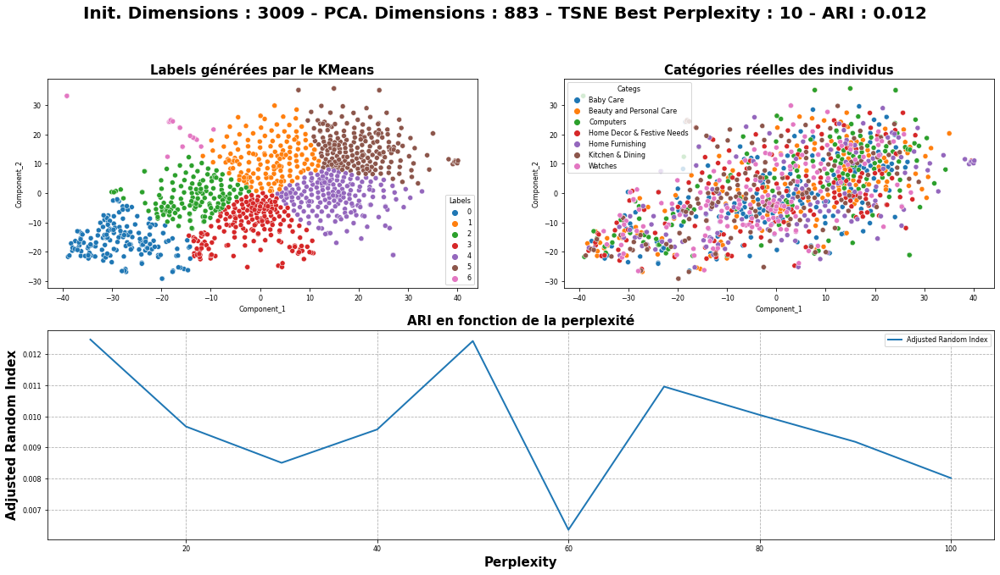

In [283]:
#Recherche de la meilleure perplexité et clustering

ari_sift, perp_sift = PCA_TSNE_ARI_tuner_KM(im_features_df, 0.99, 10, 100, 10, 7, categories, False, True)

PCA -- Nombre de dimensions initiales : 3009
PCA -- Nombre de composantes principales : 739
---------
TSNE - perplexité : 10
---------
KM - Nombre de clusters : 7


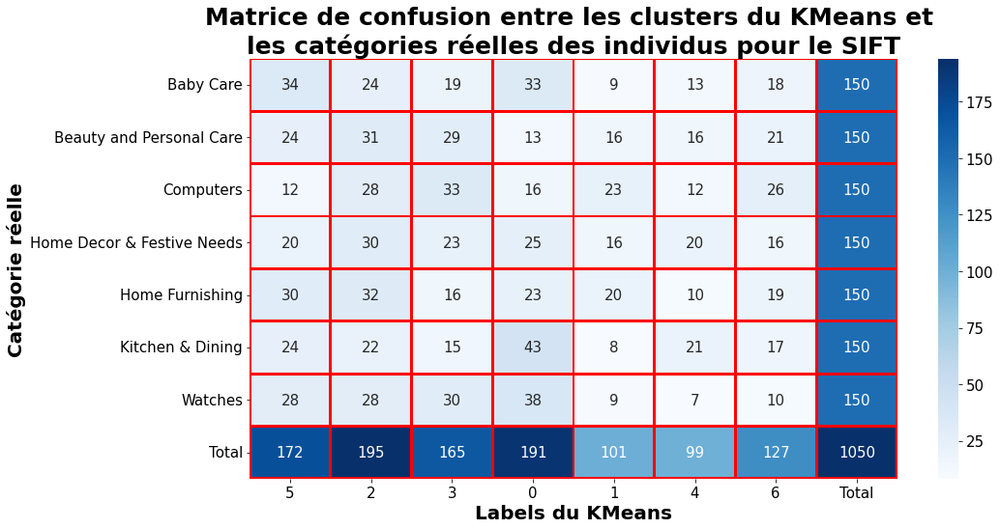

In [284]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_sift = confusion_matrice_maker(im_features_df, perp_sift, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_sift, 'SIFT')

In [285]:
#Mise en place de la matrice de similarité entre les individus

cosine_matrix_sift = cosine_similarity_maker(im_features_df, categories)
cosine_matrix_sift.sample(3)

,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,Baby Care,...,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches,Watches
Baby Care,0.366495,0.199010,0.171117,0.282578,0.304688,0.057934,0.324655,0.272180,0.263983,0.047366,...,0.264690,0.344450,0.324218,0.351025,0.271736,0.307760,0.341974,0.301254,0.274630,0.277285
Baby Care,0.157623,0.057885,0.041092,0.167804,0.177825,0.035235,0.166456,0.112934,0.305037,0.040330,...,0.141872,0.276442,0.333524,0.197314,0.163366,0.256754,0.165663,0.130873,0.316134,0.112959
Kitchen & Dining,0.221555,0.309848,0.300130,0.322314,0.406772,0.053643,0.398298,0.193952,0.178364,0.045130,...,0.402097,0.327828,0.243480,0.477657,0.402210,0.387185,0.596211,0.366129,0.399521,0.288218


Text(0.5, 1.0, 'Cosine Similarity entre les individus')

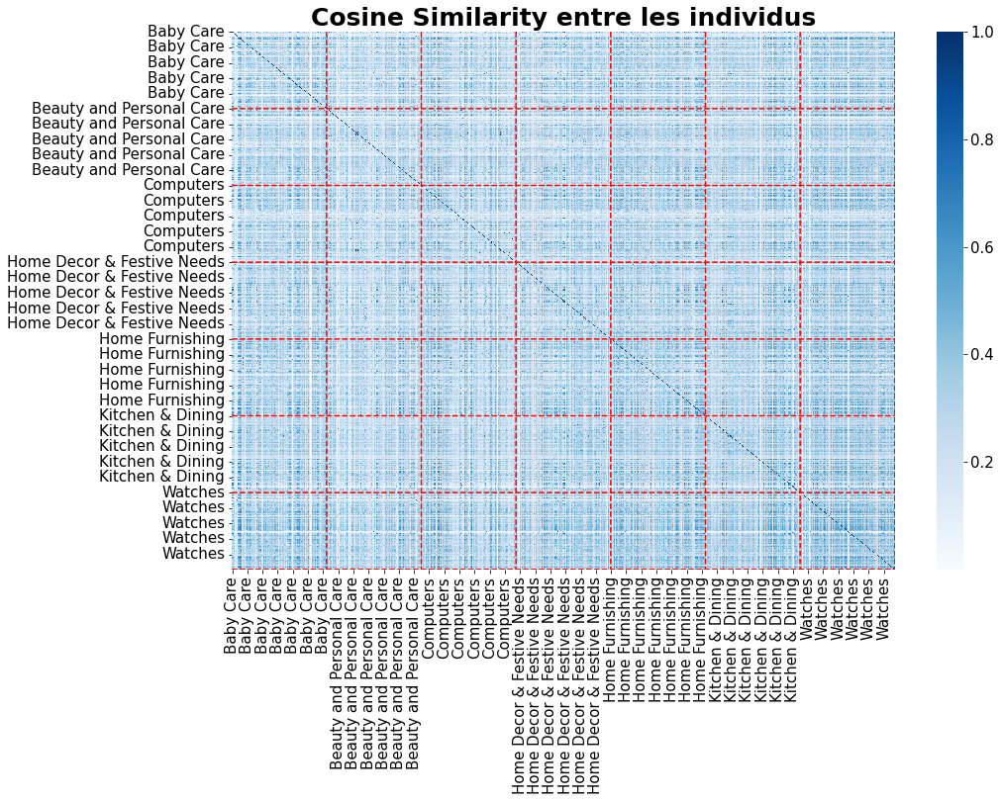

In [286]:
#Affichage de la matrice de similarités

plt.rcParams.update({'font.size' : 15})
plt.figure(figsize = (15,10))
sns.heatmap(cosine_matrix_sift, cmap = 'Blues')
for i in range(7):
    plt.plot(np.full((1050), (i + 1)*150), np.linspace(0, 1050, 1050), color = 'red', ls = '--')
    plt.plot(np.linspace(0, 1050, 1050), np.full((1050), (i + 1)*150), color = 'red', ls = '--')
plt.title('Cosine Similarity entre les individus', size = 25, weight = 'bold')

## 6.2- Quelques résultats intéressants avec VGG16

  Avant de procéder à la partie features extraction en utilisant des modèles de deep learniong, nous nous attardons un instant sur quelques résulats intéressant en utilisant le modèle VGG16.

In [129]:
#Importation des librairies supplémentaires

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.utils import load_img
from tensorflow.keras.utils import img_to_array
from keras.applications import vgg16
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16
from keras import Sequential

In [122]:
#Importation de VGG16 complet avec les poids imagenet

Full_vgg16 = VGG16(weights = 'imagenet', input_shape = (224,224,3), include_top = True)
Full_vgg16.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

  Nous pouvons sélectionner une image en particulier de manière à afficher certains outputs des différentes couches de notre modèle.
    
  Dans notre cas, nous allons nous intéresser particulièrement aux couches de MaxPooling, de manière à récupérer des couches aux dimensions réduites.

In [123]:
#Fonction d'affichage d'une image resized en 224x224x3

def resized_preprocess_diplayer(n):
    image = load_img(path + files[n], target_size = (224,224))
    plt.figure(figsize = (10,5))
    plt.rcParams.update({'font.size' : 12})
    plt.title('Image {} resized 224x224x3'.format(n), size = 15, weight = 'bold')
    plt.imshow(image)
    plt.axis('off')

In [124]:
#Fonction d'affichage d'une image preprocessed pour VGG16

def vgg16_preprocess_diplayer(n):
    image = load_img(path + files[n], target_size = (224,224))
    array = img_to_array(image)
    reshaped = array.reshape((1, array.shape[0], array.shape[1], array.shape[2]))
    preprocessed = tf.keras.applications.vgg16.preprocess_input(reshaped)
    plt.figure(figsize = (10,5))
    plt.rcParams.update({'font.size' : 12})
    plt.title('Image {} preprocessed pour VGG16'.format(n), size = 15, weight = 'bold')
    plt.imshow(preprocessed[0])
    plt.axis('off')

In [125]:
#Fonction d'affichage d'une image preprocessed pour mobilenet

def mobilenet_preprocess_diplayer(n):
    image = load_img(path + files[n], target_size = (224,224))
    array = img_to_array(image)
    reshaped = array.reshape((1, array.shape[0], array.shape[1], array.shape[2]))
    preprocessed = tf.keras.applications.mobilenet.preprocess_input(reshaped)
    plt.figure(figsize = (10,5))
    plt.rcParams.update({'font.size' : 12})
    plt.title('Image {} preprocessed pour MobileNet'.format(n), size = 15, weight = 'bold')
    plt.imshow(preprocessed[0])
    plt.axis('off')

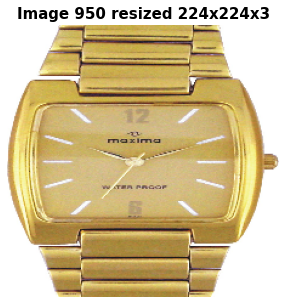

In [126]:
resized_preprocess_diplayer(950)

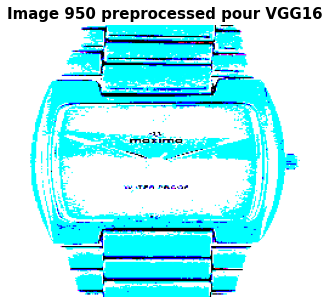

In [127]:
vgg16_preprocess_diplayer(950)

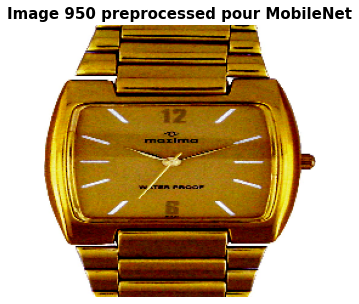

In [128]:
mobilenet_preprocess_diplayer(950)

In [130]:
#Affichage du nombre de couches de pooling

Is_pool_list = []
for i in Full_vgg16.layers:
    str_layer = str(i)
    Is_pool_list.append('pool' in str_layer)
Is_pool_list = pd.DataFrame(Is_pool_list)
print('Le modèle contient {} couches de MaxPooling.'.format(Is_pool_list.sum()[0]))

Le modèle contient 5 couches de MaxPooling.


In [131]:
#Fonction d'affichage de quelques outputs des couches de pooling pour une image en particulier

def pool_outputs_returner(n):
    Is_pool_list = []
    for i in Full_vgg16.layers:
        str_layer = str(i)
        Is_pool_list.append('pool' in str_layer)
    Is_pool_list = pd.DataFrame(Is_pool_list)
    nb_pooling = Is_pool_list.sum()[0]

    image = load_img(path + files[n], target_size = (224,224))
    array = img_to_array(image)
    reshaped = array.reshape((1, array.shape[0], array.shape[1], array.shape[2]))
    preprocessed = preprocess_input(reshaped)
    
    L = []
    Layers = []
    Image_index = []
    for i in range(len(Full_vgg16.layers)):
        if 'pool' in (str(Full_vgg16.layers[i])):
            Seq = Sequential()
            output_shape = Full_vgg16.layers[i].output_shape
            nb_conv_filters = output_shape[-1]
            extracted_samples = np.linspace(0, nb_conv_filters-1, 5).astype(int)
            for j in Full_vgg16.layers[:i]:
                Seq.add(j)
            for p in extracted_samples:
                Layers.append(i)
                L.append(Seq(preprocessed)[0][:, :, p])
                Image_index.append(p)
                
    fig, axes = plt.subplots(nb_pooling, 5, figsize = (15,15))
    fig.tight_layout(pad = 0.2)
    fig.suptitle('VGG16 - Pooling Feature Mapping - Image numero {}'.format(n), size = 30, weight = 'bold', y = 1.05)
    for k, ax in zip(range(len(L)), axes.ravel()):
        ax.imshow(L[k], cmap = 'gray')
        ax.axis('off')
        ax.set_title('Layer : {} - Filter {}'.format(Layers[k], Image_index[k]), size = 15, weight = 'bold')
    fig.show()

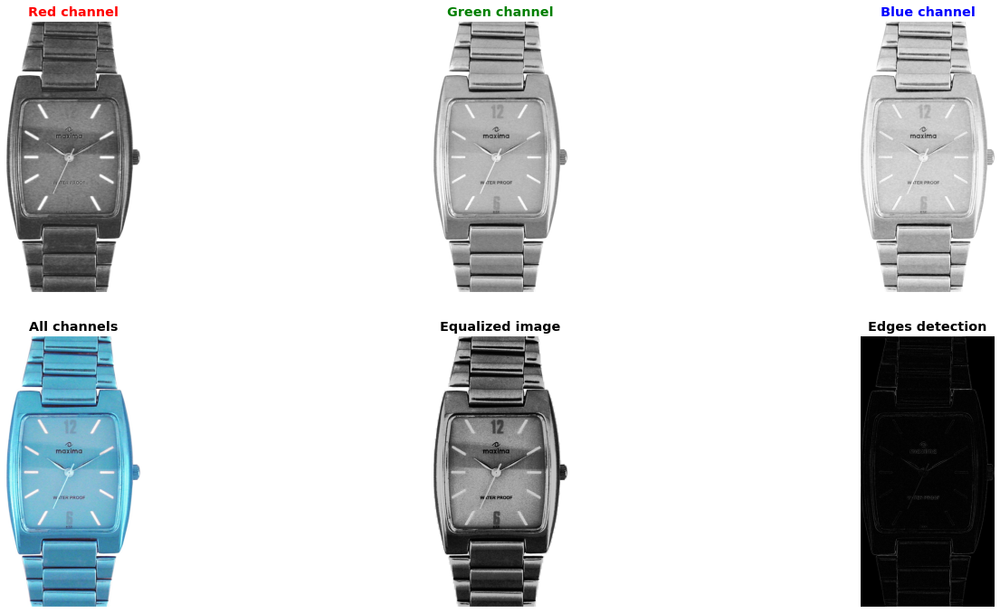

In [134]:
#Affichage de l'image 950

image_displayer(950)

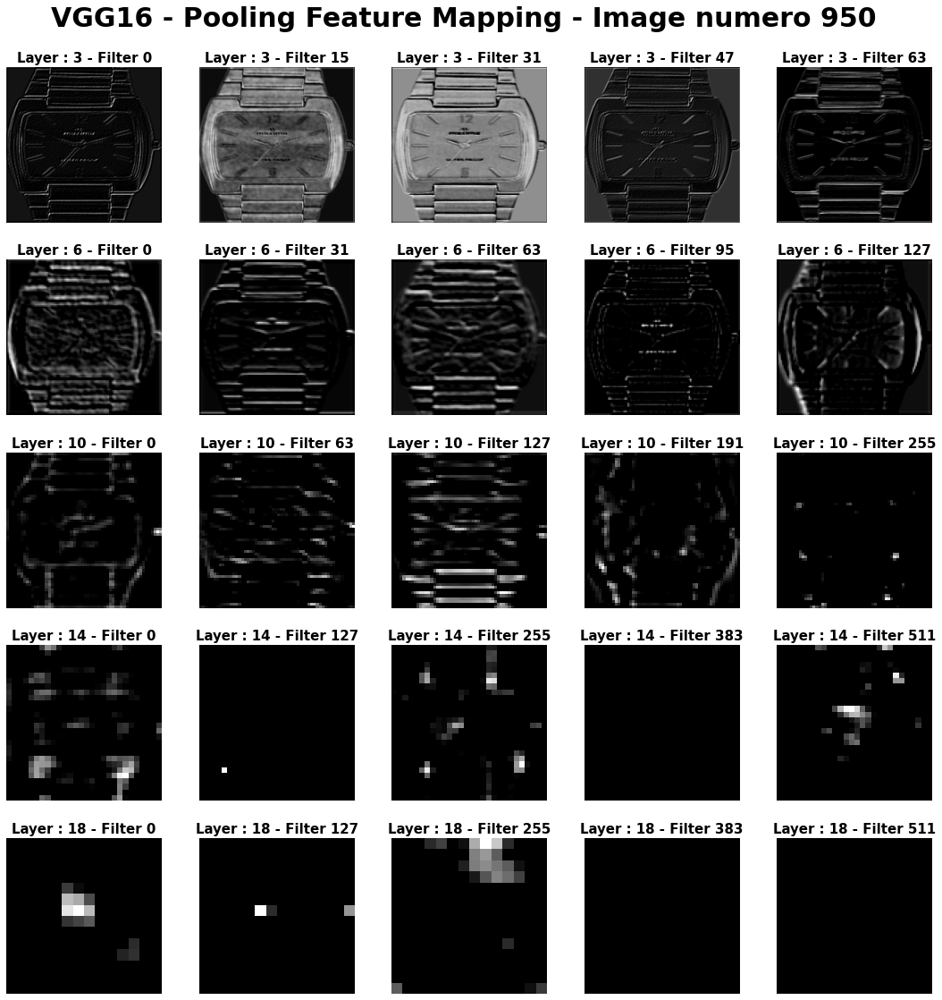

In [135]:
#Echantillons de sorties de l'image 950 en fonction de la couche de MaxPooling - Features Mapping

pool_outputs_returner(950)

## 6.3- Features extractions de différents CNN sans FC-Layers

  Dans cette partie, nous allons essayer d'éffectuer plusieurs feature extractions de différents modèle disponibles dans la librairies applications de l'API keras, afin de décrire chaque individu dans un nouvel espace, et effectuer une réduction dimensionnelle et un clustering.

  Les poids des différents modèles seront ceux du pré-entraînement sur le jeu de données imagenet. Dans le cas de vgg16, mettons en place une dernière couche d'average pooling pour passer d'un output de la forme (7,7,512) à (1, 1, 512).
    
  Cela nous permet de réduire une première fois le nombre de dimensions, tout en conservant l'information principale des 512 matrices de taille 7 par 7.

In [130]:
#Fonction de pré-processing des images

def vgg16_preprocess(n):
    image = load_img(path + final_df['image'][n], target_size = (224,224))
    array = img_to_array(image)
    reshaped = array.reshape((1, array.shape[0], array.shape[1], array.shape[2]))
    preprocessed = vgg16.preprocess_input(reshaped)
    return preprocessed

In [137]:
#Essai avec vgg16

vgg16_bottom = VGG16(weights = 'imagenet', input_shape = (224,224,3), include_top = False, pooling = 'avg')

In [131]:
final_df['index'] = final_df.index
final_df['vgg16_input'] = final_df['index'].swifter.apply(lambda x : vgg16_preprocess(x))

Dask Apply:   0%|          | 0/16 [00:00<?, ?it/s]

In [139]:
#Application du modèle en inférence sur chaque individu

vgg16_bottom_outputs = []
for i in final_df['vgg16_input'].values:
    vgg16_bottom_outputs.append(vgg16_bottom(i))

In [140]:
#Mise en place du DataFrame

vgg16_bottom_outputs = pd.DataFrame(np.array(vgg16_bottom_outputs).reshape(1050,512))
vgg16_bottom_outputs.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
299,0.000000,2.401131,0.000000,0.000000,4.584990,0.294525,0.0,0.000000,0.000000,0.381862,...,0.269343,0.000000,0.045141,15.539025,0.000000,0.000000,0.536292,0.811913,1.015489,0.0
485,0.000000,40.163708,9.424372,3.160237,0.470351,0.818206,0.0,4.827088,3.913434,6.599797,...,0.297246,1.733729,2.606853,0.000000,0.237857,0.062236,0.837443,0.558421,0.000000,0.0
512,2.981023,3.437140,7.638627,10.141649,2.440526,2.342987,0.0,0.000000,0.773221,0.583809,...,0.408683,2.286377,2.098517,0.000000,0.361547,0.000000,0.000000,0.000000,1.238244,0.0


PCA -- Nombre de dimensions initiales : 512
PCA -- Nombre de composantes principales : 351
----------

TSNE -- Essais de 10 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 100
----------

Perplexité : 10 - ARI : 0.367
Perplexité : 20 - ARI : 0.417
Perplexité : 30 - ARI : 0.427
Perplexité : 40 - ARI : 0.369
Perplexité : 50 - ARI : 0.449
Perplexité : 60 - ARI : 0.366
Perplexité : 70 - ARI : 0.455
Perplexité : 80 - ARI : 0.421
Perplexité : 90 - ARI : 0.486
Perplexité : 100 - ARI : 0.415
Meilleur perplexité : 90
Adjusted Random Index : 0.489


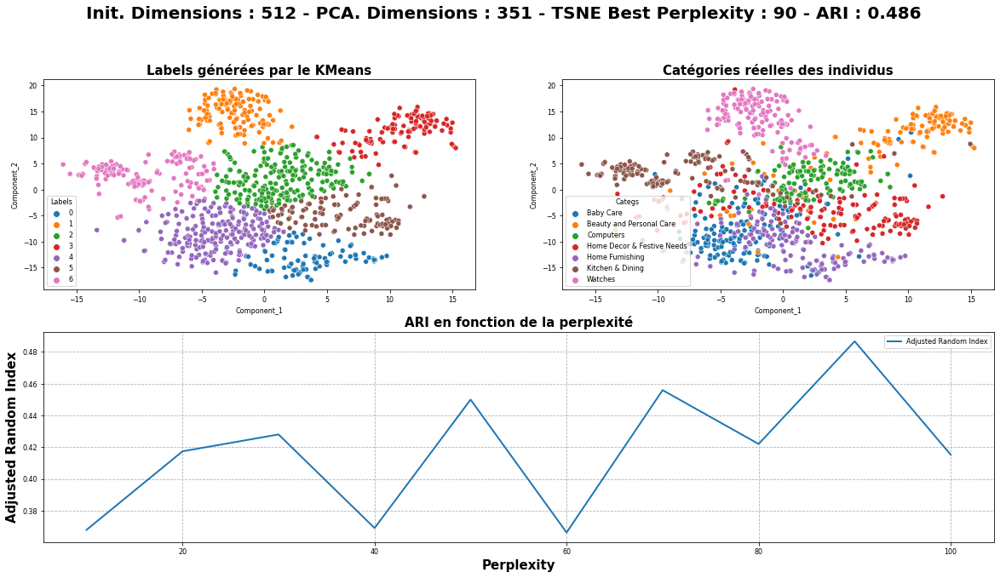

In [141]:
#Recherche de la meilleure perplexité

ari_vgg16, perp_vg16 = PCA_TSNE_ARI_tuner_KM(vgg16_bottom_outputs, 0.99, 10, 100, 10, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 512
PCA -- Nombre de composantes principales : 351
---------
TSNE - perplexité : 90
---------
KM - Nombre de clusters : 7


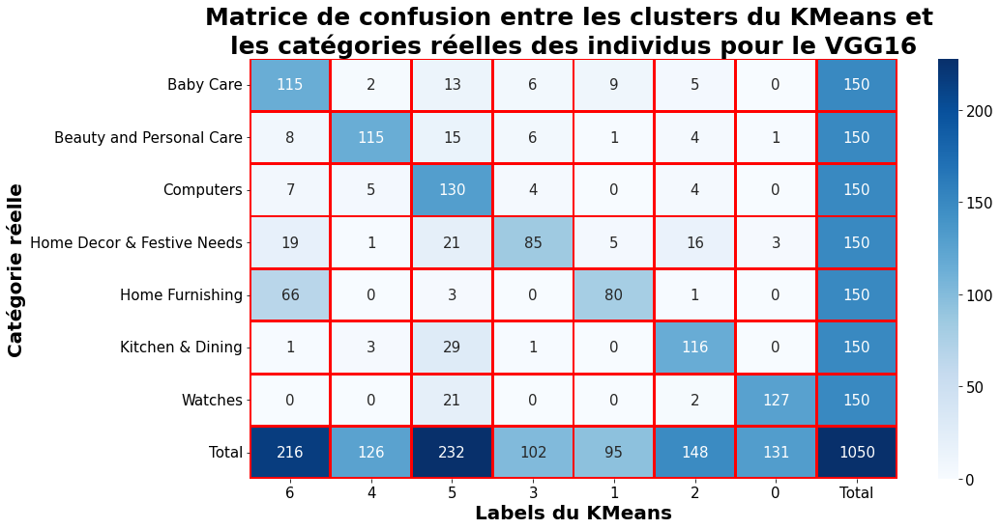

In [142]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_vgg16 = confusion_matrice_maker(vgg16_bottom_outputs, perp_vg16, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_vgg16, 'VGG16')

  Nous avons utilisé un premier modèle avec une architecture assez simple, et de nombreux paramètres.

  MobileNet est un modèle utilisant des couches de batch-normalisation, depthwise convolution, et un dropout (non gardé pour le feature extraction, nous nous arrêtons au GlobalAveragePooling - size 1024 en sortie).

  Ce modèle contient beaucoup moins de paramètres pour un Input size égal, et est adapté à des applications mobiles.

  Voyons quelles performances nous atteignons avec ce modèle.

In [143]:
#Importation de mobilenet

from keras.applications import mobilenet
from keras.applications.mobilenet import MobileNet

In [144]:
#Fonction de preprocessing de mobilenet

def mobilenet_preprocess(n):
    image = load_img(path + final_df['image'][n], target_size = (224,224))
    array = img_to_array(image)
    reshaped = array.reshape((1, array.shape[0], array.shape[1], array.shape[2]))
    preprocessed = mobilenet.preprocess_input(reshaped)
    return preprocessed

In [145]:
#Application du preprocessing de mobilenet

final_df['index'] = final_df.index
final_df['mobilenet_input'] = final_df['index'].swifter.apply(lambda x : mobilenet_preprocess(x))

Dask Apply:   0%|          | 0/16 [00:00<?, ?it/s]

In [146]:
#Affichage de l'architecture complète 

mobilenet = MobileNet(weights = 'imagenet', include_top = True, input_shape = (224,224,3))
mobilenet.summary()

17225924/17225924 [==============================] - 1s 0us/step
Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32

In [147]:
#Importation de Mobilenet sans les couches fully-connected, avec average-pooling en output

mobilenet_bottom = MobileNet(weights = 'imagenet', include_top = False, input_shape = (224,224,3), pooling = 'avg')

17225924/17225924 [==============================] - 1s 0us/step


In [148]:
#Inférence sur les individus

mobilenet_bottom_outputs = []
for i in final_df['mobilenet_input'].values:
    mobilenet_bottom_outputs.append(mobilenet_bottom(i))

In [149]:
#Cration du DataFrame des features extraits

mobilenet_bottom_outputs = pd.DataFrame(np.array(mobilenet_bottom_outputs).reshape(1050,1024))
mobilenet_bottom_outputs.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
929,0.809243,0.000000,0.000000,0.867243,0.441165,0.425196,1.102137,1.380834,0.130512,0.800283,...,0.285570,2.814231,0.098006,0.552209,0.192085,0.005277,0.099404,1.471362,0.729270,0.007343
633,0.335754,0.439985,0.219813,0.034737,0.000000,0.251663,0.000000,0.519701,0.000000,0.000000,...,0.032368,0.090066,0.000000,0.121978,0.557860,0.000000,0.288935,0.224227,0.036304,0.000000
361,0.208899,2.167609,0.776240,0.000000,1.860280,0.431019,0.207845,0.230624,0.032667,0.188424,...,0.011464,0.000000,0.000000,0.230871,0.156221,2.579982,0.000000,0.028325,2.125088,0.241497


PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 654
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.432
Perplexité : 20 - ARI : 0.520
Perplexité : 30 - ARI : 0.477
Perplexité : 40 - ARI : 0.492
Perplexité : 50 - ARI : 0.543
Perplexité : 60 - ARI : 0.526
Perplexité : 70 - ARI : 0.545
Perplexité : 80 - ARI : 0.539
Perplexité : 90 - ARI : 0.558
Perplexité : 100 - ARI : 0.515
Perplexité : 110 - ARI : 0.521
Perplexité : 120 - ARI : 0.549
Perplexité : 130 - ARI : 0.539
Perplexité : 140 - ARI : 0.473
Perplexité : 150 - ARI : 0.527
Meilleur perplexité : 90
Adjusted Random Index : 0.557


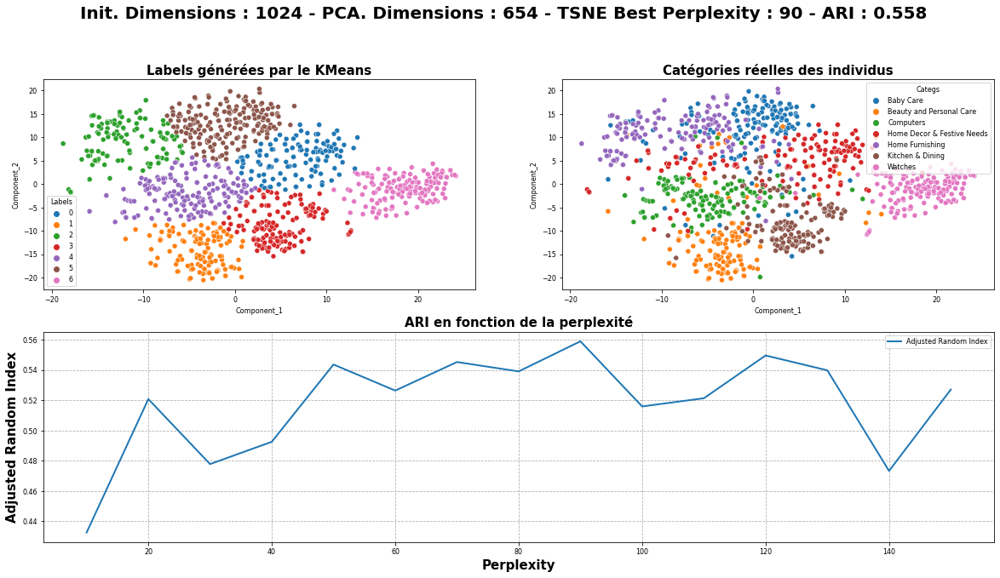

In [151]:
#Recherche de la meilleur perplexité

ari_mobilenet, perp_mobilenet = PCA_TSNE_ARI_tuner_KM(mobilenet_bottom_outputs, 0.99, 10, 150, 15, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 1024
PCA -- Nombre de composantes principales : 654
---------
TSNE - perplexité : 90
---------
KM - Nombre de clusters : 7


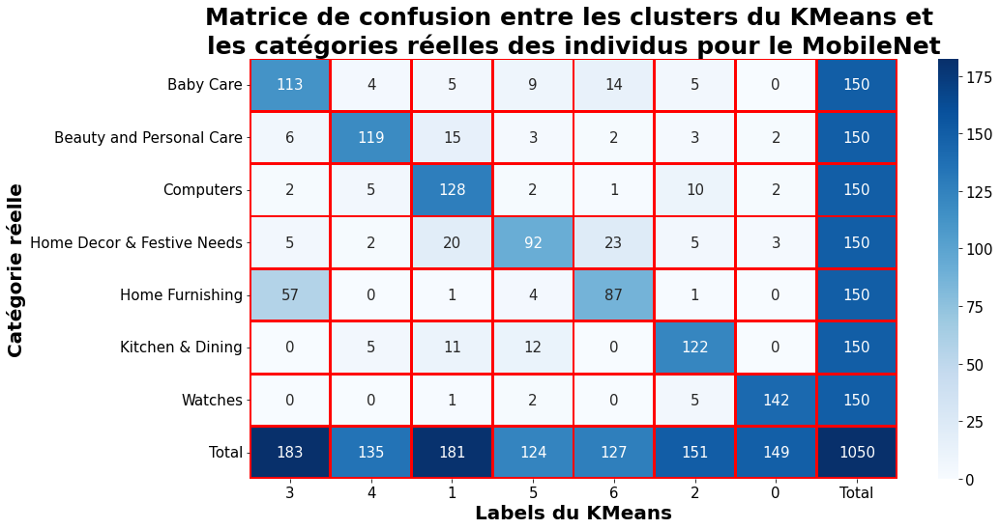

In [152]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_mobilenet = confusion_matrice_maker(mobilenet_bottom_outputs, perp_mobilenet, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_mobilenet, 'MobileNet')

  Avec un ARI de 0.56, nous avons de très bonnes performances avec MobileNet en comparaison des autres approches utilisées jusqu'à présent.

  Nous pouvons utiliser une nouvelle famille de modèle, contenant plus de paramètres, et réputée plus performante.

In [113]:
#Importation de resnet50

from keras.applications import resnet
from keras.applications.resnet import ResNet50

In [114]:
#Fonction de preprocessing de resnet

final_df['index'] = final_df.index

def resnet50_preprocess(n):
    image = load_img(path + final_df['image'][n], target_size = (224,224))
    array = img_to_array(image)
    reshaped = array.reshape((1, array.shape[0], array.shape[1], array.shape[2]))
    preprocessed = resnet.preprocess_input(reshaped)
    return preprocessed
  
final_df['resnet50_input'] = final_df['index'].swifter.apply(lambda x : resnet50_preprocess(x))

Dask Apply:   0%|          | 0/16 [00:00<?, ?it/s]

In [115]:
#Importation de resnet50 sans les couches fully-connected

resnet50_bottom_avg = ResNet50(weights = 'imagenet', include_top = False, input_shape = (224,224,3), pooling = 'avg')
resnet50_bottom_avg.summary()

94765736/94765736 [==============================] - 5s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                          

In [116]:
#Extraction des features avec resnet50

resnet50_bottom_outputs = []
for i in final_df['resnet50_input'].values:
    resnet50_bottom_outputs.append(resnet50_bottom_avg(i))

resnet50_bottom_outputs = pd.DataFrame(np.array(resnet50_bottom_outputs).reshape(1050,2048))
resnet50_bottom_outputs.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
241,0.012601,0.049498,0.571281,0.000000,0.566208,0.532059,0.041433,0.274847,0.043040,0.000000,...,0.115985,0.000000,0.000000,0.003023,0.020083,0.000000,0.008024,0.000000,0.003545,0.000000
97,0.060433,3.385838,0.094716,1.798077,0.528409,0.043345,0.661186,0.010217,0.394578,0.163805,...,1.282021,0.093314,0.023703,1.151876,0.287700,0.045769,0.204547,0.257552,0.011470,2.684305
410,1.196794,0.948104,0.644463,0.396165,0.037332,0.397070,1.628660,0.221217,0.068535,0.330000,...,0.014070,0.000000,0.471799,0.000000,0.424790,1.423779,0.572555,0.000000,0.173314,0.409150


PCA -- Nombre de dimensions initiales : 2048
PCA -- Nombre de composantes principales : 722
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.523
Perplexité : 20 - ARI : 0.522
Perplexité : 30 - ARI : 0.544
Perplexité : 40 - ARI : 0.559
Perplexité : 50 - ARI : 0.531
Perplexité : 60 - ARI : 0.505
Perplexité : 70 - ARI : 0.552
Perplexité : 80 - ARI : 0.474
Perplexité : 90 - ARI : 0.541
Perplexité : 100 - ARI : 0.556
Perplexité : 110 - ARI : 0.551
Perplexité : 120 - ARI : 0.522
Perplexité : 130 - ARI : 0.576
Perplexité : 140 - ARI : 0.516
Perplexité : 150 - ARI : 0.479
Meilleur perplexité : 130
Adjusted Random Index : 0.576


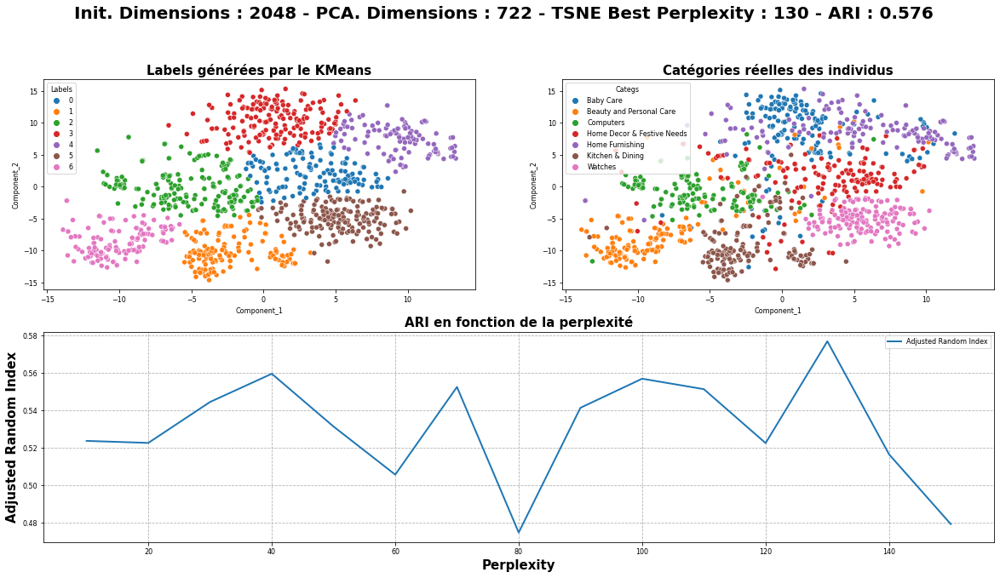

In [117]:
#Recherche de la meilleure perplexité 

resnet50_ari, resnet50_perp = PCA_TSNE_ARI_tuner_KM(resnet50_bottom_outputs, 0.99, 10, 150, 15, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 2048
PCA -- Nombre de composantes principales : 722
---------
TSNE - perplexité : 130
---------
KM - Nombre de clusters : 7


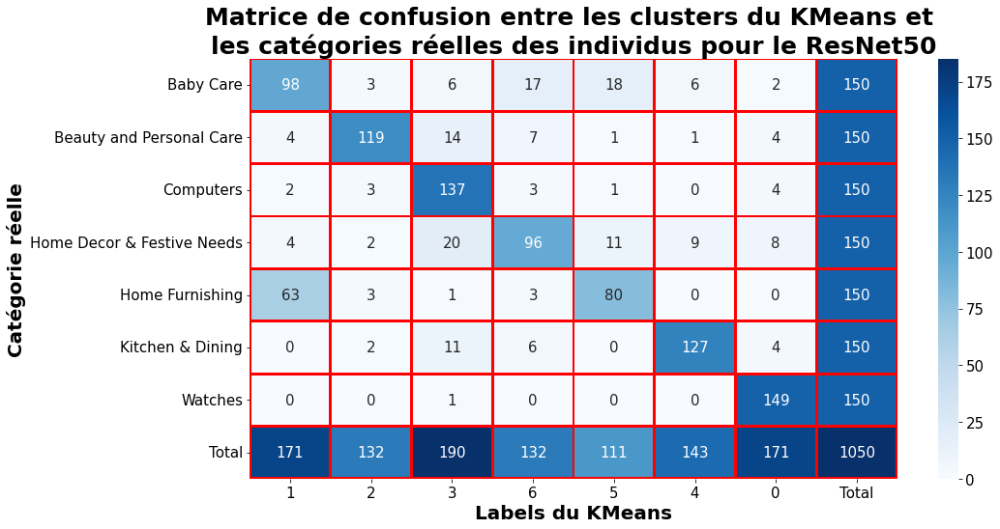

In [118]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_resnet50 = confusion_matrice_maker(resnet50_bottom_outputs, resnet50_perp, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_resnet50, 'ResNet50')

In [119]:
#Importation de Resnet101

from keras.applications.resnet import ResNet101

In [120]:
#Création du features extractor

resnet101_bottom_avg = ResNet101(weights = 'imagenet', include_top = False, input_shape = (224,224,3), pooling = 'avg')
resnet101_bottom_avg.summary()

171446536/171446536 [==============================] - 6s 0us/step
Model: "resnet101"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                       

In [121]:
#Extraction des features

resnet101_bottom_outputs = []
for i in final_df['resnet50_input'].values:
    resnet101_bottom_outputs.append(resnet101_bottom_avg(i))
resnet101_bottom_outputs = pd.DataFrame(np.array(resnet101_bottom_outputs).reshape(1050,2048))
resnet101_bottom_outputs.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
56,3.645862,0.000000,0.000000,0.26873,0.000000,0.057755,0.931394,0.141114,2.817516,0.000000,...,0.745864,0.187520,0.250143,0.269031,0.030073,0.000000,0.300542,0.000000,0.430289,0.000000
298,1.648638,0.305146,1.566568,0.00000,0.102373,0.000000,2.073238,0.104554,0.207960,0.274912,...,0.000000,0.061049,0.464262,0.009063,0.019662,0.278882,0.000000,0.699533,0.000000,0.204927
336,1.717379,0.000000,0.133078,0.00000,0.035839,0.360832,1.682112,0.000000,0.657875,0.000000,...,0.000000,1.544137,0.246547,0.581790,0.000000,0.000000,0.013433,0.000000,0.000000,0.031820


PCA -- Nombre de dimensions initiales : 2048
PCA -- Nombre de composantes principales : 726
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.470
Perplexité : 20 - ARI : 0.478
Perplexité : 30 - ARI : 0.459
Perplexité : 40 - ARI : 0.511
Perplexité : 50 - ARI : 0.489
Perplexité : 60 - ARI : 0.473
Perplexité : 70 - ARI : 0.481
Perplexité : 80 - ARI : 0.444
Perplexité : 90 - ARI : 0.541
Perplexité : 100 - ARI : 0.438
Perplexité : 110 - ARI : 0.461
Perplexité : 120 - ARI : 0.501
Perplexité : 130 - ARI : 0.452
Perplexité : 140 - ARI : 0.422
Perplexité : 150 - ARI : 0.511
Meilleur perplexité : 90
Adjusted Random Index : 0.541


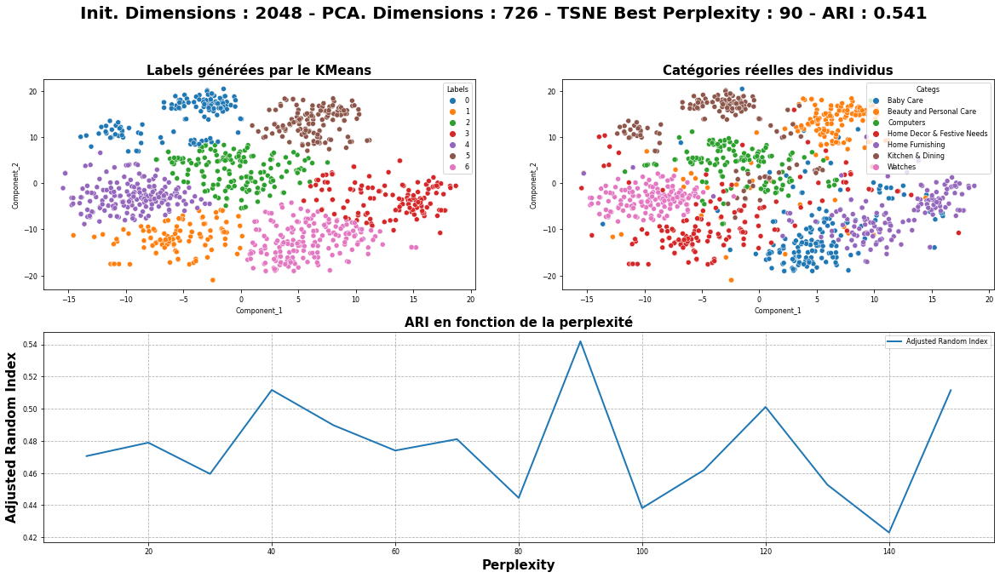

In [122]:
#Recherche de la meilleure perplexité

resnet101_ari, resnet101_perp = PCA_TSNE_ARI_tuner_KM(resnet101_bottom_outputs, 0.99, 10, 150, 15, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 2048
PCA -- Nombre de composantes principales : 726
---------
TSNE - perplexité : 90
---------
KM - Nombre de clusters : 7


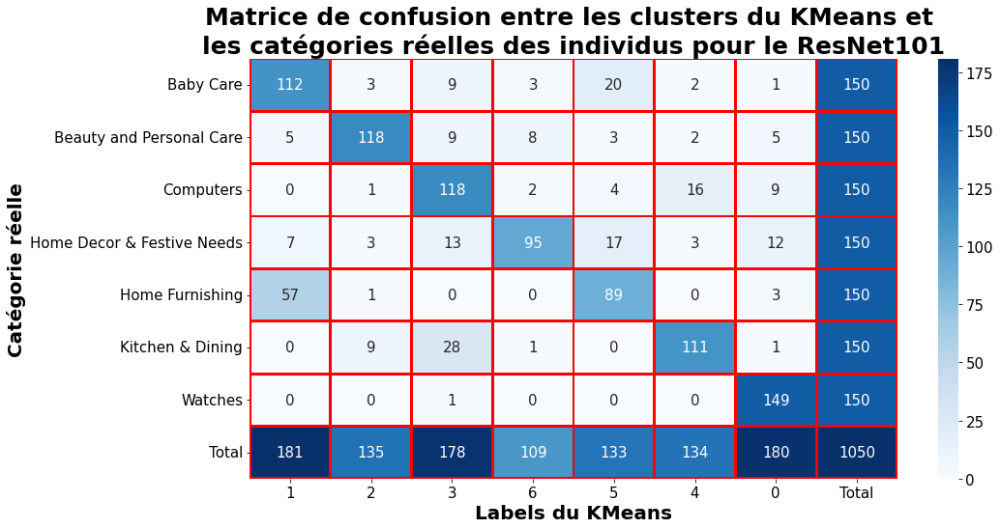

In [123]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_resnet101 = confusion_matrice_maker(resnet101_bottom_outputs, resnet101_perp, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_resnet101, 'ResNet101')

In [124]:
#Importation de ResNet152

from keras.applications.resnet import ResNet152

In [125]:
#Création du features-extrator

resnet152_bottom_avg = ResNet152(weights = 'imagenet', include_top = False, input_shape = (224,224,3), pooling = 'avg')
resnet152_bottom_avg.summary()

234698864/234698864 [==============================] - 11s 0us/step
Model: "resnet152"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                      

In [126]:
#Extraction des features

resnet152_bottom_outputs = []
for i in final_df['resnet50_input'].values:
    resnet152_bottom_outputs.append(resnet152_bottom_avg(i))

resnet152_bottom_outputs = pd.DataFrame(np.array(resnet152_bottom_outputs).reshape(1050,2048))
resnet152_bottom_outputs.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
516,0.000000,0.064261,0.338374,0.059112,2.292871,4.112843,0.101480,0.201443,0.000000,0.028047,...,0.638277,0.035715,0.916831,2.214060,0.052834,0.860127,0.073614,0.018863,0.000000,0.911214
621,0.239207,0.488515,0.621070,0.000000,0.005720,1.748906,0.088433,0.102376,0.696488,0.285868,...,0.346221,0.172215,0.033113,0.000000,0.005597,0.694071,0.469101,1.308876,0.000000,0.160323
109,0.377387,0.062339,1.570816,0.000000,0.704502,0.288141,0.079305,0.247525,0.167335,0.308049,...,0.711713,0.000000,0.023472,0.448504,0.387901,1.089284,2.298935,0.036088,0.128607,0.002806


PCA -- Nombre de dimensions initiales : 2048
PCA -- Nombre de composantes principales : 726
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.501
Perplexité : 20 - ARI : 0.473
Perplexité : 30 - ARI : 0.554
Perplexité : 40 - ARI : 0.546
Perplexité : 50 - ARI : 0.487
Perplexité : 60 - ARI : 0.543
Perplexité : 70 - ARI : 0.505
Perplexité : 80 - ARI : 0.531
Perplexité : 90 - ARI : 0.550
Perplexité : 100 - ARI : 0.537
Perplexité : 110 - ARI : 0.437
Perplexité : 120 - ARI : 0.524
Perplexité : 130 - ARI : 0.520
Perplexité : 140 - ARI : 0.506
Perplexité : 150 - ARI : 0.518
Meilleur perplexité : 30
Adjusted Random Index : 0.554


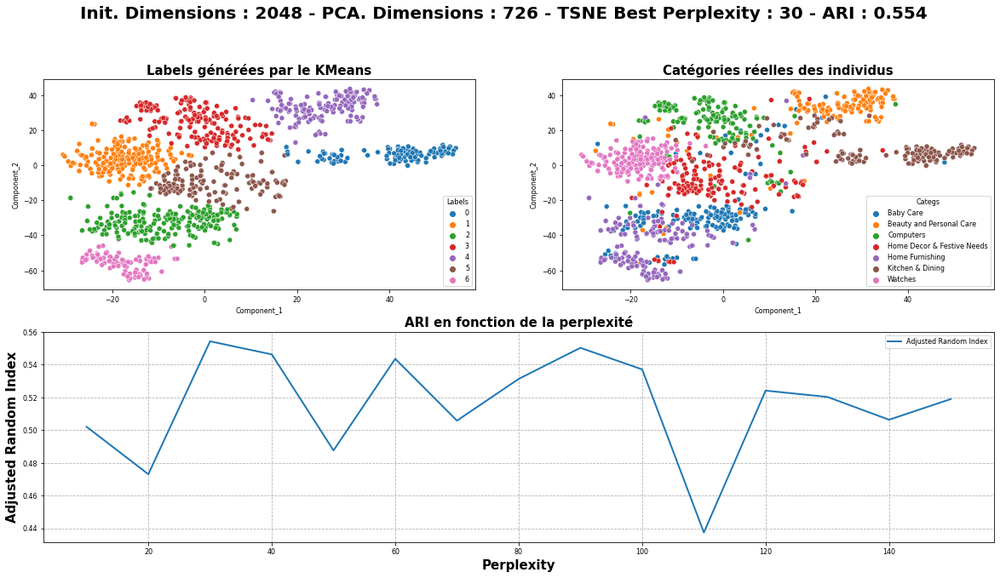

In [127]:
#Recherche de la meilleure perplexité

resnet152ari, resnet152_perp = PCA_TSNE_ARI_tuner_KM(resnet152_bottom_outputs, 0.99, 10, 150, 15, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 2048
PCA -- Nombre de composantes principales : 726
---------
TSNE - perplexité : 30
---------
KM - Nombre de clusters : 7


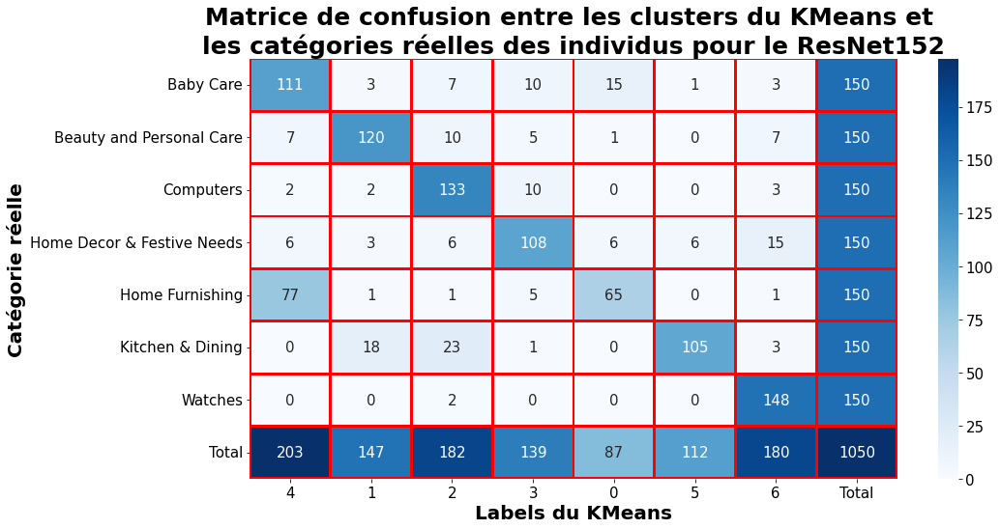

In [128]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_resnet152 = confusion_matrice_maker(resnet152_bottom_outputs, resnet152_perp, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_resnet152, 'ResNet152')

## 6.4- Features extraction en conservant les couches fully-connected

In [132]:
#Importation de VGG16 complet avec les poids imagenet

Full_vgg16 = VGG16(weights = 'imagenet', input_shape = (224,224,3), include_top = True)
Full_vgg16.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [133]:
#Création du nouveau modèle en ne conservant pas la couche Output (avec activation Softmax)

FC_vgg16 = Sequential()
for i in Full_vgg16.layers[:-1]:
    FC_vgg16.add(i)
FC_vgg16.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 56, 56, 256)       2

In [134]:
#Céation du Features extractor

FC_vgg16_outputs = []
for i in final_df['vgg16_input'].values:
    FC_vgg16_outputs.append(FC_vgg16(i))

FC_vgg16_outputs = pd.DataFrame(np.array(FC_vgg16_outputs).reshape(1050,4096))
FC_vgg16_outputs.sample(3)

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
449,0.000000,0.0,0.000000,5.434871,0.000000,0.0,0.000000,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
769,0.000000,0.0,0.000000,5.507910,0.000000,0.0,6.066133,0.000000,0.0,6.725353,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
94,2.514943,0.0,3.768111,4.856563,2.218777,0.0,0.866998,3.340762,0.0,1.214517,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.294494,0.0,7.918443


PCA -- Nombre de dimensions initiales : 4096
PCA -- Nombre de composantes principales : 803
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.473
Perplexité : 20 - ARI : 0.460
Perplexité : 30 - ARI : 0.449
Perplexité : 40 - ARI : 0.448
Perplexité : 50 - ARI : 0.459
Perplexité : 60 - ARI : 0.534
Perplexité : 70 - ARI : 0.458
Perplexité : 80 - ARI : 0.505
Perplexité : 90 - ARI : 0.493
Perplexité : 100 - ARI : 0.456
Perplexité : 110 - ARI : 0.487
Perplexité : 120 - ARI : 0.434
Perplexité : 130 - ARI : 0.486
Perplexité : 140 - ARI : 0.464
Perplexité : 150 - ARI : 0.473
Meilleur perplexité : 60
Adjusted Random Index : 0.542


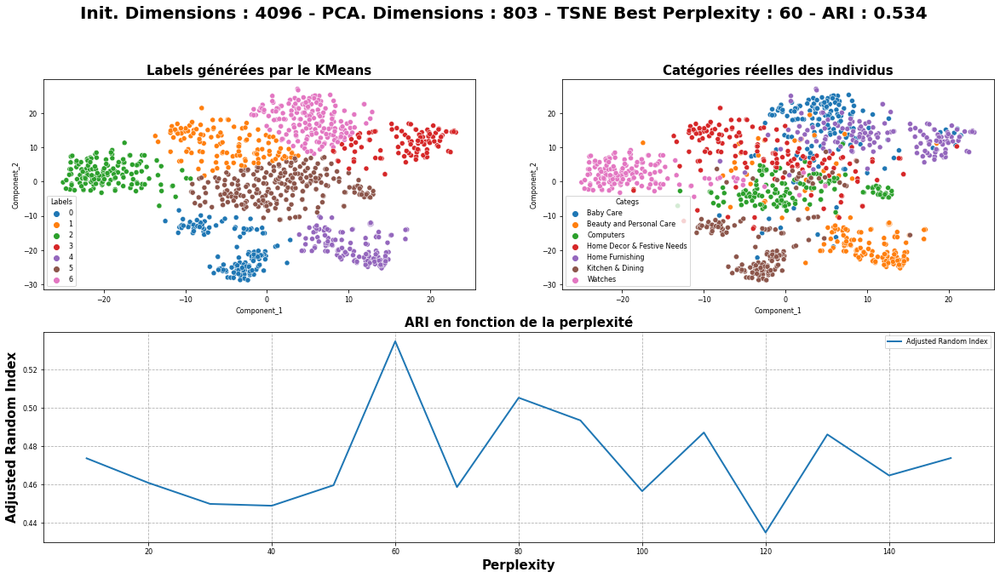

In [136]:
#Recherche de la meilleur perplexité

fc_vgg16_ari, fc_vgg16_perp = PCA_TSNE_ARI_tuner_KM(FC_vgg16_outputs, 0.99, 10, 150, 15, 7, categories, False, False)

PCA -- Nombre de dimensions initiales : 4096
PCA -- Nombre de composantes principales : 803
---------
TSNE - perplexité : 60
---------
KM - Nombre de clusters : 7


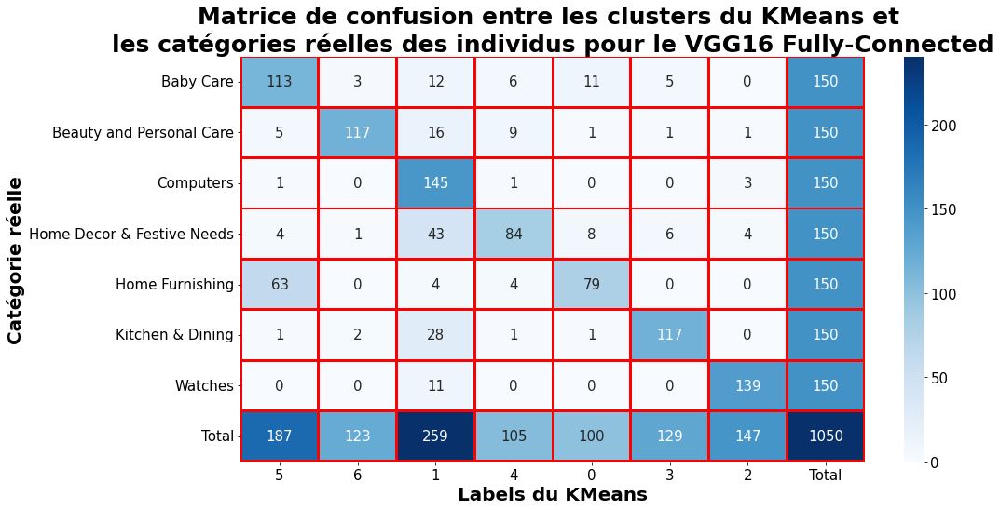

In [137]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_fc_vgg16 = confusion_matrice_maker(FC_vgg16_outputs, fc_vgg16_perp, 0.99, 7, categories)
confusion_matrix_displayer(confusion_matrix_fc_vgg16, 'VGG16 Fully-Connected')

## 6.5- Fine Tuning VGG16

Enfin, nous pouvons essayer de fine tuner VGG16 de manière à améliorer les résultats (entraînement sur 35% du jeu de données, et extraction des features sur le jeu de données de test). 

Contrairement à l'extraction de features sur les données textuelles, le fine-tuning n'améliore que légèrement les performances sur les données visuelles.

In [138]:
#Importation de VGG16 complet avec les poids imagenet

vgg16_full = VGG16(weights= 'imagenet', include_top = True, input_shape = (224,224,3))

In [147]:
#Préparation des jeux de données de test et de train

from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical

X_train, X_test, y_train, y_test = train_test_split(final_df['vgg16_input'].values, categories, stratify = categories, random_state = 11, test_size = 0.65)

lab = LabelEncoder()
lab.fit(y_train)

y_train_lab = lab.transform(y_train)
y_test_lab = lab.transform(y_test)

y_train_cat = to_categorical(y_train_lab)
y_test_cat = to_categorical(y_test_lab)

In [148]:
#Création du nouveau modèle en ne conservant pas la couche Output (avec activation Softmax)

FC_vgg16_ft = Sequential()
FC_vgg16_ft.add(Input(shape= (224,224,3)))
for i in vgg16_full.layers[:-1]:
    FC_vgg16_ft.add(i)
FC_vgg16_ft.add(Dense(7, activation = 'Softmax'))

#On place tous les layers en trainable pour un fine tuning total

for i in FC_vgg16_ft.layers:
    i.trainable = True

FC_vgg16_ft.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        multiple                  0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)      

In [149]:
#Préparation des jeux de données

X_train_0 = []
X_test_0 = []

for i in X_train:
    X_train_0.append(i[0])

for i in X_test:
    X_test_0.append(i[0])

X_train_0 = np.array(X_train_0)
X_test_0 = np.array(X_test_0)

In [150]:
# Compiler le modèle 
FC_vgg16_ft.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True), 
                         optimizer=optimizers.Adam(learning_rate=0.000001), metrics=['categorical_accuracy'])

# Entraîner sur les données d'entraînement (X_train, y_train)
history_FC_vgg16_ft = FC_vgg16_ft.fit(X_train_0, y_train_cat, epochs=12, batch_size=50, verbose=1, validation_split = 0.1)

Epoch 1/12
7/7 [==============================] - 26s 2s/step - loss: 2.8920 - categorical_accuracy: 0.2424 - val_loss: 2.5176 - val_categorical_accuracy: 0.2432
Epoch 2/12
7/7 [==============================] - 5s 690ms/step - loss: 1.9502 - categorical_accuracy: 0.3758 - val_loss: 2.0343 - val_categorical_accuracy: 0.3243
Epoch 3/12
7/7 [==============================] - 5s 687ms/step - loss: 1.3608 - categorical_accuracy: 0.5394 - val_loss: 1.7247 - val_categorical_accuracy: 0.4054
Epoch 4/12
7/7 [==============================] - 5s 693ms/step - loss: 0.9809 - categorical_accuracy: 0.6727 - val_loss: 1.5224 - val_categorical_accuracy: 0.4324
Epoch 5/12
7/7 [==============================] - 5s 689ms/step - loss: 0.7210 - categorical_accuracy: 0.7788 - val_loss: 1.3787 - val_categorical_accuracy: 0.4595
Epoch 6/12
7/7 [==============================] - 5s 675ms/step - loss: 0.5511 - categorical_accuracy: 0.8364 - val_loss: 1.2765 - val_categorical_accuracy: 0.5676
Epoch 7/12
7/7 [==

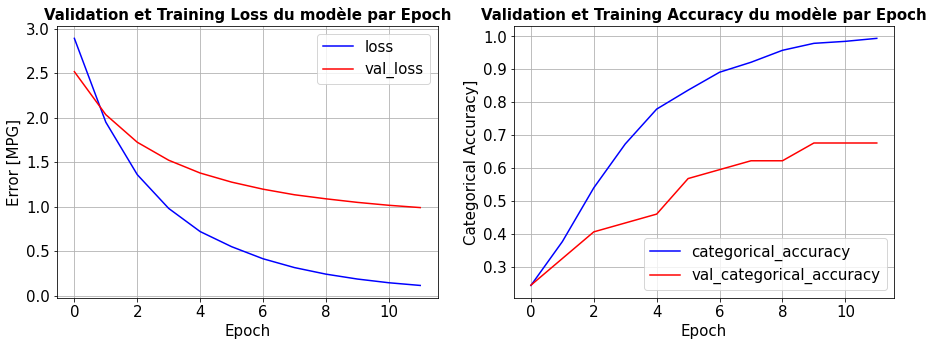

In [151]:
#Courbes d'apprentissage - loss et accuracy 

plot_loss(history_FC_vgg16_ft)

In [152]:
#Création du feature extractor

FC_vgg16_extractor = Sequential()
FC_vgg16_extractor.add(Input(shape = (224,224,3)))
for i in FC_vgg16_ft.layers[:-1]:
    FC_vgg16_extractor.add(i)

FC_vgg16_extractor.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        multiple                  0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)      

In [155]:
#Extraction des features

fine_tuned_vgg16 = []
for i in X_test_0:
    fine_tuned_vgg16.append(FC_vgg16_extractor(np.array([i])))

fine_tuned_vgg16 = pd.DataFrame(np.array(fine_tuned_vgg16).reshape(len(X_test_0), 4096))

PCA -- Nombre de dimensions initiales : 4096
PCA -- Nombre de composantes principales : 533
----------

TSNE -- Essais de 15 valeurs de perplexité
TSNE -- Perplexité minimale : 10
TSNE -- Perplexité maximale : 150
----------

Perplexité : 10 - ARI : 0.436
Perplexité : 20 - ARI : 0.495
Perplexité : 30 - ARI : 0.482
Perplexité : 40 - ARI : 0.575
Perplexité : 50 - ARI : 0.541
Perplexité : 60 - ARI : 0.478
Perplexité : 70 - ARI : 0.549
Perplexité : 80 - ARI : 0.577
Perplexité : 90 - ARI : 0.460
Perplexité : 100 - ARI : 0.526
Perplexité : 110 - ARI : 0.556
Perplexité : 120 - ARI : 0.557
Perplexité : 130 - ARI : 0.475
Perplexité : 140 - ARI : 0.583
Perplexité : 150 - ARI : 0.475
Meilleur perplexité : 140
Adjusted Random Index : 0.583


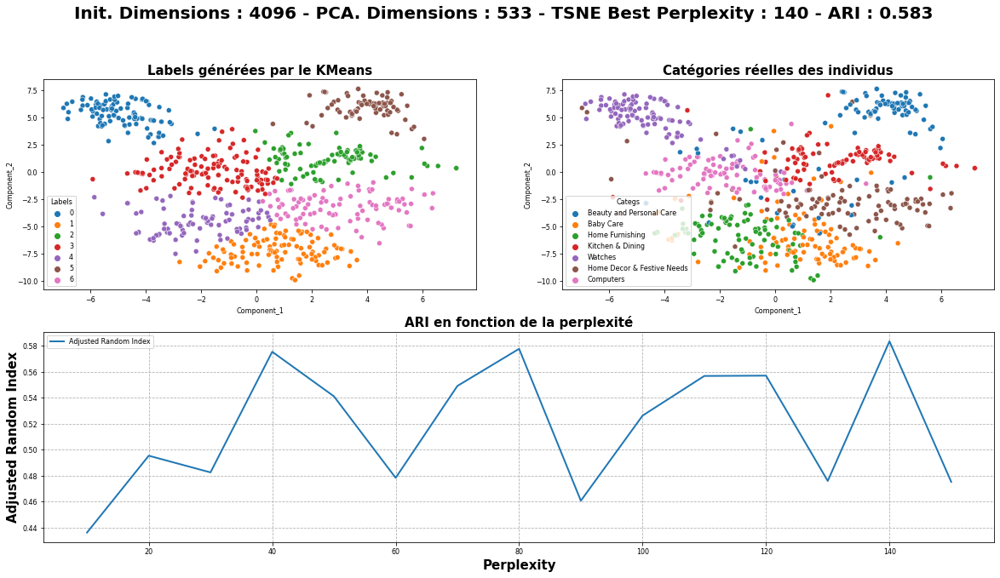

In [156]:
#Recherche de la meilleur perplexité

ft_vgg16_ari, ft_vgg16_perp = PCA_TSNE_ARI_tuner_KM(fine_tuned_vgg16, 0.99, 10, 150, 15, 7, y_test, False, False)

PCA -- Nombre de dimensions initiales : 4096
PCA -- Nombre de composantes principales : 533
---------
TSNE - perplexité : 140
---------
KM - Nombre de clusters : 7


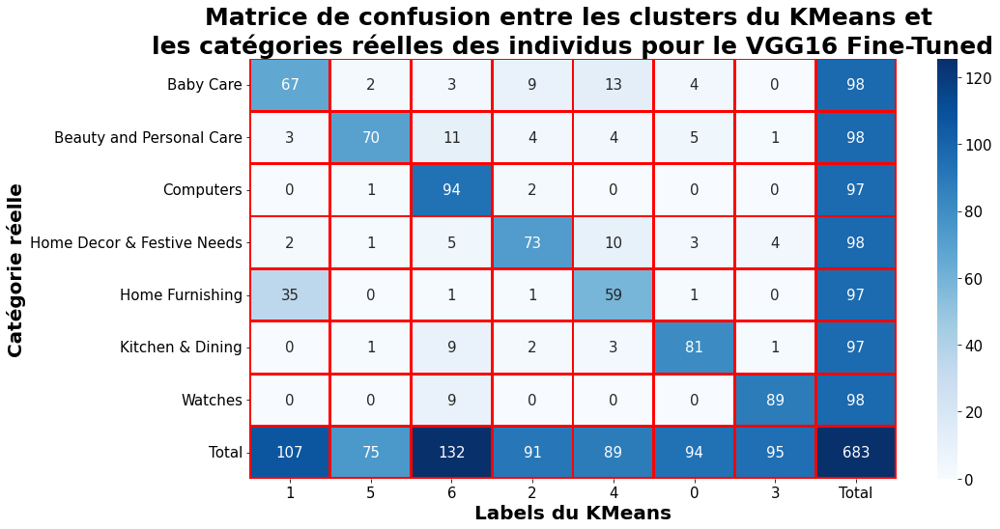

In [157]:
#Affichage de la matrice de confusion entre les labels KMeans et les catégories réelles

confusion_matrix_vgg16_ft = confusion_matrice_maker(fine_tuned_vgg16, ft_vgg16_perp, 0.99, 7, y_test)
confusion_matrix_displayer(confusion_matrix_vgg16_ft, 'VGG16 Fine-Tuned')

# 7- Conclusions

In [159]:
#Liste des approches et ARI 

Method = ['CountVectorizer', 'TF-IDF', 'Word2Vec', 'Bert-Base-Uncased', 'Bergum-Bert', 'USE', 'SIFT', 'VGG16_no_FC', 'MobileNet', 'ResNet50', 'VGG16_FC']
ARI = [0.49, 0.61, 0.43, 0.32, 0.27, 0.44, 0.009, 0.49, 0.56, 0.58, 0.52]
Data_Type = ['Text', 'Text', 'Text', 'Text', 'Text', 'Text', 'Visual', 'Visual', 'Visual', 'Visual', 'Visual']

Final_Results = pd.DataFrame({'Method' : Method, 'ARI' : ARI, 'Type' : Data_Type})
Final_Results = Final_Results.sort_values(by = 'ARI', ascending = False)
Final_Results.head()

,Method,ARI,Type
1,TF-IDF,0.61,Text
9,ResNet50,0.58,Visual
8,MobileNet,0.56,Visual
10,VGG16_FC,0.52,Visual
0,CountVectorizer,0.49,Text


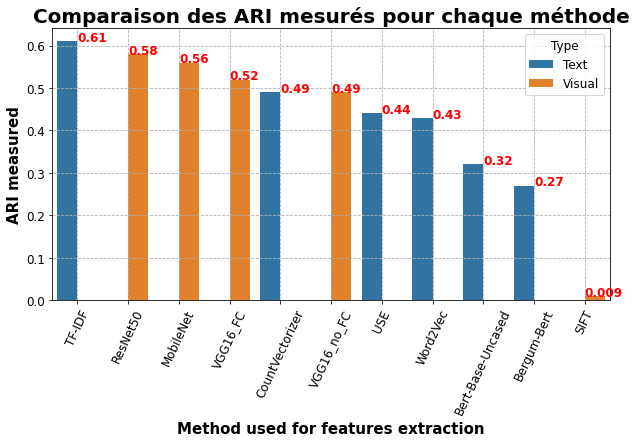

In [184]:
#Affichage des résultats

plt.figure(figsize = (10,5))
plt.rcParams.update({'font.size' : 12})
sns.barplot(data = Final_Results, x = 'Method', y = 'ARI', hue = 'Type')
plt.grid(True, ls = '--')
plt.xticks(rotation = 65)
plt.xlabel('Method used for features extraction', weight = 'bold', size = 15)
plt.ylabel('ARI measured', weight = 'bold', size = 15)
plt.title('Comparaison des ARI mesurés pour chaque méthode', weight = 'bold', size = 20)
for i in range(len(ARI)):
    plt.text(i, Final_Results['ARI'].values[i],'{}'.format(Final_Results['ARI'].values[i]), weight = 'bold', color = 'red', size = 12)

Somme tout, nous avons utilisé plusieurs approches pour extraire les features des données à notre disposition. 

La réduction dimensionnelle et le clustering effectué sur les individus ont fourni des résultats très différents en fonction de la méthode utilisée.

De manière générale, il semble plus efficace de procéder à une extraction de features sur les images en utilisant un CNN pré-entraîné sur le jeu de données imagenet, à l'exception de l'approche TF-IDF qui offre les meilleures performances. Notons que l'approche SIFT fourni des résultats particulièrement mauvais.

Néanmoins, pour aller plus loin, nous avons pu montrer qu'éffectuer un Fine-Tuning total avec un transformer de type BERT permettait d'améliorer les performances de l'extraction de features sur le jeu de données de test de manière drastique.

Nous pouvons conclure qu'il est tout à fait envisageable de mettre en place un classifieur pour classifier les produits en fonction de leur description et/ou de leur photo, avec des résultats néanmoins plus ou moins bons en fonction de la classe réelle des individus (cf. Matrice de confusion).